# Utilities

### Progress indicator

In [9]:
# Print iterations progress
def printProgressBar (iteration, total, prefix = '', suffix = '', decimals = 1, length = 100, fill = '█'):
    """
    Call in a loop to create terminal progress bar
    @params:
        iteration   - Required  : current iteration (Int)
        total       - Required  : total iterations (Int)
        prefix      - Optional  : prefix string (Str)
        suffix      - Optional  : suffix string (Str)
        decimals    - Optional  : positive number of decimals in percent complete (Int)
        length      - Optional  : character length of bar (Int)
        fill        - Optional  : bar fill character (Str)
    """
    percent = ("{0:." + str(decimals) + "f}").format(100 * (iteration / float(total)))
    filledLength = int(length * iteration // total)
    bar = fill * filledLength + '-' * (length - filledLength)
    print('\r%s |%s| %s%% %s' % (prefix, bar, percent, suffix), end = '\r')
    # Print New Line on Complete
    if iteration == total: 
        print()

# 
# Sample Usage
# 

from time import sleep

# A List of Items
items = list(range(0, 1))
l = len(items)

# Initial call to print 0% progress
printProgressBar(0, l, prefix = 'Progress:', suffix = 'Complete', length = 50)
for i, item in enumerate(items):
    # Do stuff...
    sleep(0.1)
    # Update Progress Bar
    printProgressBar(i + 1, l, prefix = 'Progress:', suffix = 'Complete', length = 50)

Progress: |██████████████████████████████████████████████████| 100.0% Complete


### Data download

In [ ]:
from tensorflow.python.client import device_lib

def get_available_gpus():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos if x.device_type == 'GPU']

get_available_gpus()

In [1]:
import os
current_dir = os.getcwd()
current_dir

'/home/av/cars'

In [4]:
!kg download -u aveysov@gmail.com -p ubuntu41 -c carvana-image-masking-challenge

Starting new HTTPS connection (1): www.kaggle.com
downloading https://www.kaggle.com/c/carvana-image-masking-challenge/download/metadata.csv.zip

Starting new HTTPS connection (1): storage.googleapis.com
metadata.csv.zip 100% |#############################| Time: 0:00:00  86.7 KiB/s
downloading https://www.kaggle.com/c/carvana-image-masking-challenge/download/train_masks.zip

train_masks.zip 100% |##############################| Time: 0:00:03   7.7 MiB/s
downloading https://www.kaggle.com/c/carvana-image-masking-challenge/download/train_masks.csv.zip

train_masks.csv.zip 100% |##########################| Time: 0:00:02   7.1 MiB/s
downloading https://www.kaggle.com/c/carvana-image-masking-challenge/download/sample_submission.csv.zip

sample_submission.csv.zip 100% |####################| Time: 0:00:00 293.8 KiB/s
downloading https://www.kaggle.com/c/carvana-image-masking-challenge/download/train.zip

train.zip 100% |####################################| Time: 0:00:39  10.3 MiB/s
download

In [5]:
%mv *.zip Kaggle-Carvana-Image-Masking-Challenge/input

In [1]:
%ls Kaggle-Carvana-Image-Masking-Challenge/input

metadata.csv.zip           test_hq.zip   train_masks.csv.zip
README.md                  test.zip      train_masks.zip
sample_submission.csv.zip  train_hq.zip  train.zip


In [ ]:
!unzip Kaggle-Carvana-Image-Masking-Challenge/input/test_hq.zip -d data/
!unzip Kaggle-Carvana-Image-Masking-Challenge/input/train_hq.zip -d data/
!unzip Kaggle-Carvana-Image-Masking-Challenge/input/train_masks.zip -d data/
!unzip Kaggle-Carvana-Image-Masking-Challenge/input/train_masks.csv.zip -d data/
!unzip Kaggle-Carvana-Image-Masking-Challenge/input/metadata.csv.zip  -d data/
!unzip Kaggle-Carvana-Image-Masking-Challenge/input/sample_submission.csv.zip  -d data/

In [8]:
ls 29bb3ece3180_11.jpg

29bb3ece3180_11.jpg


In [6]:
!mv data/* Kaggle-Carvana-Image-Masking-Challenge/input/

In [7]:
ls Kaggle-Carvana-Image-Masking-Challenge/input/test_hq/29bb3ece3180_11.jpg

Kaggle-Carvana-Image-Masking-Challenge/input/test_hq/29bb3ece3180_11.jpg


In [13]:
ls Kaggle-Carvana-Image-Masking-Challenge/input/

metadata.csv               test_hq/      train_masks/
metadata.csv.zip           test_hq.zip   train_masks.csv
README.md                  test.zip      train_masks.csv.zip
sample_submission.csv      train_hq/     train_masks.zip
sample_submission.csv.zip  train_hq.zip  train.zip


In [14]:
!mv Kaggle-Carvana-Image-Masking-Challenge/input/test_hq Kaggle-Carvana-Image-Masking-Challenge/input/test
!mv Kaggle-Carvana-Image-Masking-Challenge/input/train_hq Kaggle-Carvana-Image-Masking-Challenge/input/train

In [ ]:
!ls Kaggle-Carvana-Image-Masking-Challenge/input/

In [6]:
!ls -la Kaggle-Carvana-Image-Masking-Challenge/input/test/*.png | wc -l

ls: cannot access 'Kaggle-Carvana-Image-Masking-Challenge/input/test/*.png': No such file or directory
0


# Data preprocessing

Basically just:
- use sklearn's k-fold method to produce several k-folds
- copy data into keras-suitable folders a 2-3 times for k-fold 
- transform into keras-compatible format 

### Prepare the folders

In [9]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.io import imsave
from skimage.transform import downscale_local_mean
from os.path import join
import cv2
from sklearn.model_selection import train_test_split
import os 
from glob import glob

In [ ]:
!ls data/train/fol

In [11]:
!ls -ls $TRAIN | wc -l
!ls -ls $TRAIN_MASKS | wc -l

5093
10181


In [10]:
load_img = lambda im, idx: imread(join(TRAIN, '{}_{:02d}.jpg'.format(im, idx)))
load_mask = lambda im, idx: imread(join(TRAIN_MASKS, '{}_{:02d}_mask.gif'.format(im, idx)))
mask_image = lambda im, mask: (im * np.expand_dims(mask, 2))

In [4]:
df_mask = pd.read_csv(join(DATA, 'train_masks.csv'), usecols=['img'])
car_ids = df_mask['img'].map(lambda s: s.split('_')[0]).unique()
imgs_idx = list(range(1, 17))

In [3]:
DATA = 'data/'

TRAIN = os.path.join(DATA, "train")
TRAIN_FOLD_1 = os.path.join(DATA, "train/fold_1")
TRAIN_FOLD_2 = os.path.join(DATA, "train/fold_2")
TRAIN_FOLD_3 = os.path.join(DATA, "train/fold_3")
TRAIN_FOLD_ADD = os.path.join(DATA, "train/add")

TRAIN_MASKS = os.path.join(DATA, "train_masks")
TRAIN_MASKS_FOLD_1 = os.path.join(DATA, "train_masks/fold_1")
TRAIN_MASKS_FOLD_2 = os.path.join(DATA, "train_masks/fold_2")
TRAIN_MASKS_FOLD_3 = os.path.join(DATA, "train_masks/fold_3")
TRAIN_MASKS_FOLD_ADD = os.path.join(DATA, "train_masks/add")

VALID = os.path.join(DATA, "valid")
VALID_FOLD_1 = os.path.join(DATA, "valid/fold_1")
VALID_FOLD_2 = os.path.join(DATA, "valid/fold_2")
VALID_FOLD_3 = os.path.join(DATA, "valid/fold_3")
VALID_FOLD_ADD = os.path.join(DATA, "valid/add")

VALID_MASKS = os.path.join(DATA, "valid_masks")
VALID_MASKS_FOLD_1 = os.path.join(DATA, "valid_masks/fold_1")
VALID_MASKS_FOLD_2 = os.path.join(DATA, "valid_masks/fold_2")
VALID_MASKS_FOLD_3 = os.path.join(DATA, "valid_masks/fold_3")
VALID_MASKS = os.path.join(DATA, "valid_masks/add")

TEST = os.path.join(DATA, "test")

folder_list = [TRAIN,
            TRAIN_FOLD_1,
            TRAIN_FOLD_2,
            TRAIN_FOLD_3,
            TRAIN_FOLD_ADD,
            TRAIN_MASKS,
            TRAIN_MASKS_FOLD_1,
            TRAIN_MASKS_FOLD_2,
            TRAIN_MASKS_FOLD_3,
            TRAIN_MASKS_FOLD_ADD,
            VALID,
            VALID_FOLD_1,
            VALID_FOLD_2,
            VALID_FOLD_3,
            VALID_FOLD_ADD,
            VALID_MASKS,
            VALID_MASKS_FOLD_1,
            VALID_MASKS_FOLD_2,
            VALID_MASKS_FOLD_3,
            VALID_MASKS]


In [ ]:
DATA = 'data/'

TRAIN = os.path.join(DATA, "train")
TRAIN_FOLD_1 = os.path.join(DATA, "train/fold_1")
TRAIN_FOLD_2 = os.path.join(DATA, "train/fold_2")
TRAIN_FOLD_3 = os.path.join(DATA, "train/fold_3")
TRAIN_FOLD_ADD = os.path.join(DATA, "train/add")

TRAIN_MASKS = os.path.join(DATA, "train_masks")
TRAIN_MASKS_FOLD_1 = os.path.join(DATA, "train_masks/fold_1")
TRAIN_MASKS_FOLD_2 = os.path.join(DATA, "train_masks/fold_2")
TRAIN_MASKS_FOLD_3 = os.path.join(DATA, "train_masks/fold_3")
TRAIN_MASKS_FOLD_ADD = os.path.join(DATA, "train_masks/add")

VALID = os.path.join(DATA, "valid")
VALID_FOLD_1 = os.path.join(DATA, "valid/fold_1")
VALID_FOLD_2 = os.path.join(DATA, "valid/fold_2")
VALID_FOLD_3 = os.path.join(DATA, "valid/fold_3")
VALID_FOLD_ADD = os.path.join(DATA, "valid/add")

VALID_MASKS = os.path.join(DATA, "valid_masks")
VALID_MASKS_FOLD_1 = os.path.join(DATA, "valid_masks/fold_1")
VALID_MASKS_FOLD_2 = os.path.join(DATA, "valid_masks/fold_2")
VALID_MASKS_FOLD_3 = os.path.join(DATA, "valid_masks/fold_3")
VALID_MASKS = os.path.join(DATA, "valid_masks/add")

TEST = os.path.join(DATA, "test")

folder_list = [TRAIN,
            TRAIN_FOLD_1,
            TRAIN_FOLD_2,
            TRAIN_FOLD_3,
            TRAIN_FOLD_ADD,
            TRAIN_MASKS,
            TRAIN_MASKS_FOLD_1,
            TRAIN_MASKS_FOLD_2,
            TRAIN_MASKS_FOLD_3,
            TRAIN_MASKS_FOLD_ADD,
            VALID,
            VALID_FOLD_1,
            VALID_FOLD_2,
            VALID_FOLD_3,
            VALID_FOLD_ADD,
            VALID_MASKS,
            VALID_MASKS_FOLD_1,
            VALID_MASKS_FOLD_2,
            VALID_MASKS_FOLD_3,
            VALID_MASKS]


In [31]:
for folder in folder_list:
    !mkdir -p $folder
%ls data/

metadata.csv           test/   train_masks/     valid/
sample_submission.csv  train/  train_masks.csv  valid_masks/


In [ ]:
%ls data/train_masks/
%ls data/valid/
%ls data/valid_masks/

### Simple train test split

In [12]:
DATA = 'data/'

TRAIN = os.path.join(DATA, "train")
TRAIN_SPLIT = os.path.join(DATA, "train/split")

TRAIN_MASKS = os.path.join(DATA, "train_masks")
TRAIN_MASKS_SPLIT = os.path.join(DATA, "train_masks/split")

VALID = os.path.join(DATA, "valid")
VALID_SPLIT = os.path.join(DATA, "valid/split")

VALID_MASKS = os.path.join(DATA, "valid_masks")
VALID_MASKS_SPLIT = os.path.join(DATA, "valid_masks/split")

TEST = os.path.join(DATA, "test")

folder_list = [TRAIN,
            TRAIN_SPLIT,
            TRAIN_MASKS,
            TRAIN_MASKS_SPLIT,
            VALID,
            VALID_SPLIT,
            VALID_MASKS,
            VALID_MASKS_SPLIT]


In [13]:
for folder in folder_list:
    !mkdir -p $folder
%ls data/

metadata.csv           test/   train_masks/     valid/
sample_submission.csv  train/  train_masks.csv  valid_masks/


In [15]:
from sklearn.model_selection import train_test_split
import numpy as np

car_ids_train, car_ids_test  = train_test_split(car_ids, test_size=0.1, random_state=42)


In [17]:
len(car_ids_train)

286

In [18]:
len(car_ids_test)

32

In [19]:
def copy_images(car_ids,target_folder,mask=0): 
    imgs_idx = list(range(1, 17))
    i = 0
    
    printProgressBar(0, len(car_ids), prefix = 'Progress:', suffix = 'Complete', length = 50)
    
    for car_id in car_ids:
        if mask == 0:
            car_imgs_or = [(load_img(car_id, j)) for j in imgs_idx]        
        else:
            car_imgs_or = [(load_mask(car_id, j)) for j in imgs_idx]   
        j=0
        for img_example in car_imgs_or: 
            filename = os.path.join(str(target_folder),str(car_id)+'_'+str(j)+'.png')
            imsave(filename, img_example)            
            j += 1
        
        i+=1
        printProgressBar(i, len(car_ids), prefix = 'Progress:', suffix = 'Complete', length = 50)
    print('Data preprocessing is done!')

In [21]:
list_1 = [
    car_ids_train,
    car_ids_test,
    car_ids_train,
    car_ids_test    
  ]

list_2 = [
    TRAIN_SPLIT,
    VALID_SPLIT,
    TRAIN_MASKS_SPLIT,
    VALID_MASKS_SPLIT    
  ]

list_3 = [
    0,
    0,
    1,
    1   
  ]

zip(list_1, list_2,list_3)

### Use K-fold to create the dataset for keras

In [5]:
len(car_ids)

318

In [6]:
from sklearn.model_selection import KFold
import numpy as np

kf = KFold(n_splits=3,shuffle=True,random_state=42)

splits = []
for train_index, valid_index in kf.split(car_ids):
    splits.append([train_index,valid_index])  

In [8]:
print (( [splits[0][0]] ))
print (( [splits[0][1]] ))

print (( [splits[1][0]] ))
print (( [splits[1][1]] ))

print (( [splits[2][0]] ))
print (( [splits[2][1]] ))

[array([  0,   1,   2,   4,   8,  10,  11,  12,  13,  14,  15,  16,  20,
        21,  23,  26,  27,  28,  29,  32,  34,  35,  36,  37,  38,  40,
        41,  43,  44,  47,  48,  49,  50,  51,  52,  53,  54,  55,  58,
        61,  62,  64,  65,  67,  68,  69,  70,  71,  72,  74,  79,  80,
        81,  83,  85,  86,  87,  88,  89,  91,  92,  95,  96,  97,  98,
        99, 100, 102, 103, 105, 106, 107, 110, 111, 112, 115, 117, 120,
       121, 122, 123, 125, 127, 128, 129, 130, 131, 133, 134, 135, 136,
       138, 139, 141, 142, 143, 148, 149, 150, 151, 152, 153, 154, 156,
       158, 159, 160, 161, 162, 163, 166, 169, 170, 171, 172, 174, 178,
       179, 181, 187, 188, 189, 190, 191, 192, 193, 198, 199, 200, 201,
       204, 205, 206, 207, 212, 213, 214, 215, 216, 217, 218, 220, 222,
       224, 225, 226, 227, 228, 229, 230, 232, 234, 235, 236, 239, 241,
       242, 243, 244, 245, 246, 247, 248, 251, 252, 255, 257, 258, 259,
       260, 261, 262, 263, 264, 265, 266, 268, 269, 270, 271, 2

In [10]:
print (len( car_ids[splits[0][0]] ))
print (len( car_ids[splits[0][1]] ))

print (len( car_ids[splits[1][0]] ))
print (len( car_ids[splits[1][1]] ))

print (len( car_ids[splits[2][0]] ))
print (len( car_ids[splits[2][1]] ))

212
106
212
106
212
106


In [11]:
def copy_images(car_ids,target_folder,mask=0): 
    imgs_idx = list(range(1, 17))
    i = 0
    
    printProgressBar(0, len(car_ids), prefix = 'Progress:', suffix = 'Complete', length = 50)
    
    for car_id in car_ids:
        if mask == 0:
            car_imgs_or = [(load_img(car_id, j)) for j in imgs_idx]        
        else:
            car_imgs_or = [(load_mask(car_id, j)) for j in imgs_idx]   
        j=0
        for img_example in car_imgs_or: 
            filename = os.path.join(str(target_folder),str(car_id)+'_'+str(j)+'.png')
            imsave(filename, img_example)            
            j += 1
        
        i+=1
        printProgressBar(i, len(car_ids), prefix = 'Progress:', suffix = 'Complete', length = 50)
    print('Data preprocessing is done!')

In [153]:
TRAIN_FOLD_1

'data/train/fold_1'

In [12]:
list_1 = [
    car_ids[splits[0][0]],
    car_ids[splits[1][0]],
    car_ids[splits[2][0]],
    car_ids[splits[0][1]],
    car_ids[splits[1][1]],
    car_ids[splits[2][1]],    
    car_ids[splits[0][0]],
    car_ids[splits[1][0]],
    car_ids[splits[2][0]],
    car_ids[splits[0][1]],
    car_ids[splits[1][1]],
    car_ids[splits[2][1]],     
  ]

list_2 = [
    TRAIN_FOLD_1,
    TRAIN_FOLD_2,
    TRAIN_FOLD_3,   
    VALID_FOLD_1,
    VALID_FOLD_2,
    VALID_FOLD_3, 
    TRAIN_MASKS_FOLD_1,
    TRAIN_MASKS_FOLD_2,
    TRAIN_MASKS_FOLD_3,
    VALID_MASKS_FOLD_1,
    VALID_MASKS_FOLD_2,
    VALID_MASKS_FOLD_3    
  ]

list_3 = [
    0,
    0,
    0,   
    0,
    0,
    0,
    1,
    1,
    1,   
    1,
    1,
    1   
  ]

zip(list_1, list_2,list_3)

In [15]:
from multiprocessing.dummy import Pool as ThreadPool 

# make the Pool of workers
pool = ThreadPool(8) 

# open the urls in their own threads
# and return the results
results = pool.starmap(copy_images, zip(list_1, list_2,list_3))

# close the pool and wait for the work to finish 
pool.close() 
pool.join() 

Progress: |██████████████████████████████████████████████████| 100.0% Complete
Data preprocessing is done!
Progress: |██████████████████████████████████████████████████| 100.0% Complete
Data preprocessing is done!
Progress: |██████████████████████████████████████████████████| 100.0% Complete
Data preprocessing is done!
Progress: |██████████████████████████████████████████████████| 100.0% Complete
Data preprocessing is done!
Progress: |██████████████████████████████████████████████████| 100.0% Complete
Data preprocessing is done!
Progress: |██████████████████████████████████████████████████| 100.0% Complete
Data preprocessing is done!
Progress: |██████████████████████████████████████████████████| 100.0% Complete
Data preprocessing is done!
Progress: |██████████████████████████████████████████████████| 100.0% Complete
Data preprocessing is done!
Progress: |██████████████████████████████████████████████████| 100.0% Complete
Data preprocessing is done!
Progress: |██████████████████████████

In [17]:
!ls -ls $TRAIN_FOLD_1 | wc -l
!ls -ls $TRAIN_FOLD_2 | wc -l
!ls -ls $TRAIN_FOLD_3 | wc -l
print('\n')
!ls -ls $VALID_FOLD_1 | wc -l
!ls -ls $VALID_FOLD_2 | wc -l
!ls -ls $VALID_FOLD_3 | wc -l
print('\n')
!ls -ls $TRAIN_MASKS_FOLD_1 | wc -l
!ls -ls $TRAIN_MASKS_FOLD_2 | wc -l
!ls -ls $TRAIN_MASKS_FOLD_3 | wc -l
print('\n')
!ls -ls $VALID_MASKS_FOLD_1 | wc -l
!ls -ls $VALID_MASKS_FOLD_2 | wc -l
!ls -ls $VALID_MASKS_FOLD_3 | wc -l

3393
3393
3393


1697
1697
1697


3393
3393
3393


1697
1697
1697


# Train the nn

In [15]:
import os
import tensorflow
import numpy as np
import pandas as pd
import keras as K
import matplotlib.pyplot as plt
import multiprocessing
import time
import collections
import sys
import signal

%matplotlib inline

Using TensorFlow backend.


In [6]:
DATA = 'data/'

TRAIN = os.path.join(DATA, "train")
TRAIN_FOLD_1 = os.path.join(DATA, "train/fold_1")
TRAIN_FOLD_2 = os.path.join(DATA, "train/fold_2")
TRAIN_FOLD_3 = os.path.join(DATA, "train/fold_3")
TRAIN_FOLD_ADD = os.path.join(DATA, "train/add")

TRAIN_MASKS = os.path.join(DATA, "train_masks")
TRAIN_MASKS_FOLD_1 = os.path.join(DATA, "train_masks/fold_1")
TRAIN_MASKS_FOLD_2 = os.path.join(DATA, "train_masks/fold_2")
TRAIN_MASKS_FOLD_3 = os.path.join(DATA, "train_masks/fold_3")
TRAIN_MASKS_FOLD_ADD = os.path.join(DATA, "train_masks/add")

VALID = os.path.join(DATA, "valid")
VALID_FOLD_1 = os.path.join(DATA, "valid/fold_1")
VALID_FOLD_2 = os.path.join(DATA, "valid/fold_2")
VALID_FOLD_3 = os.path.join(DATA, "valid/fold_3")
VALID_FOLD_ADD = os.path.join(DATA, "valid/add")

VALID_MASKS = os.path.join(DATA, "valid_masks")
VALID_MASKS_FOLD_1 = os.path.join(DATA, "valid_masks/fold_1")
VALID_MASKS_FOLD_2 = os.path.join(DATA, "valid_masks/fold_2")
VALID_MASKS_FOLD_3 = os.path.join(DATA, "valid_masks/fold_3")
VALID_MASKS_ADD = os.path.join(DATA, "valid_masks/add")

TEST = os.path.join(DATA, "test")

folder_list = [TRAIN,
            TRAIN_FOLD_1,
            TRAIN_FOLD_2,
            TRAIN_FOLD_3,
            TRAIN_FOLD_ADD,
            TRAIN_MASKS,
            TRAIN_MASKS_FOLD_1,
            TRAIN_MASKS_FOLD_2,
            TRAIN_MASKS_FOLD_3,
            TRAIN_MASKS_FOLD_ADD,
            VALID,
            VALID_FOLD_1,
            VALID_FOLD_2,
            VALID_FOLD_3,
            VALID_FOLD_ADD,
            VALID_MASKS,
            VALID_MASKS_FOLD_1,
            VALID_MASKS_FOLD_2,
            VALID_MASKS_FOLD_3,
            VALID_MASKS]


In [17]:
# The original class can be imported like this:
# from keras.preprocessing.image import ImageDataGenerator

# We access the modified version through T.ImageDataGenerator
import tools.image as T

# Useful for checking the output of the generators after code change
try:
    from importlib import reload
    reload(T)
except:
    reload(T)

In [7]:
sample_mean = 160.8
sample_std = 61.4

def train_data_centering(image):
    return (image-sample_mean)/sample_std
    
def mask_data_centering(image):   
    return image/255

In [27]:
from numpy.random import shuffle

def collect_sample(car_ids,number_of_cars): 
    imgs_idx = list(range(1, 17))
    i = 0

    shuffle(car_ids)
    image_sample = np.empty((len(car_ids[0:number_of_cars])*16,1280,1918,3), dtype=np.uint8)
    
    printProgressBar(0, len(car_ids), prefix = 'Progress:', suffix = 'Complete', length = 50)
    
    for car_id in car_ids[0:number_of_cars]:

        car_imgs_or = [(load_img(car_id, j)) for j in imgs_idx]        

        for img_example in car_imgs_or: 
            image_sample[i,...] = img_example           
        
        i+=1
        printProgressBar(i, len(car_ids[0:number_of_cars]), prefix = 'Progress:', suffix = 'Complete', length = 50)
    print('Image sample collection is done!')
    
    return image_sample

image_sample = collect_sample(car_ids,1)

Progress: |██████████████████████████████████████████████████| 100.0% Complete
Image sample collection is done!


In [28]:
image_sample.shape

(16, 1280, 1918, 3)

In [33]:
def get_generator(train_folder,
                    train_mask_folder,
                    valid_folder,
                    valid_mask_folder,
                    target_size,                  
                    width_shift_range=0.2,
                    height_shift_range=0.2,
                    horizontal_flip=True,
                    zca_whitening=False,
                    channel_shift_range=0.3,
                    rotation_range=10,
                    zoom_range=0.2,
                    classes=['fold_1','fold_2','fold_3'],
                    fill_mode="constant",
                    batch_size=1,
                    processes=None):
    
    seed = 42
    global pool
    try:
        pool.terminate()
    except:
        pass

    if processes: 
        pool = multiprocessing.Pool(processes=processes, initializer=init_worker)
    else:
        pool = None
        
    # Example taken from https://keras.io/preprocessing/image/
    # We create two instances with the same arguments
    data_gen_args_train = dict(
                        width_shift_range=width_shift_range,
                        height_shift_range=height_shift_range,
                        horizontal_flip=horizontal_flip,
                        rotation_range=rotation_range,
                        zoom_range=zoom_range,
                        preprocessing_function=train_data_centering,
                        fill_mode=fill_mode, 
                        zca_whitening = zca_whitening,
                        channel_shift_range = channel_shift_range,
                        cval=0,
                        pool=pool        
                        )

    data_gen_args_masks = dict(
                        width_shift_range=width_shift_range,
                        height_shift_range=height_shift_range,
                        horizontal_flip=horizontal_flip,
                        rotation_range=rotation_range,
                        zoom_range=zoom_range,
                        preprocessing_function=mask_data_centering,
                        fill_mode=fill_mode,
                        cval=0,
                        pool=pool         
                        )    
    
    image_datagen = T.ImageDataGenerator(**data_gen_args_train)
    # image_datagen.fit(data_sample)    
    mask_datagen = T.ImageDataGenerator(**data_gen_args_masks)

    image_generator = image_datagen.flow_from_directory(
        train_folder,
        batch_size = batch_size,
        target_size = (target_size, target_size),
        class_mode=None,
        color_mode='rgb',
        classes=classes,
        seed=seed)
    
    mask_generator = mask_datagen.flow_from_directory(
        train_mask_folder,
        batch_size = batch_size,    
        target_size = (target_size, target_size),    
        class_mode=None,
        color_mode='grayscale',
        classes=classes,
        seed=seed)

    valid_image_generator = image_datagen.flow_from_directory(
        valid_folder,
        batch_size = batch_size,
        target_size = (target_size, target_size),
        class_mode=None,
        color_mode='rgb',
        classes=classes,
        seed=seed)
    
    valid_mask_generator = mask_datagen.flow_from_directory(
        valid_mask_folder,
        batch_size = batch_size,    
        target_size = (target_size, target_size),    
        class_mode=None,
        color_mode='grayscale',
        classes=classes,
        seed=seed)
    # combine generators into one which yields image and masks
    train_generator = zip(image_generator, mask_generator)
    valid_generator = zip(valid_image_generator, valid_mask_generator)

    return train_generator,valid_generator

In [14]:
def init_worker():
    signal.signal(signal.SIGINT, signal.SIG_IGN)

In [8]:
VALID_MASKS

'data/valid_masks/add'

Found 10176 images belonging to 3 classes.
Found 10176 images belonging to 3 classes.
Found 5088 images belonging to 3 classes.
Found 5088 images belonging to 3 classes.


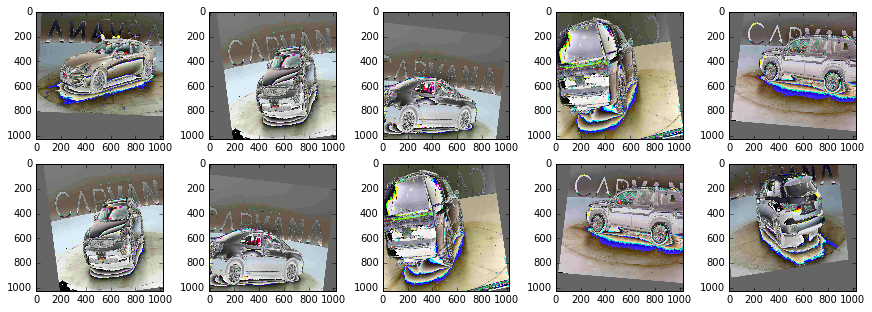

In [35]:
train_generator,valid_generator = get_generator(
                    train_folder = TRAIN,
                    train_mask_folder = TRAIN_MASKS,
                    valid_folder = VALID,
                    valid_mask_folder = VALID_MASKS,    
                    width_shift_range=0.2,
                    height_shift_range=0.2,
                    horizontal_flip=True,
                    rotation_range=10,
                    zoom_range=0.2,
                    channel_shift_range=0.5,
                    fill_mode="constant",
                    processes=3,
                    batch_size=8,
                    target_size=1024,
                    )

img,label = next(train_generator)
valid_img, valid_label = next(valid_generator)

fig, ax = plt.subplots(2, 5, figsize=(15, 5))
for i in range(2):
    for j in range(5):
        ix = i*5 + j
        ax[i][j].imshow(img[i+j])
        

In [38]:
train_generator

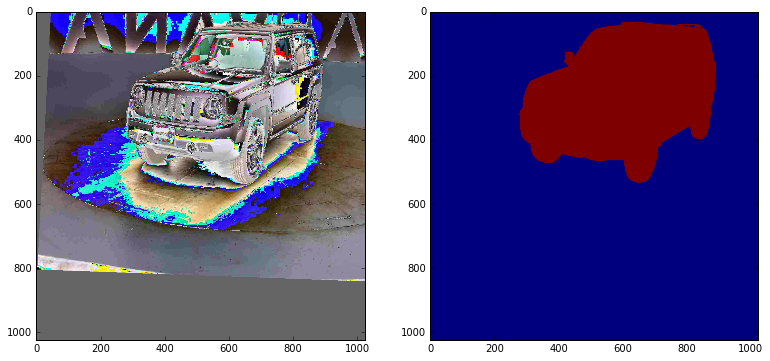

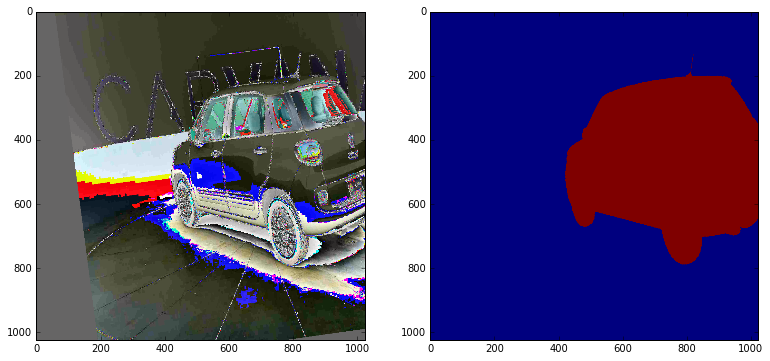

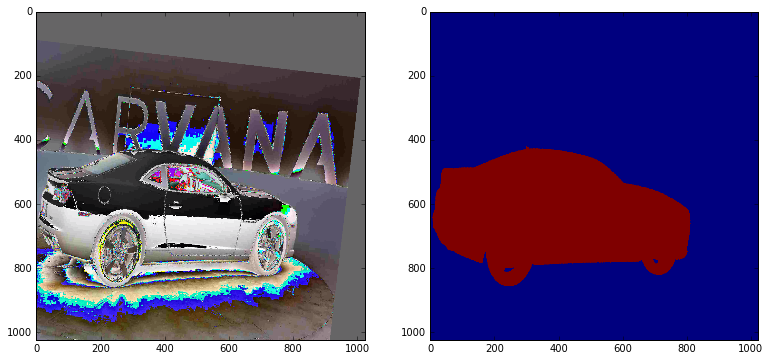

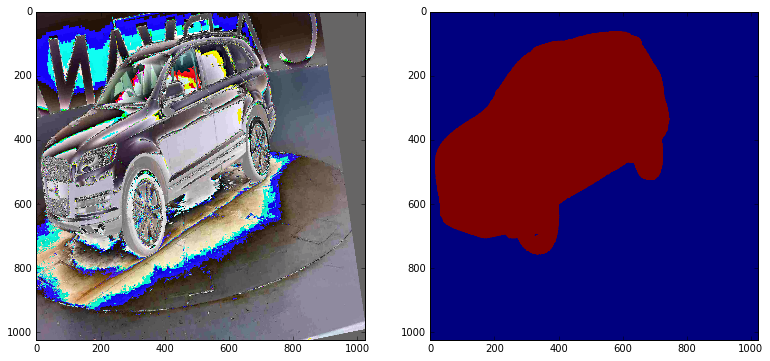

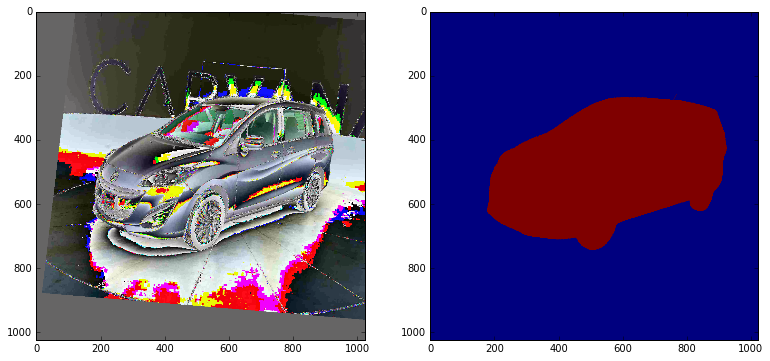

In [37]:
imgs, labels = next(train_generator)

for i in np.arange(0,5):
    plt.figure(figsize=(20, 10))
    plt.subplot(131)
    plt.imshow(imgs[i])
    plt.subplot(132)
    plt.imshow(labels[i,:,:,0])
    plt.show()


# NN train script

In [6]:
import os
from glob import glob
import tensorflow
from skimage.transform import resize
from skimage.io import imsave
import numpy as np
from keras.models import Model
from keras.layers import Input, concatenate, Conv2D, MaxPooling2D, Conv2DTranspose, UpSampling2D, Cropping2D, Activation
# from keras.layers import Input, merge, Convolution2D, MaxPooling2D, UpSampling2D, Reshape, core, Dropout
from keras.optimizers import Adam,RMSprop
from keras.callbacks import ModelCheckpoint
from keras import backend as K
K.set_image_data_format('channels_last')  # TF dimension ordering in this code
from keras.layers.normalization import BatchNormalization
from keras.preprocessing import image, sequence
from keras.preprocessing.image import ImageDataGenerator
from keras import backend as K
K.set_image_dim_ordering('tf')
from keras.losses import binary_crossentropy
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint, TensorBoard, CSVLogger
import multiprocessing
import time
import collections
import sys
import signal

batch_size = 2
smooth = 1.
sample_mean = 160.8
sample_std = 61.4
target_size = 1024

DATA = 'data/'
TRAIN = os.path.join(DATA, "train")
TRAIN_MASKS = os.path.join(DATA, "train_masks")
VALID = os.path.join(DATA, "valid")
VALID_MASKS = os.path.join(DATA, "valid_masks")


def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def bce_dice_loss(y_true, y_pred):
    return 0.5 * binary_crossentropy(y_true, y_pred) - dice_coef(y_true, y_pred)

def train_data_centering(image):
    return (image-sample_mean)/sample_std
    
def mask_data_centering(image):   
    return image/255

# The original class can be imported like this:
# from keras.preprocessing.image import ImageDataGenerator
# We access the modified version through T.ImageDataGenerator
import tools.image as T
# Useful for checking the output of the generators after code change
try:
    from importlib import reload
    reload(T)
except:
    reload(T)

def init_worker():
    signal.signal(signal.SIGINT, signal.SIG_IGN)
    
def get_unet_1024(input_shape=(1024, 1024, 3),num_classes=1):
    inputs = Input(shape=input_shape)
    # 1024

    down0b = Conv2D(8, (3, 3), padding='same')(inputs)
    down0b = BatchNormalization()(down0b)
    down0b = Activation('relu')(down0b)
    down0b = Conv2D(8, (3, 3), padding='same')(down0b)
    down0b = BatchNormalization()(down0b)
    down0b = Activation('relu')(down0b)
    down0b_pool = MaxPooling2D((2, 2), strides=(2, 2))(down0b)
    # 512

    down0a = Conv2D(16, (3, 3), padding='same')(down0b_pool)
    down0a = BatchNormalization()(down0a)
    down0a = Activation('relu')(down0a)
    down0a = Conv2D(16, (3, 3), padding='same')(down0a)
    down0a = BatchNormalization()(down0a)
    down0a = Activation('relu')(down0a)
    down0a_pool = MaxPooling2D((2, 2), strides=(2, 2))(down0a)
    # 256

    down0 = Conv2D(32, (3, 3), padding='same')(down0a_pool)
    down0 = BatchNormalization()(down0)
    down0 = Activation('relu')(down0)
    down0 = Conv2D(32, (3, 3), padding='same')(down0)
    down0 = BatchNormalization()(down0)
    down0 = Activation('relu')(down0)
    down0_pool = MaxPooling2D((2, 2), strides=(2, 2))(down0)
    # 128

    down1 = Conv2D(64, (3, 3), padding='same')(down0_pool)
    down1 = BatchNormalization()(down1)
    down1 = Activation('relu')(down1)
    down1 = Conv2D(64, (3, 3), padding='same')(down1)
    down1 = BatchNormalization()(down1)
    down1 = Activation('relu')(down1)
    down1_pool = MaxPooling2D((2, 2), strides=(2, 2))(down1)
    # 64

    down2 = Conv2D(128, (3, 3), padding='same')(down1_pool)
    down2 = BatchNormalization()(down2)
    down2 = Activation('relu')(down2)
    down2 = Conv2D(128, (3, 3), padding='same')(down2)
    down2 = BatchNormalization()(down2)
    down2 = Activation('relu')(down2)
    down2_pool = MaxPooling2D((2, 2), strides=(2, 2))(down2)
    # 32

    down3 = Conv2D(256, (3, 3), padding='same')(down2_pool)
    down3 = BatchNormalization()(down3)
    down3 = Activation('relu')(down3)
    down3 = Conv2D(256, (3, 3), padding='same')(down3)
    down3 = BatchNormalization()(down3)
    down3 = Activation('relu')(down3)
    down3_pool = MaxPooling2D((2, 2), strides=(2, 2))(down3)
    # 16

    down4 = Conv2D(512, (3, 3), padding='same')(down3_pool)
    down4 = BatchNormalization()(down4)
    down4 = Activation('relu')(down4)
    down4 = Conv2D(512, (3, 3), padding='same')(down4)
    down4 = BatchNormalization()(down4)
    down4 = Activation('relu')(down4)
    down4_pool = MaxPooling2D((2, 2), strides=(2, 2))(down4)
    # 8

    center = Conv2D(1024, (3, 3), padding='same')(down4_pool)
    center = BatchNormalization()(center)
    center = Activation('relu')(center)
    center = Conv2D(1024, (3, 3), padding='same')(center)
    center = BatchNormalization()(center)
    center = Activation('relu')(center)
    # center

    up4 = UpSampling2D((2, 2))(center)
    up4 = concatenate([down4, up4], axis=3)
    up4 = Conv2D(512, (3, 3), padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    up4 = Conv2D(512, (3, 3), padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    up4 = Conv2D(512, (3, 3), padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    # 16

    up3 = UpSampling2D((2, 2))(up4)
    up3 = concatenate([down3, up3], axis=3)
    up3 = Conv2D(256, (3, 3), padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    up3 = Conv2D(256, (3, 3), padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    up3 = Conv2D(256, (3, 3), padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    # 32

    up2 = UpSampling2D((2, 2))(up3)
    up2 = concatenate([down2, up2], axis=3)
    up2 = Conv2D(128, (3, 3), padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    up2 = Conv2D(128, (3, 3), padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    up2 = Conv2D(128, (3, 3), padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    # 64

    up1 = UpSampling2D((2, 2))(up2)
    up1 = concatenate([down1, up1], axis=3)
    up1 = Conv2D(64, (3, 3), padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    up1 = Conv2D(64, (3, 3), padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    up1 = Conv2D(64, (3, 3), padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    # 128

    up0 = UpSampling2D((2, 2))(up1)
    up0 = concatenate([down0, up0], axis=3)
    up0 = Conv2D(32, (3, 3), padding='same')(up0)
    up0 = BatchNormalization()(up0)
    up0 = Activation('relu')(up0)
    up0 = Conv2D(32, (3, 3), padding='same')(up0)
    up0 = BatchNormalization()(up0)
    up0 = Activation('relu')(up0)
    up0 = Conv2D(32, (3, 3), padding='same')(up0)
    up0 = BatchNormalization()(up0)
    up0 = Activation('relu')(up0)
    # 256

    up0a = UpSampling2D((2, 2))(up0)
    up0a = concatenate([down0a, up0a], axis=3)
    up0a = Conv2D(16, (3, 3), padding='same')(up0a)
    up0a = BatchNormalization()(up0a)
    up0a = Activation('relu')(up0a)
    up0a = Conv2D(16, (3, 3), padding='same')(up0a)
    up0a = BatchNormalization()(up0a)
    up0a = Activation('relu')(up0a)
    up0a = Conv2D(16, (3, 3), padding='same')(up0a)
    up0a = BatchNormalization()(up0a)
    up0a = Activation('relu')(up0a)
    # 512

    up0b = UpSampling2D((2, 2))(up0a)
    up0b = concatenate([down0b, up0b], axis=3)
    up0b = Conv2D(8, (3, 3), padding='same')(up0b)
    up0b = BatchNormalization()(up0b)
    up0b = Activation('relu')(up0b)
    up0b = Conv2D(8, (3, 3), padding='same')(up0b)
    up0b = BatchNormalization()(up0b)
    up0b = Activation('relu')(up0b)
    up0b = Conv2D(8, (3, 3), padding='same')(up0b)
    up0b = BatchNormalization()(up0b)
    up0b = Activation('relu')(up0b)
    # 1024

    classify = Conv2D(num_classes, (1, 1), activation='sigmoid')(up0b)

    model = Model(inputs=inputs, outputs=classify)

    model.compile(optimizer=RMSprop(lr=0.0001), loss=bce_dice_loss, metrics=['accuracy', dice_coef])

    return model

def get_generator(train_folder,
                    train_mask_folder,
                    valid_folder,
                    valid_mask_folder,
                    target_size,                  
                    width_shift_range=0.2,
                    height_shift_range=0.2,
                    horizontal_flip=True,
                    zca_whitening=False,
                    channel_shift_range=0.3,
                    rotation_range=10,
                    zoom_range=0.2,
                    classes=['fold_1','fold_2','fold_3'],
                    fill_mode="constant",
                    batch_size=1,
                    processes=2):
    
    seed = 42
    global pool
    try:
        pool.terminate()
    except:
        pass

    if processes: 
        pool = multiprocessing.Pool(processes=processes, initializer=init_worker)
    else:
        pool = None
        
    # Example taken from https://keras.io/preprocessing/image/
    # We create two instances with the same arguments
    data_gen_args_train = dict(
                        width_shift_range=width_shift_range,
                        height_shift_range=height_shift_range,
                        horizontal_flip=horizontal_flip,
                        rotation_range=rotation_range,
                        zoom_range=zoom_range,
                        preprocessing_function=train_data_centering,
                        fill_mode=fill_mode, 
                        zca_whitening = zca_whitening,
                        channel_shift_range = channel_shift_range,
                        cval=0,
                        pool=pool        
                        )

    data_gen_args_masks = dict(
                        width_shift_range=width_shift_range,
                        height_shift_range=height_shift_range,
                        horizontal_flip=horizontal_flip,
                        rotation_range=rotation_range,
                        zoom_range=zoom_range,
                        preprocessing_function=mask_data_centering,
                        fill_mode=fill_mode,
                        cval=0,
                        pool=pool         
                        )    
    
    image_datagen = T.ImageDataGenerator(**data_gen_args_train)
    # image_datagen.fit(data_sample)    
    mask_datagen = T.ImageDataGenerator(**data_gen_args_masks)

    image_generator = image_datagen.flow_from_directory(
        train_folder,
        batch_size = batch_size,
        target_size = (target_size, target_size),
        class_mode=None,
        color_mode='rgb',
        classes=classes,
        seed=seed)
    
    mask_generator = mask_datagen.flow_from_directory(
        train_mask_folder,
        batch_size = batch_size,    
        target_size = (target_size, target_size),    
        class_mode=None,
        color_mode='grayscale',
        classes=classes,
        seed=seed)

    valid_image_generator = image_datagen.flow_from_directory(
        valid_folder,
        batch_size = batch_size,
        target_size = (target_size, target_size),
        class_mode=None,
        color_mode='rgb',
        classes=classes,
        seed=seed)
    
    valid_mask_generator = mask_datagen.flow_from_directory(
        valid_mask_folder,
        batch_size = batch_size,    
        target_size = (target_size, target_size),    
        class_mode=None,
        color_mode='grayscale',
        classes=classes,
        seed=seed)
    # combine generators into one which yields image and masks
    train_generator = zip(image_generator, mask_generator)
    valid_generator = zip(valid_image_generator, valid_mask_generator)

    return train_generator,valid_generator

train_generator,valid_generator = get_generator(
                    train_folder = TRAIN,
                    train_mask_folder = TRAIN_MASKS,
                    valid_folder = VALID,
                    valid_mask_folder = VALID_MASKS,    
                    width_shift_range=0.2,
                    height_shift_range=0.2,
                    horizontal_flip=True,
                    rotation_range=10,
                    zoom_range=0.2,
                    channel_shift_range=0.3,
                    fill_mode="constant",
                    processes=3,
                    batch_size=8,
                    target_size=target_size,
                    )

callbacks = [EarlyStopping(monitor='val_dice_coef',
                           patience=8,
                           verbose=1,
                           min_delta=1e-4,
                           mode='max'),
             ReduceLROnPlateau(monitor='val_dice_coef',
                               factor=0.1,
                               patience=4,
                               verbose=1,
                               epsilon=1e-4,
                               mode='max'),
             ModelCheckpoint(monitor='val_dice_coef',
                             filepath='1024_unet.h5',
                             save_best_only=True,
                             save_weights_only=False,
                             mode='max'),
             TensorBoard(log_dir='logs'),
             CSVLogger('last_training_log.csv', separator=',', append=False)
            ]

model = get_unet_1024()
# model.load_weights('new_unet_lr_decay_b4_add_train.h5')
# model_checkpoint = ModelCheckpoint('new_unet_lr_decay_b4_add_train_test.h5', monitor='val_loss', save_best_only=True)

# flip train and valid generators
model.fit_generator(
            generator=valid_generator,
            steps_per_epoch=10176/batch_size,
            epochs=50,
            validation_data = train_generator,
            callbacks=callbacks,
            validation_steps = 5088/batch_size
        )


Found 10176 images belonging to 3 classes.
Found 10176 images belonging to 3 classes.
Found 5088 images belonging to 3 classes.
Found 5088 images belonging to 3 classes.


KeyboardInterrupt: 

# Test hue augmentation

In [22]:
import os
from glob import glob
import tensorflow
from skimage.transform import resize
from skimage.io import imsave
import numpy as np
from keras.models import Model
from keras.layers import Input, concatenate, Conv2D, MaxPooling2D, Conv2DTranspose, UpSampling2D, Cropping2D, Activation
# from keras.layers import Input, merge, Convolution2D, MaxPooling2D, UpSampling2D, Reshape, core, Dropout
from keras.optimizers import Adam,RMSprop
from keras.callbacks import ModelCheckpoint
from keras import backend as K
K.set_image_data_format('channels_last')  # TF dimension ordering in this code
from keras.layers.normalization import BatchNormalization
from keras.preprocessing import image, sequence
from keras.preprocessing.image import ImageDataGenerator
from keras import backend as K
K.set_image_dim_ordering('tf')
from keras.losses import binary_crossentropy
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint, TensorBoard, CSVLogger
import multiprocessing
import time
import collections
import sys
import signal
from keras.backend.tensorflow_backend import set_session
import cv2
from tools.clr_callback import *


config = tensorflow.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.95
set_session(tensorflow.Session(config=config))

batch_size = 4
smooth = 1.
sample_mean = 160.8
sample_std = 61.4
target_size = 1024

DATA = 'data/'
TRAIN = os.path.join(DATA, "train")
TRAIN_MASKS = os.path.join(DATA, "train_masks")
VALID = os.path.join(DATA, "valid")
VALID_MASKS = os.path.join(DATA, "valid_masks")


def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def bce_dice_loss(y_true, y_pred):
    return 0.5 * binary_crossentropy(y_true, y_pred) - dice_coef(y_true, y_pred)

def train_data_centering(image):
    return (image-sample_mean)/sample_std

def randomHueSaturationValue(image, hue_shift_limit=(-180, 180),
                             sat_shift_limit=(-255, 255),
                             val_shift_limit=(-255, 255), u=0.5):
    if np.random.random() < u:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(image)
        hue_shift = np.random.uniform(hue_shift_limit[0], hue_shift_limit[1])
        h = cv2.add(h, hue_shift)
        sat_shift = np.random.uniform(sat_shift_limit[0], sat_shift_limit[1])
        s = cv2.add(s, sat_shift)
        val_shift = np.random.uniform(val_shift_limit[0], val_shift_limit[1])
        v = cv2.add(v, val_shift)
        image = cv2.merge((h, s, v))
        image = cv2.cvtColor(image, cv2.COLOR_HSV2BGR)

    return image

def hue_transform(image):
    image = randomHueSaturationValue(image,
                                   hue_shift_limit=(-50, 50),
                                   sat_shift_limit=(-5, 5),
                                   val_shift_limit=(-15, 15))
    return image/255

def mask_data_centering(image):   
    return image/255

# The original class can be imported like this:
# from keras.preprocessing.image import ImageDataGenerator
# We access the modified version through T.ImageDataGenerator
import tools.image as T
# Useful for checking the output of the generators after code change
try:
    from importlib import reload
    reload(T)
except:
    reload(T)

def init_worker():
    signal.signal(signal.SIGINT, signal.SIG_IGN)
    
def get_unet_1024(input_shape=(1024, 1024, 3),num_classes=1):
    inputs = Input(shape=input_shape)
    # 1024

    down0b = Conv2D(8, (3, 3), padding='same')(inputs)
    down0b = BatchNormalization()(down0b)
    down0b = Activation('relu')(down0b)
    down0b = Conv2D(8, (3, 3), padding='same')(down0b)
    down0b = BatchNormalization()(down0b)
    down0b = Activation('relu')(down0b)
    down0b_pool = MaxPooling2D((2, 2), strides=(2, 2))(down0b)
    # 512

    down0a = Conv2D(16, (3, 3), padding='same')(down0b_pool)
    down0a = BatchNormalization()(down0a)
    down0a = Activation('relu')(down0a)
    down0a = Conv2D(16, (3, 3), padding='same')(down0a)
    down0a = BatchNormalization()(down0a)
    down0a = Activation('relu')(down0a)
    down0a_pool = MaxPooling2D((2, 2), strides=(2, 2))(down0a)
    # 256

    down0 = Conv2D(32, (3, 3), padding='same')(down0a_pool)
    down0 = BatchNormalization()(down0)
    down0 = Activation('relu')(down0)
    down0 = Conv2D(32, (3, 3), padding='same')(down0)
    down0 = BatchNormalization()(down0)
    down0 = Activation('relu')(down0)
    down0_pool = MaxPooling2D((2, 2), strides=(2, 2))(down0)
    # 128

    down1 = Conv2D(64, (3, 3), padding='same')(down0_pool)
    down1 = BatchNormalization()(down1)
    down1 = Activation('relu')(down1)
    down1 = Conv2D(64, (3, 3), padding='same')(down1)
    down1 = BatchNormalization()(down1)
    down1 = Activation('relu')(down1)
    down1_pool = MaxPooling2D((2, 2), strides=(2, 2))(down1)
    # 64

    down2 = Conv2D(128, (3, 3), padding='same')(down1_pool)
    down2 = BatchNormalization()(down2)
    down2 = Activation('relu')(down2)
    down2 = Conv2D(128, (3, 3), padding='same')(down2)
    down2 = BatchNormalization()(down2)
    down2 = Activation('relu')(down2)
    down2_pool = MaxPooling2D((2, 2), strides=(2, 2))(down2)
    # 32

    down3 = Conv2D(256, (3, 3), padding='same')(down2_pool)
    down3 = BatchNormalization()(down3)
    down3 = Activation('relu')(down3)
    down3 = Conv2D(256, (3, 3), padding='same')(down3)
    down3 = BatchNormalization()(down3)
    down3 = Activation('relu')(down3)
    down3_pool = MaxPooling2D((2, 2), strides=(2, 2))(down3)
    # 16

    down4 = Conv2D(512, (3, 3), padding='same')(down3_pool)
    down4 = BatchNormalization()(down4)
    down4 = Activation('relu')(down4)
    down4 = Conv2D(512, (3, 3), padding='same')(down4)
    down4 = BatchNormalization()(down4)
    down4 = Activation('relu')(down4)
    down4_pool = MaxPooling2D((2, 2), strides=(2, 2))(down4)
    # 8

    center = Conv2D(1024, (3, 3), padding='same')(down4_pool)
    center = BatchNormalization()(center)
    center = Activation('relu')(center)
    center = Conv2D(1024, (3, 3), padding='same')(center)
    center = BatchNormalization()(center)
    center = Activation('relu')(center)
    # center

    up4 = UpSampling2D((2, 2))(center)
    up4 = concatenate([down4, up4], axis=3)
    up4 = Conv2D(512, (3, 3), padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    up4 = Conv2D(512, (3, 3), padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    up4 = Conv2D(512, (3, 3), padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    # 16

    up3 = UpSampling2D((2, 2))(up4)
    up3 = concatenate([down3, up3], axis=3)
    up3 = Conv2D(256, (3, 3), padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    up3 = Conv2D(256, (3, 3), padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    up3 = Conv2D(256, (3, 3), padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    # 32

    up2 = UpSampling2D((2, 2))(up3)
    up2 = concatenate([down2, up2], axis=3)
    up2 = Conv2D(128, (3, 3), padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    up2 = Conv2D(128, (3, 3), padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    up2 = Conv2D(128, (3, 3), padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    # 64

    up1 = UpSampling2D((2, 2))(up2)
    up1 = concatenate([down1, up1], axis=3)
    up1 = Conv2D(64, (3, 3), padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    up1 = Conv2D(64, (3, 3), padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    up1 = Conv2D(64, (3, 3), padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    # 128

    up0 = UpSampling2D((2, 2))(up1)
    up0 = concatenate([down0, up0], axis=3)
    up0 = Conv2D(32, (3, 3), padding='same')(up0)
    up0 = BatchNormalization()(up0)
    up0 = Activation('relu')(up0)
    up0 = Conv2D(32, (3, 3), padding='same')(up0)
    up0 = BatchNormalization()(up0)
    up0 = Activation('relu')(up0)
    up0 = Conv2D(32, (3, 3), padding='same')(up0)
    up0 = BatchNormalization()(up0)
    up0 = Activation('relu')(up0)
    # 256

    up0a = UpSampling2D((2, 2))(up0)
    up0a = concatenate([down0a, up0a], axis=3)
    up0a = Conv2D(16, (3, 3), padding='same')(up0a)
    up0a = BatchNormalization()(up0a)
    up0a = Activation('relu')(up0a)
    up0a = Conv2D(16, (3, 3), padding='same')(up0a)
    up0a = BatchNormalization()(up0a)
    up0a = Activation('relu')(up0a)
    up0a = Conv2D(16, (3, 3), padding='same')(up0a)
    up0a = BatchNormalization()(up0a)
    up0a = Activation('relu')(up0a)
    # 512

    up0b = UpSampling2D((2, 2))(up0a)
    up0b = concatenate([down0b, up0b], axis=3)
    up0b = Conv2D(8, (3, 3), padding='same')(up0b)
    up0b = BatchNormalization()(up0b)
    up0b = Activation('relu')(up0b)
    up0b = Conv2D(8, (3, 3), padding='same')(up0b)
    up0b = BatchNormalization()(up0b)
    up0b = Activation('relu')(up0b)
    up0b = Conv2D(8, (3, 3), padding='same')(up0b)
    up0b = BatchNormalization()(up0b)
    up0b = Activation('relu')(up0b)
    # 1024

    classify = Conv2D(num_classes, (1, 1), activation='sigmoid')(up0b)

    model = Model(inputs=inputs, outputs=classify)

    model.compile(optimizer=RMSprop(lr=0.0001), loss=bce_dice_loss, metrics=['accuracy', dice_coef])

    return model

def get_generator(train_folder,
                    train_mask_folder,
                    valid_folder,
                    valid_mask_folder,
                    target_size,                  
                    width_shift_range=0.3,
                    height_shift_range=0.3,
                    horizontal_flip=True,
                    zca_whitening=False,
                    channel_shift_range=0.5,
                    rotation_range=20,
                    zoom_range=0.3,
                    classes=['fold_1','fold_2','fold_3'],
                    fill_mode="constant",
                    batch_size=1,
                    processes=2):
    
    seed = 42
    global pool
    try:
        pool.terminate()
    except:
        pass

    if processes: 
        pool = multiprocessing.Pool(processes=processes, initializer=init_worker)
    else:
        pool = None
        
    # Example taken from https://keras.io/preprocessing/image/
    # We create two instances with the same arguments
    data_gen_args_train = dict(
                        width_shift_range=width_shift_range,
                        height_shift_range=height_shift_range,
                        horizontal_flip=horizontal_flip,
                        rotation_range=rotation_range,
                        zoom_range=zoom_range,
                        preprocessing_function=hue_transform,
                        fill_mode=fill_mode, 
                        zca_whitening = zca_whitening,
                        channel_shift_range = channel_shift_range,
                        cval=0,
                        pool=pool        
                        )

    data_gen_args_masks = dict(
                        width_shift_range=width_shift_range,
                        height_shift_range=height_shift_range,
                        horizontal_flip=horizontal_flip,
                        rotation_range=rotation_range,
                        zoom_range=zoom_range,
                        preprocessing_function=mask_data_centering,
                        fill_mode=fill_mode,
                        cval=0,
                        pool=pool         
                        )    
    
    image_datagen = T.ImageDataGenerator(**data_gen_args_train)
    # image_datagen.fit(data_sample)    
    mask_datagen = T.ImageDataGenerator(**data_gen_args_masks)

    image_generator = image_datagen.flow_from_directory(
        train_folder,
        batch_size = batch_size,
        target_size = (target_size, target_size),
        class_mode=None,
        color_mode='rgb',
        classes=classes,
        seed=seed)
    
    mask_generator = mask_datagen.flow_from_directory(
        train_mask_folder,
        batch_size = batch_size,    
        target_size = (target_size, target_size),    
        class_mode=None,
        color_mode='grayscale',
        classes=classes,
        seed=seed)

    valid_image_generator = image_datagen.flow_from_directory(
        valid_folder,
        batch_size = batch_size,
        target_size = (target_size, target_size),
        class_mode=None,
        color_mode='rgb',
        classes=classes,
        seed=seed)
    
    valid_mask_generator = mask_datagen.flow_from_directory(
        valid_mask_folder,
        batch_size = batch_size,    
        target_size = (target_size, target_size),    
        class_mode=None,
        color_mode='grayscale',
        classes=classes,
        seed=seed)
    # combine generators into one which yields image and masks
    train_generator = zip(image_generator, mask_generator)
    valid_generator = zip(valid_image_generator, valid_mask_generator)

    return train_generator,valid_generator

train_generator,valid_generator = get_generator(
                    train_folder = TRAIN,
                    train_mask_folder = TRAIN_MASKS,
                    valid_folder = VALID,
                    valid_mask_folder = VALID_MASKS,    
                    width_shift_range=0.06,
                    height_shift_range=0.06,
                    horizontal_flip=True,
                    rotation_range=0.,
                    zoom_range=0.1,
                    channel_shift_range=0.,
                    fill_mode="constant",
                    batch_size=batch_size,
                    target_size=target_size,
                    processes = 4
                    )

clr = CyclicLR(base_lr=1e-6, max_lr=1e-4,
                    step_size=5000., mode='exp_range',
                    gamma=0.99994)

callbacks = [EarlyStopping(monitor='val_dice_coef',
                           patience=10,
                           verbose=1,
                           min_delta=1e-4,
                           mode='max'),
             ReduceLROnPlateau(monitor='val_dice_coef',
                               factor=0.1,
                               patience=4,
                               verbose=1,
                               epsilon=1e-4,
                               mode='max'),
             ModelCheckpoint(monitor='val_dice_coef',
                             filepath='1024_unet_hue_low_aug.h5',
                             save_best_only=True,
                             save_weights_only=False,
                             mode='max'),
             TensorBoard(log_dir='logs'),
             CSVLogger('last_training_log.csv', separator=',', append=False),
             clr
            ]




Found 10176 images belonging to 3 classes.
Found 10176 images belonging to 3 classes.
Found 5088 images belonging to 3 classes.
Found 5088 images belonging to 3 classes.


In [52]:
def hue_transform(image):
    image = randomHueSaturationValue(image,
                                   hue_shift_limit=(-50, 50),
                                   sat_shift_limit=(-5, 5),
                                   val_shift_limit=(-15, 15))
    return image/255

Found 10176 images belonging to 3 classes.
Found 10176 images belonging to 3 classes.
Found 5088 images belonging to 3 classes.
Found 5088 images belonging to 3 classes.


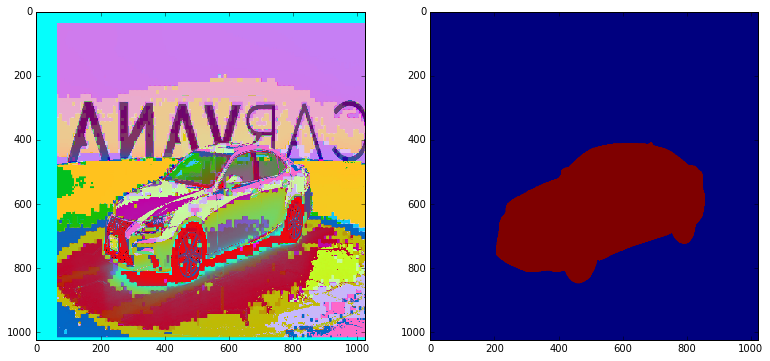

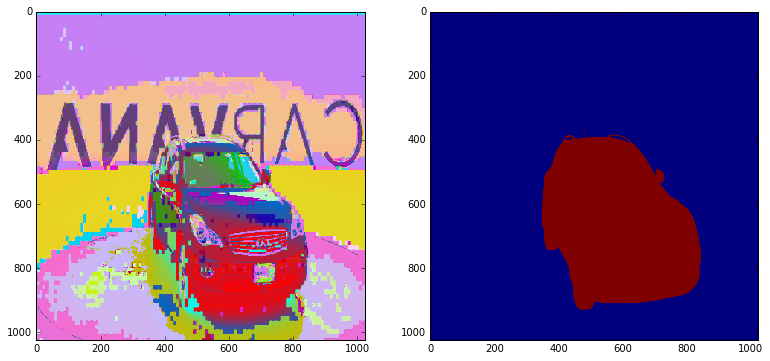

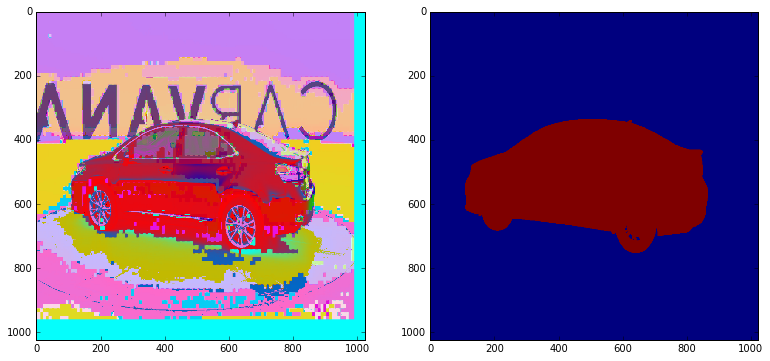

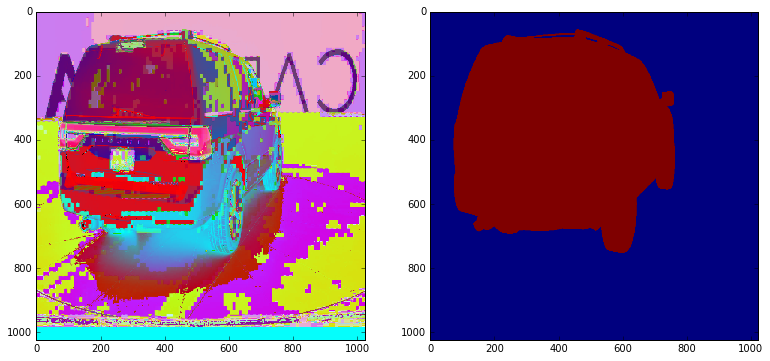

In [53]:
train_generator,valid_generator = get_generator(
                    train_folder = TRAIN,
                    train_mask_folder = TRAIN_MASKS,
                    valid_folder = VALID,
                    valid_mask_folder = VALID_MASKS,    
                    width_shift_range=0.06,
                    height_shift_range=0.06,
                    horizontal_flip=True,
                    rotation_range=0.,
                    zoom_range=0.1,
                    channel_shift_range=0.,
                    fill_mode="constant",
                    batch_size=batch_size,
                    target_size=target_size,
                    processes = 4
                    )

imgs, labels = next (train_generator)

import matplotlib.pyplot as plt

for i in np.arange(0,4):
    plt.figure(figsize=(20, 10))
    plt.subplot(131)
    plt.imshow(imgs[i])
    plt.subplot(132)
    plt.imshow(labels[i,:,:,0])
    plt.show()

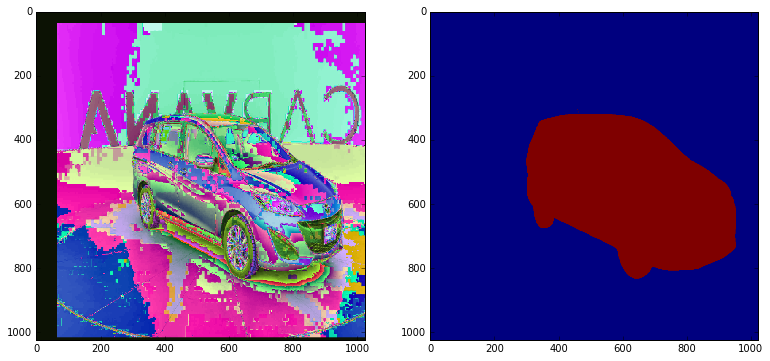

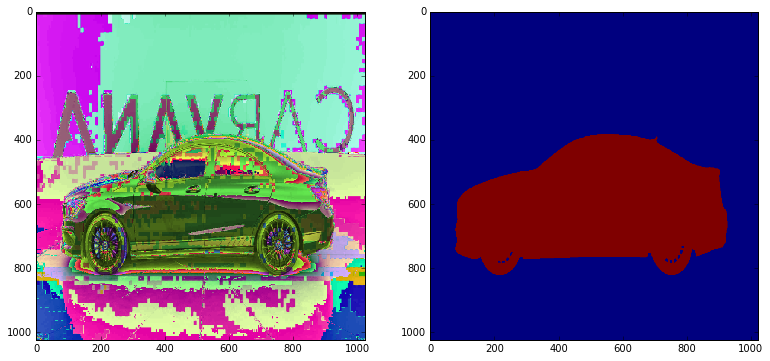

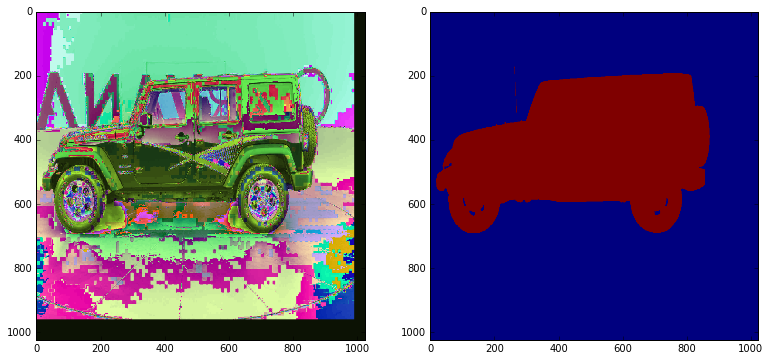

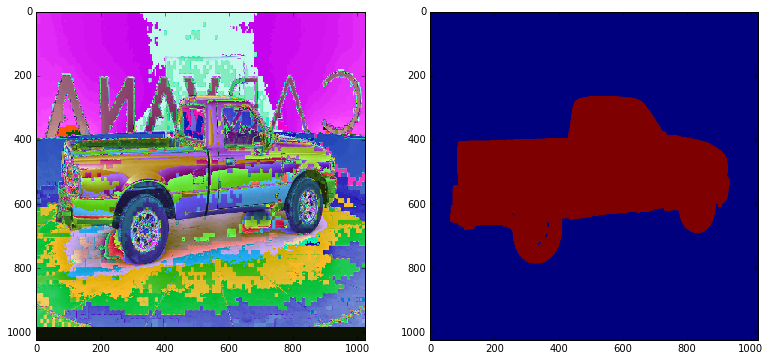

In [58]:
imgs, labels = next (train_generator)

for i in np.arange(0,4):
    plt.figure(figsize=(20, 10))
    plt.subplot(131)
    plt.imshow(imgs[i])
    plt.subplot(132)
    plt.imshow(labels[i,:,:,0])
    plt.show()

# Predictions

In [1]:
import pandas as pd
import numpy as np
import cv2
from tqdm import tqdm
from skimage.io import imread

df_test = pd.read_csv('data/sample_submission.csv')
ids_test = df_test['img'].map(lambda s: s.split('.')[0])


In [28]:
split_indices = np.arange(start=516,stop=100104,step=516)

In [30]:
ids_test_splits = np.split(ids_test, indices_or_sections=split_indices)

In [31]:
len(ids_test_splits)

194

In [37]:
c = 0 
for i in range(0,194):
    c += len(ids_test_splits[i])
    
c

100064

In [38]:
len(ids_test_splits)

194

In [ ]:
import pandas as pd
import numpy as np
import cv2
from tqdm import tqdm
from skimage.io import imread
from model_import import *
# import objgraph
import gc
from tools.multi_gpu import *

df_test = pd.read_csv('data/sample_submission.csv')
ids_test = df_test['img'].map(lambda s: s.split('.')[0])

batch_size = 12 * 3

orig_width = 1918
orig_height = 1280
rescale_width = 1024
rescale_height = 1024

threshold = 0.5

def load_model(get_model,model_weights):
    model = get_model()

    model = make_parallel(model, gpu_count=2)
    model.compile(optimizer=RMSprop(lr=1e-4), loss=bce_dice_loss, metrics=['accuracy', dice_coef])

    model.load_weights(filepath=model_weights)

    return model

names = []
for id in ids_test:
    names.append('{}.jpg'.format(id))

model_weights_list = ['2048_unet_3gpu_split_add_train.h5']

# objgraph.show_growth(limit=10)

# https://www.kaggle.com/stainsby/fast-tested-rle
def run_length_encode(mask):
    '''
    img: numpy array, 1 - mask, 0 - background
    Returns run length as string formated
    '''
    inds = mask.flatten()
    runs = np.where(inds[1:] != inds[:-1])[0] + 2
    runs[1::2] = runs[1::2] - runs[:-1:2]
    rle = ' '.join([str(r) for r in runs])
    return rle


def test_generator():
    global ids_test_split
    global batch_size

    while True:
        for start in range(0, len(ids_test_split), batch_size):
            x_batch = []
            end = min(start + batch_size, len(ids_test_split))
            ids_test_split_batch = ids_test_split[start:end]
            for id in ids_test_split_batch.values:
                img = imread('data/test/{}.jpg'.format(id))
                img = cv2.resize(img, (rescale_width*2,rescale_height))
                x_batch.append(img)
            x_batch = np.array(x_batch, np.float32)
            yield train_data_centering(x_batch)

def process_one_split(ids_test_split,model_weights,model):
    global split_count
    global processed_imgs_count
    
    rles = []
    print("Predicting on {} samples (split {}/{})".format(len(ids_test_split), split_count, len(np.arange(start=516,stop=100104,step=516))))
    preds = model.predict_generator(generator=test_generator(),
                                    # steps = 1,
                                    steps=np.ceil(float(len(ids_test_split)) / float(batch_size)),
                                    verbose=1)
    preds = np.squeeze(preds, axis=3)
    print("Generating masks...")
    for pred in tqdm(preds, miniters=1000):
        prob = cv2.resize(pred, (orig_width,orig_height))
        mask = prob > threshold
        rle = run_length_encode(mask)
        rles.append(rle)
    print("Generating submission file for split {}".format(split_count))
    print("File list indexes are {}-{}".format(processed_imgs_count,processed_imgs_count+len(rles)))

    df = pd.DataFrame({'img': names[processed_imgs_count:processed_imgs_count+len(rles)], 'rle_mask': rles})
    
    processed_imgs_count += len(rles)
    df.to_csv('{}{}.csv.gz'.format(model_weights[:-2],str(split_count).zfill(3)), index=False, compression='gzip')

test_splits = 32  # Split test set (number of splits must be multiple of 2)

split_indices = np.arange(start=516,stop=100104,step=516)
ids_test_splits = np.split(ids_test, indices_or_sections=split_indices)


    
for model_weights in model_weights_list:
    split_count = 0
    processed_imgs_count= 0 
    
    K.clear_session()
    model = load_model(get_unet_1024,model_weights)   

    for ids_test_split in ids_test_splits:
        split_count += 1  
        
        # Add 4 dummy images so that total number is divisible by 3
        if split_count==194:
            # ids_test_split.append(ids_test_split[-4:])
            process_one_split(ids_test_split,model_weights,model)
            gc.collect()


In [2]:
import pandas as pd
import os
from glob import glob

model_weights_list = ['2048_unet_3gpu_split_add_train.h5']

for model_weights in model_weights_list:
    g = glob(model_weights[:-2]+'*.csv.gz')
    g.sort()

    df_test = pd.read_csv('data/sample_submission.csv')
    ids_test = df_test['img'].map(lambda s: s.split('.')[0])

    names = []
    for id in ids_test:
        names.append('{}.jpg'.format(id))

    df = pd.DataFrame(columns=['img','rle_mask'])
    for file in g:
        df2 = pd.read_csv(file, compression='gzip', header=0, sep=',', quotechar='"')
        df = df.append(df2, ignore_index=True)

    # df['img'] = names    
    # df.to_csv('{}.csv.gz'.format(model_weights[:-3]), index=False, compression='gzip')
    print (model_weights)
    print(df.shape)

2048_unet_3gpu_split_add_train.h5
(100064, 2)


In [118]:
import pandas as pd
import os
from glob import glob

submission_file = 'submission_selu_angle'


g = glob('submit/'+submission_file+'*.csv.gz')
g.sort()

df = pd.DataFrame(columns=['img','rle_mask'])

for file in g:
    df2 = pd.read_csv(file, compression='gzip', header=0, sep=',', quotechar='"')
    df = df.append(df2, ignore_index=True)
    
print(df.shape)


(100064, 2)


In [119]:
df.to_csv('{}.csv.gz'.format('submit/submission_selu_angle'), index=False, compression='gzip')

In [120]:
len(df.img.unique())

100064

In [6]:
df['img'] = names   

In [ ]:
df.to_csv('{}.csv.gz'.format(model_weights[:-3]), index=False, compression='gzip')

In [7]:
len(df.img.unique())

100064

In [12]:
ids_test_splits = np.split(ids_test, indices_or_sections=split_indices)

In [19]:
len(ids_test_splits[3])

500

In [11]:
import numpy as np 
split_indices = np.arange(start=1000,stop=101000,step=500)

In [8]:
df.head()

,img,rle_mask
0,0004d4463b50_01.jpg,612705 8 612730 68 614591 166 616474 229 61836...
1,0004d4463b50_02.jpg,610862 4 610893 7 610911 4 612694 145 614584 2...
2,0004d4463b50_03.jpg,610829 44 612709 5 612716 116 614608 155 61650...
3,0004d4463b50_04.jpg,607240 2 609156 6 611071 10 612740 64 612817 1...
4,0004d4463b50_05.jpg,612768 76 613019 7 614668 123 614937 8 616572 ...


# Predict for semi-supervised approach

In [22]:
! ls -ls data/train/add/ | wc -l
! ls -ls data/train_masks/add/ | wc -l
! ls -ls data/valid/add/ | wc -l

1
1
1


In [8]:
!ls -ls data/valid/add/

total 11200
20 -rw-r--r-- 1 root root 18962 авг 19 21:07 0004d4463b50_01.jpg
20 -rw-r--r-- 1 root root 19601 авг 19 21:07 0004d4463b50_02.jpg
24 -rw-r--r-- 1 root root 21023 авг 19 21:07 0004d4463b50_03.jpg
24 -rw-r--r-- 1 root root 21898 авг 19 21:07 0004d4463b50_04.jpg
24 -rw-r--r-- 1 root root 21887 авг 19 21:07 0004d4463b50_05.jpg
24 -rw-r--r-- 1 root root 21176 авг 19 21:07 0004d4463b50_06.jpg
20 -rw-r--r-- 1 root root 20347 авг 19 21:07 0004d4463b50_07.jpg
20 -rw-r--r-- 1 root root 19471 авг 19 21:07 0004d4463b50_08.jpg
20 -rw-r--r-- 1 root root 17703 авг 19 21:07 0004d4463b50_09.jpg
20 -rw-r--r-- 1 root root 19062 авг 19 21:07 0004d4463b50_10.jpg
20 -rw-r--r-- 1 root root 20116 авг 19 21:07 0004d4463b50_11.jpg
24 -rw-r--r-- 1 root root 21166 авг 19 21:07 0004d4463b50_12.jpg
24 -rw-r--r-- 1 root root 22043 авг 19 21:07 0004d4463b50_13.jpg
24 -rw-r--r-- 1 root root 21814 авг 19 21:07 0004d4463b50_14.jpg
24 -rw-r--r-- 1 root root 21220 авг 19 21:07 0004d4463b50_15.jpg
20 -rw-r--r--

In [20]:
!rm  data/train/add/*
!rm  data/train_masks/add/*

In [23]:
import pandas as pd
import numpy as np
import cv2
# from tqdm import tqdm
from skimage.io import imread
from model_import import *
# import objgraph
import gc
from random import shuffle

df_test = pd.read_csv('data/sample_submission.csv')
ids_test = df_test['img'].map(lambda s: s.split('.')[0])

batch_size = 16

orig_width = 1918
orig_height = 1280
rescale_width = 1024
rescale_height = 1024

threshold = 0.5

def load_model(get_model,model_weights):
    model = get_model()
    model.load_weights(filepath=model_weights)
    return model

names = []
for id in ids_test:
    names.append('{}.jpg'.format(id))

model_weights = '1024_unet.h5'
# objgraph.show_growth(limit=10)

# https://www.kaggle.com/stainsby/fast-tested-rle
def run_length_encode(mask):
    '''
    img: numpy array, 1 - mask, 0 - background
    Returns run length as string formated
    '''
    inds = mask.flatten()
    runs = np.where(inds[1:] != inds[:-1])[0] + 2
    runs[1::2] = runs[1::2] - runs[:-1:2]
    rle = ' '.join([str(r) for r in runs])
    return rle


def test_generator():
    global ids_test_split
    global batch_size
    global it

    while True:
        for start in range(0, len(ids_test_split), batch_size):
            x_batch = []
            end = min(start + batch_size, len(ids_test_split))
            ids_test_split_batch = ids_test_split[start:end]
            for id in ids_test_split_batch:
                img = imread('data/test/{}.jpg'.format(id))
                imsave('data/train/add/{}_{}.jpg'.format(id,it), img)                  
                img = cv2.resize(img, (rescale_width,rescale_height))

                x_batch.append(img)
            x_batch = np.array(x_batch, np.float32)
            yield train_data_centering(x_batch)

test_splits = 1
# ids_test_splits = np.split(ids_test, indices_or_sections=test_splits)

split_count = 1   
K.clear_session()
model = load_model(get_unet_1024,model_weights)    

for it in range(1,7):
    
    shuffle(ids_test[0:500])
    ids_test_split = list(ids_test[0:500]) 
    
    print("Predicting on {} samples (split {}/{})".format(len(ids_test_split), split_count, test_splits))
    preds = model.predict_generator(generator=test_generator(),
                                    # steps = 1,
                                    steps=np.ceil(float(len(ids_test_split)) / float(batch_size)),
                                    verbose=1)
    preds = np.squeeze(preds, axis=3)
    print("Saving masks...")

    for i in range(0,len(ids_test_split)):
        mask = (preds[i] > threshold) * 255
        mask = mask.astype('uint8')
        mask = cv2.resize(mask, (orig_width,orig_height))        
        imsave('data/train_masks/add/{}_{}.jpg'.format(ids_test_split[i],it), mask)  
        

Predicting on 500 samples (split 1/1)
32/32 [==============================] - 68s    
Saving masks...
Predicting on 500 samples (split 1/1)
32/32 [==============================] - 71s    
Saving masks...
Predicting on 500 samples (split 1/1)
32/32 [==============================] - 70s    
Saving masks...
Predicting on 500 samples (split 1/1)
32/32 [==============================] - 70s    
Saving masks...
Predicting on 500 samples (split 1/1)
32/32 [==============================] - 69s    
Saving masks...
Predicting on 500 samples (split 1/1)
32/32 [==============================] - 72s    
Saving masks...


In [3]:
from glob import glob

g1 = glob('data/train/add/*.jpg')
g2 = glob('data/valid/add/*.jpg')


In [5]:
g2

['data/valid/add/00322b309335_1500322b309335_1500322b309335_1500322b309335_1500322b309335_15.jpg',
 'data/valid/add/00afb946a54c_0200afb946a54c_0200afb946a54c_02.jpg',
 'data/valid/add/0004d4463b50_100004d4463b50_100004d4463b50_100004d4463b50_10.jpg',
 'data/valid/add/001a04be361e_12001a04be361e_12001a04be361e_12001a04be361e_12001a04be361e_12.jpg',
 'data/valid/add/000f19f6e7d4_06000f19f6e7d4_06000f19f6e7d4_06000f19f6e7d4_06000f19f6e7d4_06.jpg',
 'data/valid/add/004b030cf28f_02004b030cf28f_02004b030cf28f_02004b030cf28f_02.jpg',
 'data/valid/add/007da964b668_12007da964b668_12007da964b668_12.jpg',
 'data/valid/add/00c07d49f4c5_0600c07d49f4c5_06.jpg',
 'data/valid/add/011330127438_05011330127438_05.jpg',
 'data/valid/add/00322b309335_10.jpg',
 'data/valid/add/008d02b91746_12008d02b91746_12.jpg',
 'data/valid/add/00ad56bf7ee6_0700ad56bf7ee6_0700ad56bf7ee6_0700ad56bf7ee6_0700ad56bf7ee6_0700ad56bf7ee6_07.jpg',
 'data/valid/add/014548a9586a_10014548a9586a_10014548a9586a_10.jpg',
 'data/valid/

In [24]:
def get_generator(train_folder,
                    train_mask_folder,
                    valid_folder,
                    valid_mask_folder,
                    target_size,                  
                    width_shift_range=0.2,
                    height_shift_range=0.2,
                    horizontal_flip=True,
                    zca_whitening=False,
                    channel_shift_range=0.3,
                    rotation_range=10,
                    zoom_range=0.2,
                    classes=['add'],
                    fill_mode="constant",
                    batch_size=1,
                    processes=None):
    
    seed = 42
    global pool
    try:
        pool.terminate()
    except:
        pass

    if processes: 
        pool = multiprocessing.Pool(processes=processes, initializer=init_worker)
    else:
        pool = None
        
    # Example taken from https://keras.io/preprocessing/image/
    # We create two instances with the same arguments
    data_gen_args_train = dict(
                        width_shift_range=width_shift_range,
                        height_shift_range=height_shift_range,
                        horizontal_flip=horizontal_flip,
                        rotation_range=rotation_range,
                        zoom_range=zoom_range,
                        preprocessing_function=train_data_centering,
                        fill_mode=fill_mode, 
                        zca_whitening = zca_whitening,
                        channel_shift_range = channel_shift_range,
                        cval=0,
                        pool=pool        
                        )

    data_gen_args_masks = dict(
                        width_shift_range=width_shift_range,
                        height_shift_range=height_shift_range,
                        horizontal_flip=horizontal_flip,
                        rotation_range=rotation_range,
                        zoom_range=zoom_range,
                        preprocessing_function=mask_data_centering,
                        fill_mode=fill_mode,
                        cval=0,
                        pool=pool         
                        )    
    
    image_datagen = T.ImageDataGenerator(**data_gen_args_train)
    # image_datagen.fit(data_sample)    
    mask_datagen = T.ImageDataGenerator(**data_gen_args_masks)

    image_generator = image_datagen.flow_from_directory(
        train_folder,
        batch_size = batch_size,
        target_size = (target_size, target_size),
        class_mode=None,
        color_mode='rgb',
        classes=classes,
        seed=seed)
    
    mask_generator = mask_datagen.flow_from_directory(
        train_mask_folder,
        batch_size = batch_size,    
        target_size = (target_size, target_size),    
        class_mode=None,
        color_mode='grayscale',
        classes=classes,
        seed=seed)

    valid_image_generator = image_datagen.flow_from_directory(
        valid_folder,
        batch_size = batch_size,
        target_size = (target_size, target_size),
        class_mode=None,
        color_mode='rgb',
        classes=classes,
        seed=seed)
    
    valid_mask_generator = mask_datagen.flow_from_directory(
        valid_mask_folder,
        batch_size = batch_size,    
        target_size = (target_size, target_size),    
        class_mode=None,
        color_mode='grayscale',
        classes=classes,
        seed=seed)
    # combine generators into one which yields image and masks
    train_generator = zip(image_generator, mask_generator)
    valid_generator = zip(valid_image_generator, valid_mask_generator)

    return train_generator,valid_generator

train_generator,valid_generator = get_generator(
                    train_folder = TRAIN,
                    train_mask_folder = TRAIN_MASKS,
                    valid_folder = VALID,
                    valid_mask_folder = VALID_MASKS,    
                    width_shift_range=0.2,
                    height_shift_range=0.2,
                    horizontal_flip=True,
                    rotation_range=10,
                    zoom_range=0.2,
                    channel_shift_range=0.3,
                    fill_mode="constant",
                    processes=3,
                    batch_size=8,
                    target_size=target_size,
                    )

Found 3000 images belonging to 1 classes.
Found 3000 images belonging to 1 classes.
Found 0 images belonging to 1 classes.
Found 0 images belonging to 1 classes.


In [27]:
imgs, labels = next(train_generator)

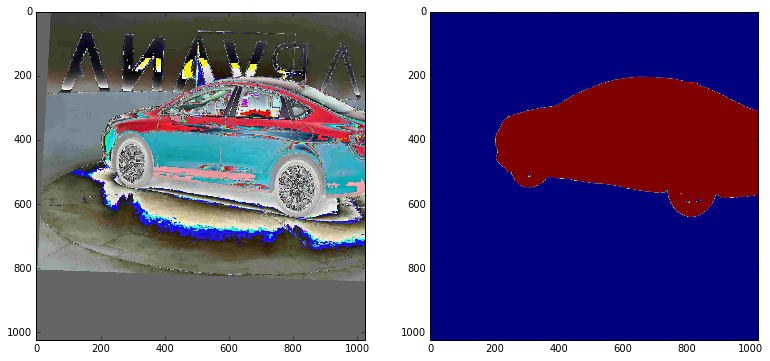

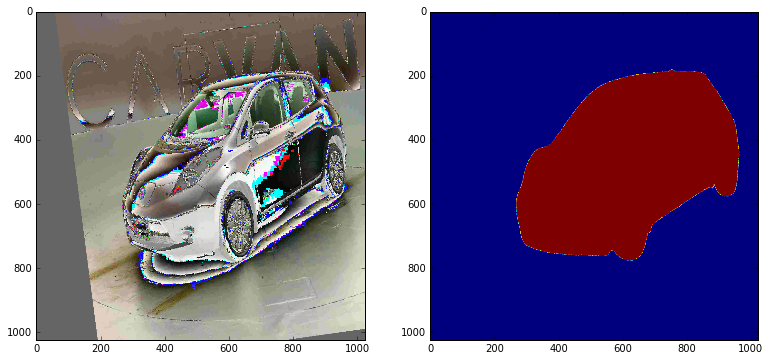

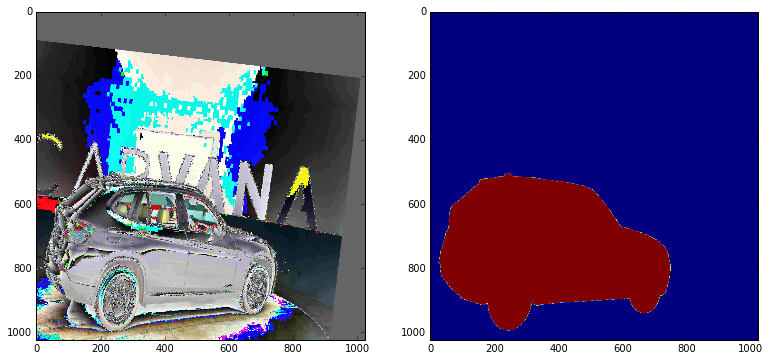

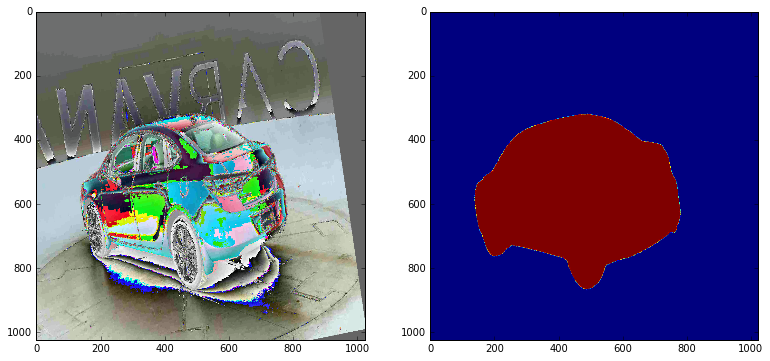

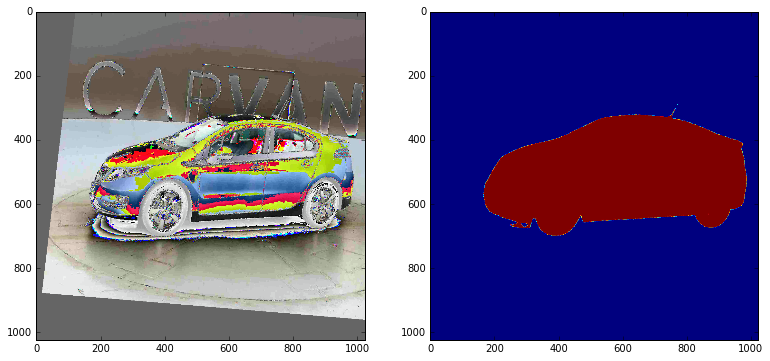

In [29]:
import matplotlib.pyplot as plt

for i in np.arange(0,5):
    plt.figure(figsize=(20, 10))
    plt.subplot(131)
    plt.imshow(imgs[i])
    plt.subplot(132)
    plt.imshow(labels[i,:,:,0])
    plt.show()

# Test 1024x2048 model

In [1]:
import os
from glob import glob
import tensorflow as tf
from skimage.transform import resize
from skimage.io import imsave
import numpy as np
from keras.models import Model
from keras.layers import Input, concatenate, Conv2D, MaxPooling2D, Conv2DTranspose, UpSampling2D, Cropping2D, Activation
# from keras.layers import Input, merge, Convolution2D, MaxPooling2D, UpSampling2D, Reshape, core, Dropout
from keras.optimizers import Adam,RMSprop
from keras.callbacks import ModelCheckpoint
from keras import backend as K
K.set_image_data_format('channels_last')  # TF dimension ordering in this code
from keras.layers.normalization import BatchNormalization
from keras.preprocessing import image, sequence
from keras.preprocessing.image import ImageDataGenerator
from keras import backend as K
K.set_image_dim_ordering('tf')
from keras.losses import binary_crossentropy
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint, TensorBoard, CSVLogger
import multiprocessing
import time
import collections
import sys
import signal
from keras.backend.tensorflow_backend import set_session
import cv2
from tools.clr_callback import *
from tools.multi_gpu import *


# config = tf.ConfigProto()
# config.gpu_options.per_process_gpu_memory_fraction = 0.95
# set_session(tf.Session(config=config))

batch_size = 2 * 3
smooth = 1.
sample_mean = 160.8
sample_std = 61.4
target_size = 1024

DATA = 'data/'
TRAIN = os.path.join(DATA, "train")
TRAIN_MASKS = os.path.join(DATA, "train_masks")
VALID = os.path.join(DATA, "valid")
VALID_MASKS = os.path.join(DATA, "valid_masks")


def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def bce_dice_loss(y_true, y_pred):
    return 0.5 * binary_crossentropy(y_true, y_pred) - dice_coef(y_true, y_pred)

def train_data_centering(image):
    return (image-sample_mean)/sample_std

def randomHueSaturationValue(image, hue_shift_limit=(-180, 180),
                             sat_shift_limit=(-255, 255),
                             val_shift_limit=(-255, 255), u=0.5):
    
    image = image.astype(np.float32)
    if np.random.random() < u:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(image)
        hue_shift = np.random.uniform(hue_shift_limit[0], hue_shift_limit[1])
        h = cv2.add(h, hue_shift)
        sat_shift = np.random.uniform(sat_shift_limit[0], sat_shift_limit[1])
        s = cv2.add(s, sat_shift)
        val_shift = np.random.uniform(val_shift_limit[0], val_shift_limit[1])
        v = cv2.add(v, val_shift)
        image = cv2.merge((h, s, v))
        image = cv2.cvtColor(image, cv2.COLOR_HSV2BGR)

    return image

def hue_transform(image):
    image = randomHueSaturationValue(image,
                                   hue_shift_limit=(-50, 50),
                                   sat_shift_limit=(-5, 5),
                                   val_shift_limit=(-15, 15))
    return image/255

def mask_data_centering(image):   
    return image/255

# The original class can be imported like this:
# from keras.preprocessing.image import ImageDataGenerator
# We access the modified version through T.ImageDataGenerator
import tools.image as T
# Useful for checking the output of the generators after code change
try:
    from importlib import reload
    reload(T)
except:
    reload(T)

def init_worker():
    signal.signal(signal.SIGINT, signal.SIG_IGN)
    
def get_unet_1024(input_shape=(1024, 1024*2, 3),num_classes=1):
    inputs = Input(shape=input_shape)
    # 1024

    down0b = Conv2D(8, (3, 3), padding='same')(inputs)
    down0b = BatchNormalization()(down0b)
    down0b = Activation('relu')(down0b)
    down0b = Conv2D(8, (3, 3), padding='same')(down0b)
    down0b = BatchNormalization()(down0b)
    down0b = Activation('relu')(down0b)
    down0b_pool = MaxPooling2D((2, 2*2), strides=(2, 2))(down0b)
    # 512

    down0a = Conv2D(16, (3, 3), padding='same')(down0b_pool)
    down0a = BatchNormalization()(down0a)
    down0a = Activation('relu')(down0a)
    down0a = Conv2D(16, (3, 3), padding='same')(down0a)
    down0a = BatchNormalization()(down0a)
    down0a = Activation('relu')(down0a)
    down0a_pool = MaxPooling2D((2, 2), strides=(2, 2))(down0a)
    # 256

    down0 = Conv2D(32, (3, 3), padding='same')(down0a_pool)
    down0 = BatchNormalization()(down0)
    down0 = Activation('relu')(down0)
    down0 = Conv2D(32, (3, 3), padding='same')(down0)
    down0 = BatchNormalization()(down0)
    down0 = Activation('relu')(down0)
    down0_pool = MaxPooling2D((2, 2), strides=(2, 2))(down0)
    # 128

    down1 = Conv2D(64, (3, 3), padding='same')(down0_pool)
    down1 = BatchNormalization()(down1)
    down1 = Activation('relu')(down1)
    down1 = Conv2D(64, (3, 3), padding='same')(down1)
    down1 = BatchNormalization()(down1)
    down1 = Activation('relu')(down1)
    down1_pool = MaxPooling2D((2, 2), strides=(2, 2))(down1)
    # 64

    down2 = Conv2D(128, (3, 3), padding='same')(down1_pool)
    down2 = BatchNormalization()(down2)
    down2 = Activation('relu')(down2)
    down2 = Conv2D(128, (3, 3), padding='same')(down2)
    down2 = BatchNormalization()(down2)
    down2 = Activation('relu')(down2)
    down2_pool = MaxPooling2D((2, 2), strides=(2, 2))(down2)
    # 32

    down3 = Conv2D(256, (3, 3), padding='same')(down2_pool)
    down3 = BatchNormalization()(down3)
    down3 = Activation('relu')(down3)
    down3 = Conv2D(256, (3, 3), padding='same')(down3)
    down3 = BatchNormalization()(down3)
    down3 = Activation('relu')(down3)
    down3_pool = MaxPooling2D((2, 2), strides=(2, 2))(down3)
    # 16

    down4 = Conv2D(512, (3, 3), padding='same')(down3_pool)
    down4 = BatchNormalization()(down4)
    down4 = Activation('relu')(down4)
    down4 = Conv2D(512, (3, 3), padding='same')(down4)
    down4 = BatchNormalization()(down4)
    down4 = Activation('relu')(down4)
    down4_pool = MaxPooling2D((2, 2), strides=(2, 2))(down4)
    # 8

    center = Conv2D(1024, (3, 3), padding='same')(down4_pool)
    center = BatchNormalization()(center)
    center = Activation('relu')(center)
    center = Conv2D(1024, (3, 3), padding='same')(center)
    center = BatchNormalization()(center)
    center = Activation('relu')(center)
    # center

    up4 = UpSampling2D((2, 2))(center)
    up4 = concatenate([down4, up4], axis=3)
    up4 = Conv2D(512, (3, 3), padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    up4 = Conv2D(512, (3, 3), padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    up4 = Conv2D(512, (3, 3), padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    # 16

    up3 = UpSampling2D((2, 2))(up4)
    up3 = concatenate([down3, up3], axis=3)
    up3 = Conv2D(256, (3, 3), padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    up3 = Conv2D(256, (3, 3), padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    up3 = Conv2D(256, (3, 3), padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    # 32

    up2 = UpSampling2D((2, 2))(up3)
    up2 = concatenate([down2, up2], axis=3)
    up2 = Conv2D(128, (3, 3), padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    up2 = Conv2D(128, (3, 3), padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    up2 = Conv2D(128, (3, 3), padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    # 64

    up1 = UpSampling2D((2, 2))(up2)
    up1 = concatenate([down1, up1], axis=3)
    up1 = Conv2D(64, (3, 3), padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    up1 = Conv2D(64, (3, 3), padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    up1 = Conv2D(64, (3, 3), padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    # 128

    up0 = UpSampling2D((2, 2))(up1)
    up0 = concatenate([down0, up0], axis=3)
    up0 = Conv2D(32, (3, 3), padding='same')(up0)
    up0 = BatchNormalization()(up0)
    up0 = Activation('relu')(up0)
    up0 = Conv2D(32, (3, 3), padding='same')(up0)
    up0 = BatchNormalization()(up0)
    up0 = Activation('relu')(up0)
    up0 = Conv2D(32, (3, 3), padding='same')(up0)
    up0 = BatchNormalization()(up0)
    up0 = Activation('relu')(up0)
    # 256

    up0a = UpSampling2D((2, 2))(up0)
    up0a = concatenate([down0a, up0a], axis=3)
    up0a = Conv2D(16, (3, 3), padding='same')(up0a)
    up0a = BatchNormalization()(up0a)
    up0a = Activation('relu')(up0a)
    up0a = Conv2D(16, (3, 3), padding='same')(up0a)
    up0a = BatchNormalization()(up0a)
    up0a = Activation('relu')(up0a)
    up0a = Conv2D(16, (3, 3), padding='same')(up0a)
    up0a = BatchNormalization()(up0a)
    up0a = Activation('relu')(up0a)
    # 512

    up0b = UpSampling2D((2, 2*2))(up0a)
    up0b = concatenate([down0b, up0b], axis=3)
    up0b = Conv2D(8, (3, 3), padding='same')(up0b)
    up0b = BatchNormalization()(up0b)
    up0b = Activation('relu')(up0b)
    up0b = Conv2D(8, (3, 3), padding='same')(up0b)
    up0b = BatchNormalization()(up0b)
    up0b = Activation('relu')(up0b)
    up0b = Conv2D(8, (3, 3), padding='same')(up0b)
    up0b = BatchNormalization()(up0b)
    up0b = Activation('relu')(up0b)
    # 1024

    classify = Conv2D(num_classes, (1, 1), activation='sigmoid')(up0b)

    model = Model(inputs=inputs, outputs=classify)

    model.compile(optimizer=RMSprop(lr=0.0001), loss=bce_dice_loss, metrics=['accuracy', dice_coef])

    return model

def get_generator(train_folder,
                    train_mask_folder,
                    valid_folder,
                    valid_mask_folder,
                    target_size,                  
                    width_shift_range=0.1,
                    height_shift_range=0.1,
                    horizontal_flip=True,
                    zca_whitening=False,
                    channel_shift_range=0.,
                    rotation_range=0,
                    zoom_range=0.1,
                    classes=['fold_1','fold_2','fold_3'],
                    fill_mode="constant",
                    batch_size=4,
                    processes=4):
    
    seed = 42
    global pool
    try:
        pool.terminate()
    except:
        pass

    if processes: 
        pool = multiprocessing.Pool(processes=processes, initializer=init_worker)
    else:
        pool = None
        
    # Example taken from https://keras.io/preprocessing/image/
    # We create two instances with the same arguments
    data_gen_args_train = dict(
                        width_shift_range=width_shift_range,
                        height_shift_range=height_shift_range,
                        horizontal_flip=horizontal_flip,
                        rotation_range=rotation_range,
                        zoom_range=zoom_range,
                        preprocessing_function=train_data_centering,
                        fill_mode=fill_mode, 
                        zca_whitening = zca_whitening,
                        channel_shift_range = channel_shift_range,
                        cval=0,
                        pool=pool        
                        )

    data_gen_args_masks = dict(
                        width_shift_range=width_shift_range,
                        height_shift_range=height_shift_range,
                        horizontal_flip=horizontal_flip,
                        rotation_range=rotation_range,
                        zoom_range=zoom_range,
                        preprocessing_function=mask_data_centering,
                        fill_mode=fill_mode,
                        cval=0,
                        pool=pool         
                        )    
    
    image_datagen = T.ImageDataGenerator(**data_gen_args_train)
    # image_datagen.fit(data_sample)    
    mask_datagen = T.ImageDataGenerator(**data_gen_args_masks)

    image_generator = image_datagen.flow_from_directory(
        train_folder,
        batch_size = batch_size,
        target_size = (target_size, target_size*2),
        class_mode=None,
        color_mode='rgb',
        classes=classes,
        seed=seed)
    
    mask_generator = mask_datagen.flow_from_directory(
        train_mask_folder,
        batch_size = batch_size,    
        target_size = (target_size, target_size*2),    
        class_mode=None,
        color_mode='grayscale',
        classes=classes,
        seed=seed)

    valid_image_generator = image_datagen.flow_from_directory(
        valid_folder,
        batch_size = batch_size,
        target_size = (target_size, target_size*2),
        class_mode=None,
        color_mode='rgb',
        classes=classes,
        seed=seed)
    
    valid_mask_generator = mask_datagen.flow_from_directory(
        valid_mask_folder,
        batch_size = batch_size,    
        target_size = (target_size, target_size*2),    
        class_mode=None,
        color_mode='grayscale',
        classes=classes,
        seed=seed)
    # combine generators into one which yields image and masks
    train_generator = zip(image_generator, mask_generator)
    valid_generator = zip(valid_image_generator, valid_mask_generator)

    return train_generator,valid_generator

train_generator,valid_generator = get_generator(
                    train_folder = TRAIN,
                    train_mask_folder = TRAIN_MASKS,
                    valid_folder = VALID,
                    valid_mask_folder = VALID_MASKS,    
                    width_shift_range=0.1,
                    height_shift_range=0.1,
                    horizontal_flip=True,
                    rotation_range=0.0,
                    zoom_range=0.1,
                    channel_shift_range=0.,
                    fill_mode="constant",
                    batch_size=batch_size,
                    target_size=target_size,
                    processes = batch_size
                    )

clr = CyclicLR(base_lr=1e-6, max_lr=1e-4,
                    step_size=5000., mode='exp_range',
                    gamma=0.99994)

callbacks = [EarlyStopping(monitor='val_dice_coef',
                           patience=8,
                           verbose=1,
                           min_delta=1e-4,
                           mode='max'),
             ReduceLROnPlateau(monitor='val_dice_coef',
                               factor=0.1,
                               patience=4,
                               verbose=1,
                               epsilon=1e-4,
                               mode='max'),
             ModelCheckpoint(monitor='val_dice_coef',
                             filepath='1024_unet_3_gpu.h5',
                             save_best_only=True,
                             save_weights_only=False,
                             mode='max'),
             # TensorBoard(log_dir='logs'),
             CSVLogger('last_training_log_hue_low_aug.csv', separator=',', append=False)
             # clr
            ]

model = get_unet_1024()
model = make_parallel(model, gpu_count=3)
model.compile(optimizer=RMSprop(lr=0.0001), loss=bce_dice_loss, metrics=['accuracy', dice_coef])
# model.load_weights('1024_unet_hue_low_aug.h5')
# model_checkpoint = ModelCheckpoint('new_unet_lr_decay_b4_add_train_test.h5', monitor='val_loss', save_best_only=True)

# flip train and valid generators
model.fit_generator(
            generator=valid_generator,
            steps_per_epoch=10176/batch_size,
            epochs=50,
            validation_data = train_generator,
            callbacks=callbacks,
            validation_steps = 5088/batch_size
        )



Using TensorFlow backend.


Found 10176 images belonging to 3 classes.
Found 10176 images belonging to 3 classes.
Found 5088 images belonging to 3 classes.
Found 5088 images belonging to 3 classes.


ValueError: `Concatenate` layer requires inputs with matching shapes except for the concat axis. Got inputs shapes: [(None, 16, 31, 512), (None, 16, 30, 1024)]

In [5]:
model = get_unet_1024()

In [4]:
def get_unet_1024(input_shape=(1024, 1024*2, 3),num_classes=1):
    inputs = Input(shape=input_shape)
    # 1024

    down0b = Conv2D(8, (3, 3), padding='same')(inputs)
    down0b = BatchNormalization()(down0b)
    down0b = Activation('relu')(down0b)
    down0b = Conv2D(8, (3, 3), padding='same')(down0b)
    down0b = BatchNormalization()(down0b)
    down0b = Activation('relu')(down0b)
    down0b_pool = MaxPooling2D((2, 2*2), strides=(2, 2*2))(down0b)
    # 512

    down0a = Conv2D(16, (3, 3), padding='same')(down0b_pool)
    down0a = BatchNormalization()(down0a)
    down0a = Activation('relu')(down0a)
    down0a = Conv2D(16, (3, 3), padding='same')(down0a)
    down0a = BatchNormalization()(down0a)
    down0a = Activation('relu')(down0a)
    down0a_pool = MaxPooling2D((2, 2), strides=(2, 2))(down0a)
    # 256

    down0 = Conv2D(32, (3, 3), padding='same')(down0a_pool)
    down0 = BatchNormalization()(down0)
    down0 = Activation('relu')(down0)
    down0 = Conv2D(32, (3, 3), padding='same')(down0)
    down0 = BatchNormalization()(down0)
    down0 = Activation('relu')(down0)
    down0_pool = MaxPooling2D((2, 2), strides=(2, 2))(down0)
    # 128

    down1 = Conv2D(64, (3, 3), padding='same')(down0_pool)
    down1 = BatchNormalization()(down1)
    down1 = Activation('relu')(down1)
    down1 = Conv2D(64, (3, 3), padding='same')(down1)
    down1 = BatchNormalization()(down1)
    down1 = Activation('relu')(down1)
    down1_pool = MaxPooling2D((2, 2), strides=(2, 2))(down1)
    # 64

    down2 = Conv2D(128, (3, 3), padding='same')(down1_pool)
    down2 = BatchNormalization()(down2)
    down2 = Activation('relu')(down2)
    down2 = Conv2D(128, (3, 3), padding='same')(down2)
    down2 = BatchNormalization()(down2)
    down2 = Activation('relu')(down2)
    down2_pool = MaxPooling2D((2, 2), strides=(2, 2))(down2)
    # 32

    down3 = Conv2D(256, (3, 3), padding='same')(down2_pool)
    down3 = BatchNormalization()(down3)
    down3 = Activation('relu')(down3)
    down3 = Conv2D(256, (3, 3), padding='same')(down3)
    down3 = BatchNormalization()(down3)
    down3 = Activation('relu')(down3)
    down3_pool = MaxPooling2D((2, 2), strides=(2, 2))(down3)
    # 16

    down4 = Conv2D(512, (3, 3), padding='same')(down3_pool)
    down4 = BatchNormalization()(down4)
    down4 = Activation('relu')(down4)
    down4 = Conv2D(512, (3, 3), padding='same')(down4)
    down4 = BatchNormalization()(down4)
    down4 = Activation('relu')(down4)
    down4_pool = MaxPooling2D((2, 2), strides=(2, 2))(down4)
    # 8

    center = Conv2D(1024, (3, 3), padding='same')(down4_pool)
    center = BatchNormalization()(center)
    center = Activation('relu')(center)
    center = Conv2D(1024, (3, 3), padding='same')(center)
    center = BatchNormalization()(center)
    center = Activation('relu')(center)
    # center

    up4 = UpSampling2D((2, 2))(center)
    up4 = concatenate([down4, up4], axis=3)
    up4 = Conv2D(512, (3, 3), padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    up4 = Conv2D(512, (3, 3), padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    up4 = Conv2D(512, (3, 3), padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    # 16

    up3 = UpSampling2D((2, 2))(up4)
    up3 = concatenate([down3, up3], axis=3)
    up3 = Conv2D(256, (3, 3), padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    up3 = Conv2D(256, (3, 3), padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    up3 = Conv2D(256, (3, 3), padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    # 32

    up2 = UpSampling2D((2, 2))(up3)
    up2 = concatenate([down2, up2], axis=3)
    up2 = Conv2D(128, (3, 3), padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    up2 = Conv2D(128, (3, 3), padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    up2 = Conv2D(128, (3, 3), padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    # 64

    up1 = UpSampling2D((2, 2))(up2)
    up1 = concatenate([down1, up1], axis=3)
    up1 = Conv2D(64, (3, 3), padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    up1 = Conv2D(64, (3, 3), padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    up1 = Conv2D(64, (3, 3), padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    # 128

    up0 = UpSampling2D((2, 2))(up1)
    up0 = concatenate([down0, up0], axis=3)
    up0 = Conv2D(32, (3, 3), padding='same')(up0)
    up0 = BatchNormalization()(up0)
    up0 = Activation('relu')(up0)
    up0 = Conv2D(32, (3, 3), padding='same')(up0)
    up0 = BatchNormalization()(up0)
    up0 = Activation('relu')(up0)
    up0 = Conv2D(32, (3, 3), padding='same')(up0)
    up0 = BatchNormalization()(up0)
    up0 = Activation('relu')(up0)
    # 256

    up0a = UpSampling2D((2, 2))(up0)
    up0a = concatenate([down0a, up0a], axis=3)
    up0a = Conv2D(16, (3, 3), padding='same')(up0a)
    up0a = BatchNormalization()(up0a)
    up0a = Activation('relu')(up0a)
    up0a = Conv2D(16, (3, 3), padding='same')(up0a)
    up0a = BatchNormalization()(up0a)
    up0a = Activation('relu')(up0a)
    up0a = Conv2D(16, (3, 3), padding='same')(up0a)
    up0a = BatchNormalization()(up0a)
    up0a = Activation('relu')(up0a)
    # 512

    up0b = UpSampling2D((2, 2*2))(up0a)
    up0b = concatenate([down0b, up0b], axis=3)
    up0b = Conv2D(8, (3, 3), padding='same')(up0b)
    up0b = BatchNormalization()(up0b)
    up0b = Activation('relu')(up0b)
    up0b = Conv2D(8, (3, 3), padding='same')(up0b)
    up0b = BatchNormalization()(up0b)
    up0b = Activation('relu')(up0b)
    up0b = Conv2D(8, (3, 3), padding='same')(up0b)
    up0b = BatchNormalization()(up0b)
    up0b = Activation('relu')(up0b)
    # 1024

    classify = Conv2D(num_classes, (1, 1), activation='sigmoid')(up0b)

    model = Model(inputs=inputs, outputs=classify)

    model.compile(optimizer=RMSprop(lr=0.0001), loss=bce_dice_loss, metrics=['accuracy', dice_coef])

    return model


# Test the dynamic generator wo augmentation

In [12]:
import cv2
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split

input_size = 1024
sample_mean = 160.8
sample_std = 61.4

df_train = pd.read_csv('data/train_masks.csv')
ids_train = list(set(df_train['img'].map(lambda s: s.split('.')[0][:-3])))
batch_size = 16
car_angle = 1

ids_train_split, ids_valid_split = train_test_split(ids_train, test_size=0.2, random_state=42)

In [75]:
int(np.ceil(len(ids_valid_split)/batch_size))

4

In [6]:
(ids_valid_split).shape

(1018,)

In [35]:
!ls -ls data/train_masks/*.png | head

4 -rw-r--r-- 1 root root 2930 авг 24 11:02 data/train_masks/00087a6bd4dc_01_mask.png
4 -rw-r--r-- 1 root root 3259 авг 24 11:02 data/train_masks/00087a6bd4dc_02_mask.png
4 -rw-r--r-- 1 root root 3861 авг 24 11:02 data/train_masks/00087a6bd4dc_03_mask.png
4 -rw-r--r-- 1 root root 4092 авг 24 11:02 data/train_masks/00087a6bd4dc_04_mask.png
4 -rw-r--r-- 1 root root 3856 авг 24 11:02 data/train_masks/00087a6bd4dc_05_mask.png
4 -rw-r--r-- 1 root root 3911 авг 24 11:02 data/train_masks/00087a6bd4dc_06_mask.png
4 -rw-r--r-- 1 root root 3796 авг 24 11:02 data/train_masks/00087a6bd4dc_07_mask.png
4 -rw-r--r-- 1 root root 3505 авг 24 11:02 data/train_masks/00087a6bd4dc_08_mask.png
4 -rw-r--r-- 1 root root 2740 авг 24 11:02 data/train_masks/00087a6bd4dc_09_mask.png
4 -rw-r--r-- 1 root root 3258 авг 24 11:02 data/train_masks/00087a6bd4dc_10_mask.png
ls: write error: Broken pipe


In [38]:
for i in range(1,17):
    print (str(i).zfill(2))
    angle = str(i).zfill(2)
    path = ('data/train_masks/*_{}_mask.png').format(angle)
    !ls -ls $path | wc -l

01
318
02
318
03
318
04
318
05
318
06
318
07
318
08
318
09
318
10
318
11
318
12
318
13
318
14
318
15
318
16
318


In [32]:
for i in range(1,17):
    print (str(i).zfill(2))
    angle = str(i).zfill(2)
    path = ('data/train/*_{}.jpg').format(angle)
    !ls -ls $path | wc -l


01
318
02
318
03
318
04
318
05
318
06
318
07
318
08
318
09
318
10
318
11
318
12
318
13
318
14
318
15
318
16
318


In [13]:
car_angle = 1

def train_generator():
    while True:
        for start in range(0, len(ids_train_split), batch_size):
            x_batch = []
            y_batch = []
            end = min(start + batch_size, len(ids_train_split))
            ids_train_batch = ids_train_split[start:end]
            for id in ids_train_batch:
                img = cv2.imread('data/train/{}_{}.jpg'.format(id,str(car_angle).zfill(2)))
                img = cv2.resize(img, (input_size, input_size))
                mask = cv2.imread('data/train_masks/{}_{}_mask.png'.format(id,str(car_angle).zfill(2)), cv2.IMREAD_GRAYSCALE)
                mask = cv2.resize(mask, (input_size, input_size))
                mask = np.expand_dims(mask, axis=2)
                x_batch.append(img)
                y_batch.append(mask)
            x_batch = (np.array(x_batch, np.float32) - sample_mean) / sample_std
            y_batch = np.array(y_batch, np.float32) / 255
            yield x_batch, y_batch


def valid_generator():
    while True:
        for start in range(0, len(ids_valid_split), batch_size):
            x_batch = []
            y_batch = []
            end = min(start + batch_size, len(ids_valid_split))
            ids_valid_batch = ids_valid_split[start:end]
            for id in ids_valid_batch:
                img = cv2.imread('data/train/{}_{}.jpg'.format(id,str(car_angle).zfill(2)))
                img = cv2.resize(img, (input_size, input_size))
                mask = cv2.imread('data/train_masks/{}_{}_mask.png'.format(id,str(car_angle).zfill(2)), cv2.IMREAD_GRAYSCALE)
                mask = cv2.resize(mask, (input_size, input_size))
                mask = np.expand_dims(mask, axis=2)
                x_batch.append(img)
                y_batch.append(mask)
            x_batch = (np.array(x_batch, np.float32) - sample_mean) / sample_std
            y_batch = np.array(y_batch, np.float32) / 255
            yield x_batch, y_batch            
            
train_gen = train_generator()
valid_gen = valid_generator()

imgs, labels = next(train_gen)
v_imgs, v_labels = next(valid_gen)

In [15]:
imgs.shape

(16, 1024, 1024, 3)

In [16]:
labels.shape

(16, 1024, 1024, 1)

In [ ]:
from tensorflow.python.client import device_lib

def get_available_gpus():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos if x.device_type == 'GPU']

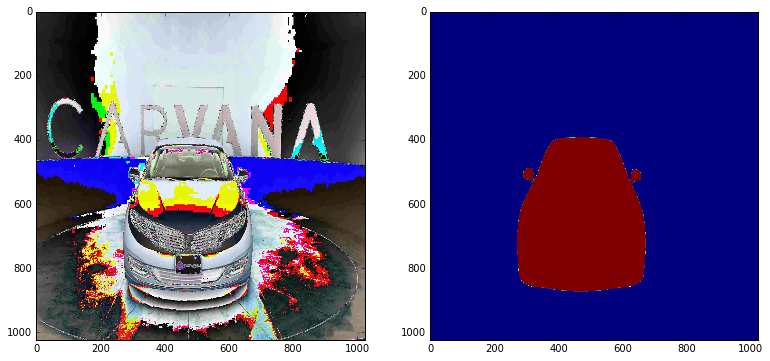

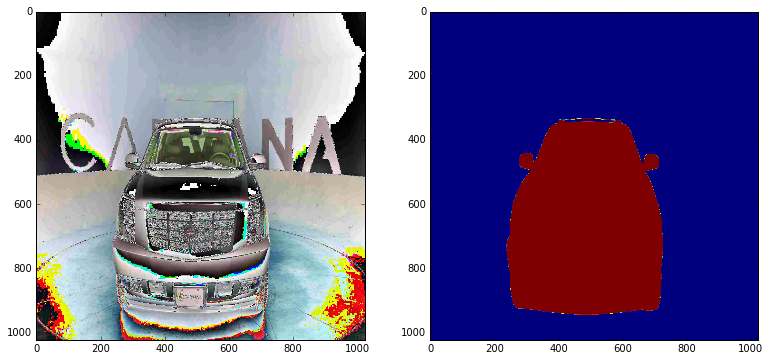

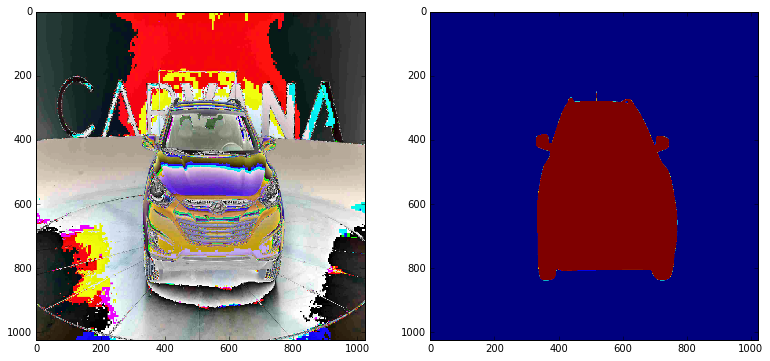

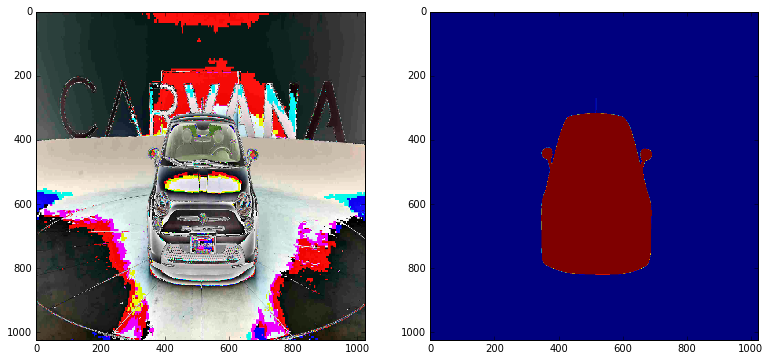

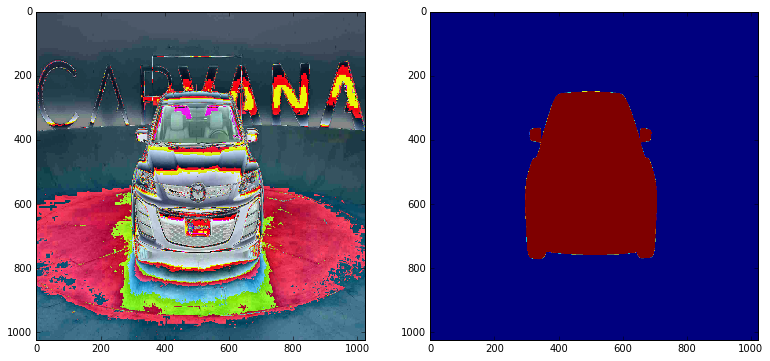

In [17]:
import matplotlib.pyplot as plt

for i in np.arange(0,5):
    plt.figure(figsize=(20, 10))
    plt.subplot(131)
    plt.imshow(imgs[i])
    plt.subplot(132)
    plt.imshow(labels[i,:,:,0])
    plt.show()

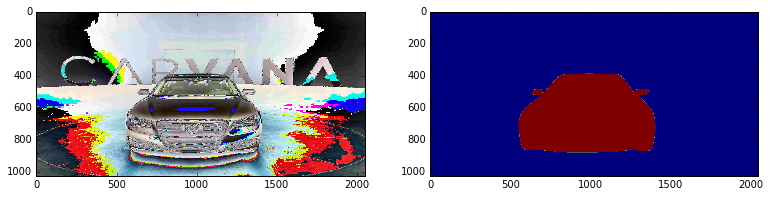

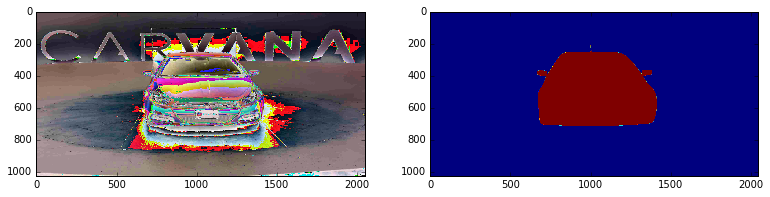

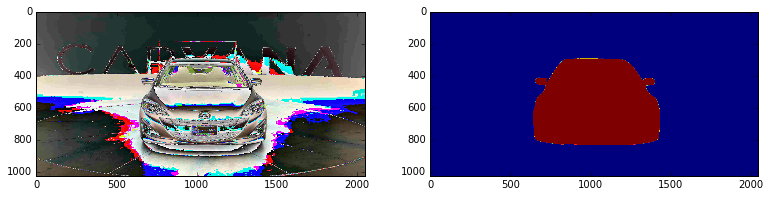

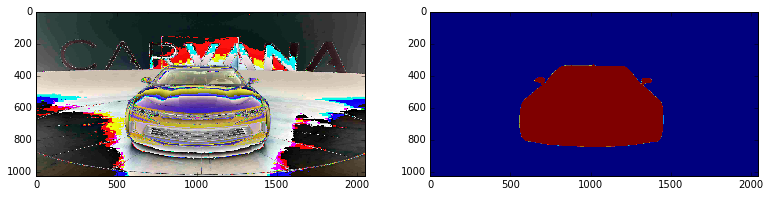

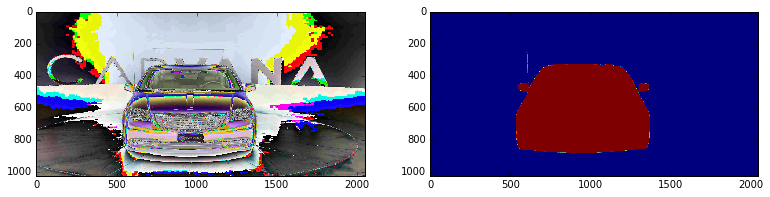

In [72]:
import matplotlib.pyplot as plt

for i in np.arange(0,5):
    plt.figure(figsize=(20, 10))
    plt.subplot(131)
    plt.imshow(v_imgs[i])
    plt.subplot(132)
    plt.imshow(v_labels[i,:,:,0])
    plt.show()

# Plot chart

In [38]:

df.tail()

,dice_coef,val_dice_coef
11,0.997792,0.997452
12,0.997856,0.997491
13,0.997918,0.994587
14,0.997970,0.997564
15,0.998017,0.997628


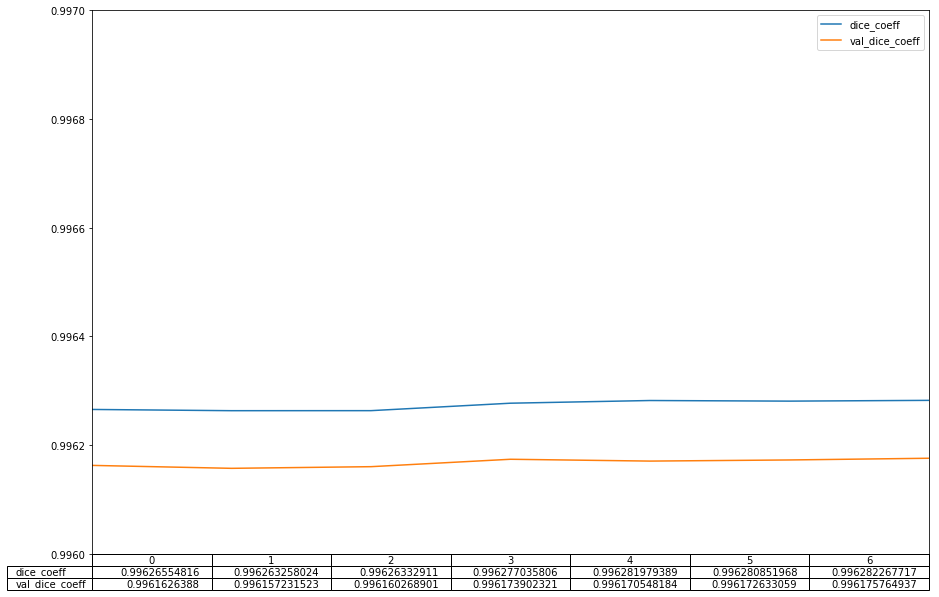

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

df = pd.read_csv('logs/1024_unet_add_train_clr.csv')
df = df[['dice_coeff','val_dice_coeff']]

fig, ax = plt.subplots(1, 1)
ax.get_xaxis().set_visible(False)  
df.plot(ax=ax, ylim=(0.996, 0.997), table=True, figsize=(15, 10))
plt.show()

In [12]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

df = pd.read_csv('logs/1024_unet_selu.csv')
df = df[['dice_coeff','val_dice_coeff']]

fig, ax = plt.subplots(1, 1)
ax.get_xaxis().set_visible(False)  
df.plot(ax=ax, ylim=(0.8, 0.998), table=True, figsize=(15, 10))
plt.show()

EmptyDataError: No columns to parse from file

In [3]:
df

,dice_coef,val_dice_coef
0,0.998097,0.997737
1,0.998149,0.997753
2,0.998183,0.997760


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

df = pd.read_csv('1024_unet_add_low_aug_test_3_gpu.csv')
df = df[['dice_coef','val_dice_coef']]

fig, ax = plt.subplots(1, 1)
ax.get_xaxis().set_visible(False)  
df.plot(ax=ax, ylim=(0.996, 0.997), table=True, figsize=(15, 10))
plt.show()

In [14]:
!ls logs/*.csv

logs/1024_unet_add_train_clr.csv  logs/1024_unet_selu.csv
logs/1024_unet_selu_clr.csv


In [16]:
df = pd.read_csv('logs/1024_unet_selu.csv')
df = df[['dice_coeff','val_dice_coeff']]
df

,dice_coeff,val_dice_coeff
0,0.994784,0.995098
1,0.994903,0.992042
2,0.995010,0.994842
3,0.995061,0.995194
4,0.995135,0.995190
5,0.995185,0.995280
6,0.995248,0.994941
7,0.995290,0.994417
8,0.995379,0.995451
9,0.995400,0.995439


In [15]:
import pandas as pd


df = pd.read_csv('logs/1024_unet_add_train_clr.csv')
df = df[['dice_coeff','val_dice_coeff']]
df



,dice_coeff,val_dice_coeff
0,0.996266,0.996163
1,0.996263,0.996157
2,0.996263,0.996160
3,0.996277,0.996174
4,0.996282,0.996171
5,0.996281,0.996173
6,0.996282,0.996176


In [ ]:
from bokeh.plotting import figure, output_file, show
from bokeh.io import output_notebook, push_notebook, show
from bokeh.layouts import row
import numpy as np
import pandas as pd
from bokeh.models import HoverTool

In [47]:
output_notebook()
    
for car_angle in range(1,15):
    
    file_name = ('Kaggle-Carvana-Image-Masking-Challenge/weights/best_weights_angle_{}.csv'.format(str(car_angle).zfill(2)))
    df = pd.read_csv(file_name)
    df = df[['dice_coeff','val_dice_coeff']]


    # prepare some data
    x = np.linspace(start = 1, stop = df.shape[0],num= df.shape[0])

    y1 = df['dice_coeff'].values * 1000
    y2 = df['val_dice_coeff'].values * 1000    
    
    if  car_angle==1:
        # create a new plot
        p = figure(
           tools='hover',
           y_range=[y2.min()*0.999, y2.max()*1.001], title="DICE coeff",
           x_axis_label='epochs', y_axis_label='accuracy'
        )

    # add some renderers
    p.line(x, y1, legend="dice_coeff {}".format(str(car_angle).zfill(2)), line_color="red")
    p.line(x, y2, legend="val_dice_coeff {}".format(str(car_angle).zfill(2)), line_color="orange", line_dash="4 4")

# show the results
show(row(p))

Loading BokehJS ...

In [116]:
for car_angle in range(1,17):
    try:
        file_name = ('weights/best_weights_selu_angle_ft_{}.csv'.format(str(car_angle).zfill(2)))
        df = pd.read_csv(file_name)
        df = df[['dice_coeff','val_dice_coeff']]

        file_name = ('weights/best_weights_angle_{}.csv'.format(str(car_angle).zfill(2)))
        df2 = pd.read_csv(file_name)
        df2 = df2[['dice_coeff','val_dice_coeff']]

        print (car_angle)
        print ('{} vs {}'.format(round(df.val_dice_coeff.max(),5), round(df2.val_dice_coeff.max(),5)))
    except:
        print(1)

1
0.99614 vs 0.99619
2
0.9966 vs 0.99654
3
0.99652 vs 0.99663
4
0.99608 vs 0.99602
5
0.9957 vs 0.99586
6
0.99609 vs 0.99615
7
0.9968 vs 0.99677
8
0.99661 vs 0.99659
9
0.99605 vs 0.99588
10
0.99646 vs 0.99653
11
0.99668 vs 0.99671
12
0.99623 vs 0.99622
13
0.99558 vs 0.99572
14
0.99593 vs 0.99617
15
0.99646 vs 0.99677
16
0.99671 vs 0.99674


In [108]:
for car_angle in range(1,17):
    file_name = ('weights/best_weights_angle_{}.csv'.format(str(car_angle).zfill(2)))
    df = pd.read_csv(file_name)
    df = df[['dice_coeff','val_dice_coeff']]
    print(car_angle)    
    print (round(df.val_dice_coeff.max(),5))

1
0.99619
2
0.99654
3
0.99663
4
0.99602
5
0.99586
6
0.99615
7
0.99677
8
0.99659
9
0.99588
10
0.99653
11
0.99671
12
0.99622
13
0.99572
14
0.99617
15
0.99677
16
0.99674


In [91]:
for car_angle in range(1,17):
    file_name = ('Kaggle-Carvana-Image-Masking-Challenge/weights/best_weights_angle_ft_{}.csv'.format(str(car_angle).zfill(2)))
    df = pd.read_csv(file_name)
    df = df[['dice_coeff','val_dice_coeff']]
    print (round(df.val_dice_coeff.max(),5))

0.99617
0.99642
0.99657
0.99606


FileNotFoundError: File b'Kaggle-Carvana-Image-Masking-Challenge/weights/best_weights_angle_ft_05.csv' does not exist

In [145]:
df = pd.read_csv('logs/1024_unet_look_corner.csv')
df

,epoch,loss,lr,merge_1_dice_coeff,merge_1_loss,merge_2_dice_coeff,merge_2_loss,merge_3_dice_coeff,merge_3_loss,merge_4_dice_coeff,...,val_merge_3_dice_coeff,val_merge_3_loss,val_merge_4_dice_coeff,val_merge_4_loss,val_merge_5_dice_coeff,val_merge_5_loss,val_merge_6_dice_coeff,val_merge_6_loss,val_merge_7_dice_coeff,val_merge_7_loss
0,0,1.041937,0.0001,0.004574,1.027824,0.004657,1.02093,0.003487,1.035833,0.00459,...,0.006618,1.00213,0.002096,1.011938,0.001981,1.011415,-0.000019,1.013417,0.337903,0.671251


# See which angles are worst and why

In [62]:
df_train = pd.read_csv('Kaggle-Carvana-Image-Masking-Challenge/input/train_masks.csv')
ids_train = list(set(df_train['img'].map(lambda s: s.split('.')[0][:-3])))
len(ids_train)

318

In [76]:
import matplotlib.pyplot as plt
%matplotlib inline
# utility for easy plot generation
def plots(ims,
          figsize=(12,6),
          rows=1,
          interp=False,
          titles=None):
    if type(ims[0]) is np.ndarray:
        ims = np.array(ims).astype(np.uint8)
        if (ims.shape[-1] != 3):
            ims = ims.transpose((0,2,3,1))
    f = plt.figure(figsize=figsize)
    for i in range(len(ims)):
        sp = f.add_subplot(rows, len(ims)//rows, i+1)
        if titles is not None:
            sp.set_title(titles[i], fontsize=18)
        plt.imshow(ims[i], interpolation=None if interp else 'none')

## Worst predictions

4
5
9
13


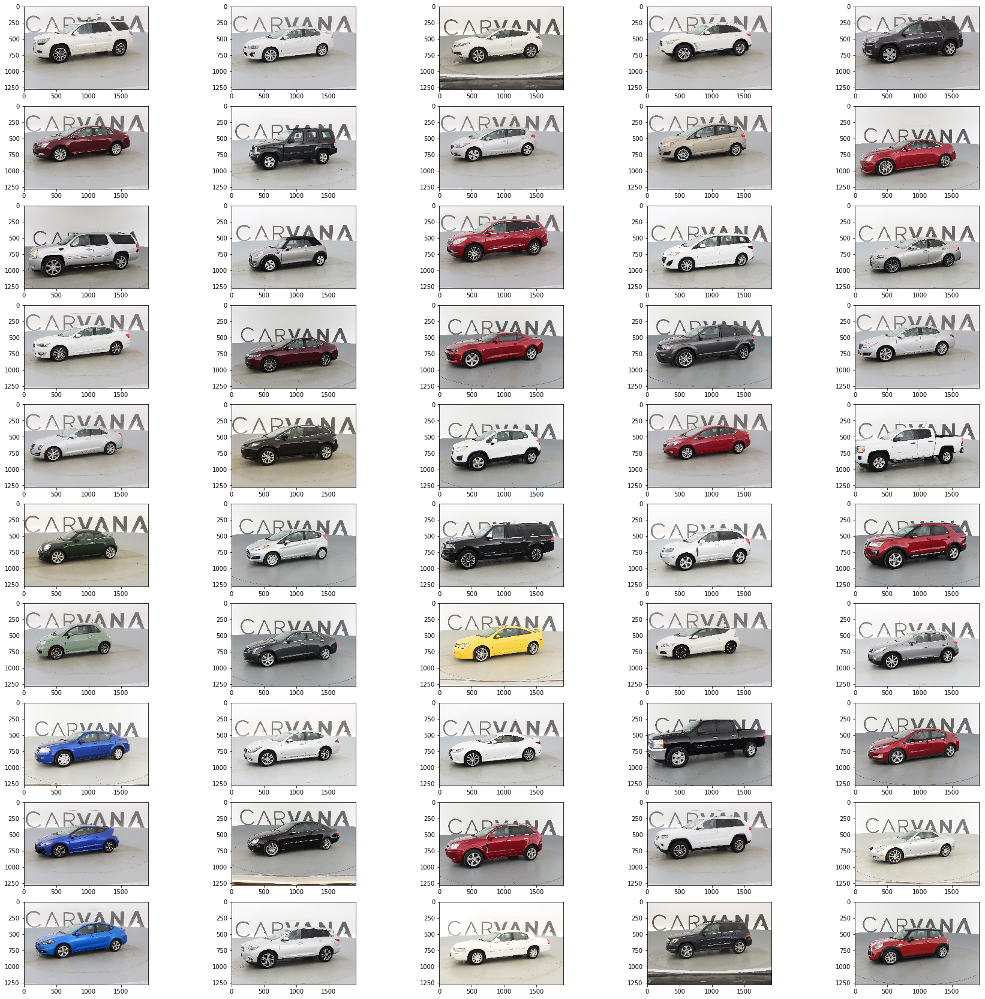

In [80]:
from numpy.random import shuffle
from skimage.io import imread

car_angle = 4
shuffle(ids_train)
imgs = [( imread('Kaggle-Carvana-Image-Masking-Challenge/input/train/{}_{}.jpg'.format(j,str(car_angle).zfill(2))) ) for j in ids_train[0:50]]
plots(imgs,figsize=(30,30),rows=10)

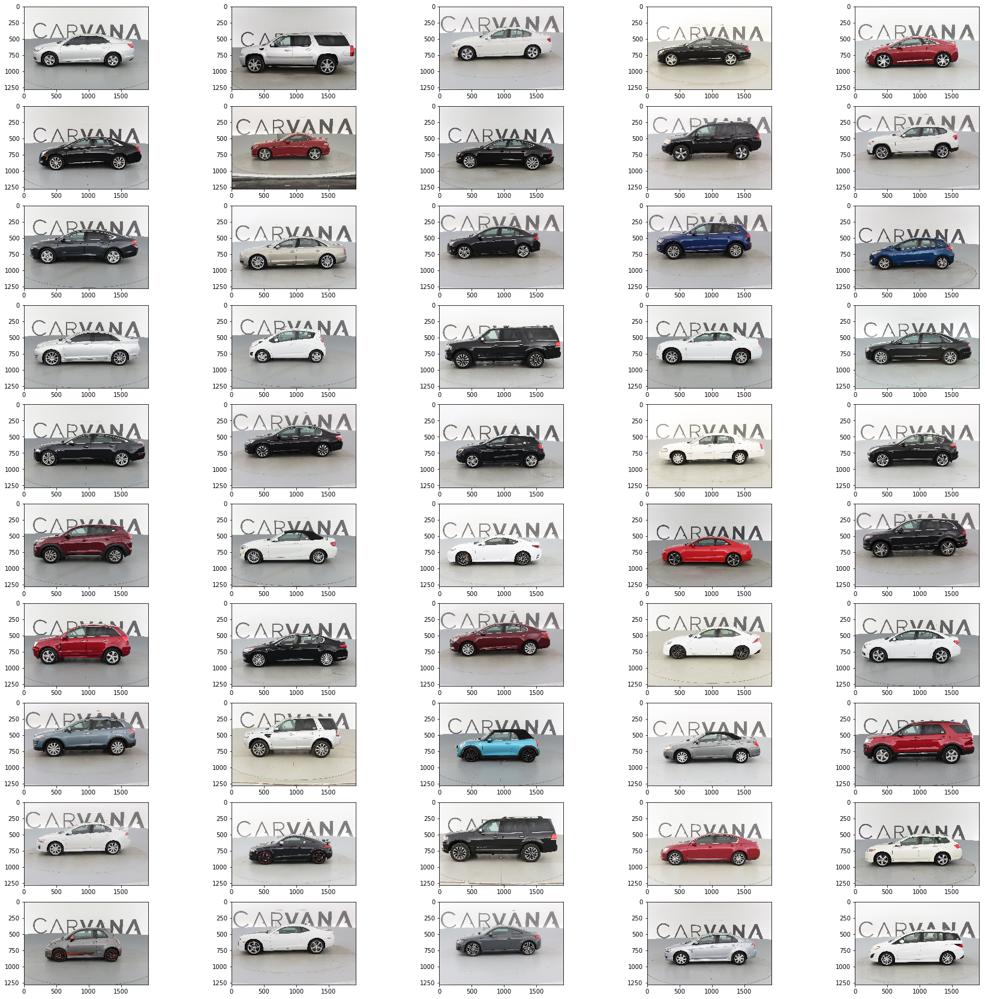

In [82]:
from numpy.random import shuffle
from skimage.io import imread

car_angle = 5
shuffle(ids_train)
imgs = [( imread('Kaggle-Carvana-Image-Masking-Challenge/input/train/{}_{}.jpg'.format(j,str(car_angle).zfill(2))) ) for j in ids_train[0:50]]
plots(imgs,figsize=(30,30),rows=10)

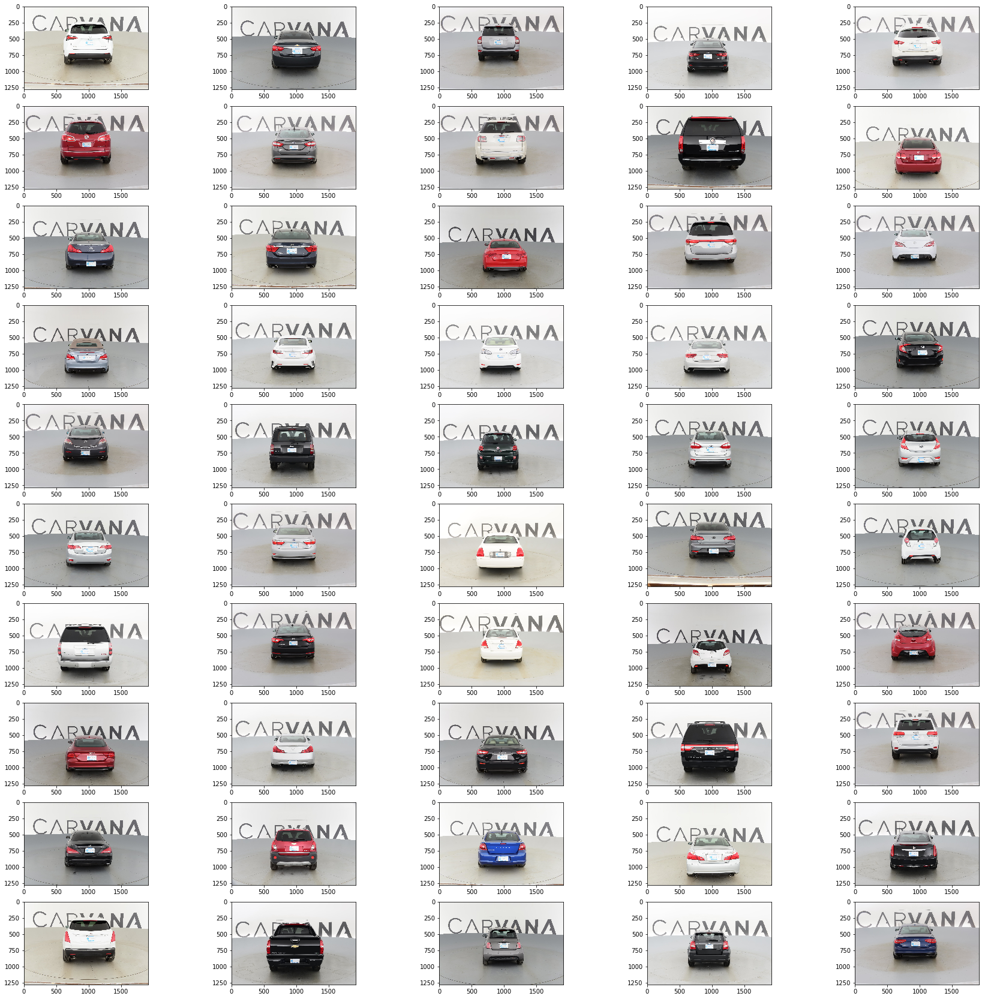

In [83]:
car_angle = 9
shuffle(ids_train)
imgs = [( imread('Kaggle-Carvana-Image-Masking-Challenge/input/train/{}_{}.jpg'.format(j,str(car_angle).zfill(2))) ) for j in ids_train[0:50]]
plots(imgs,figsize=(30,30),rows=10)

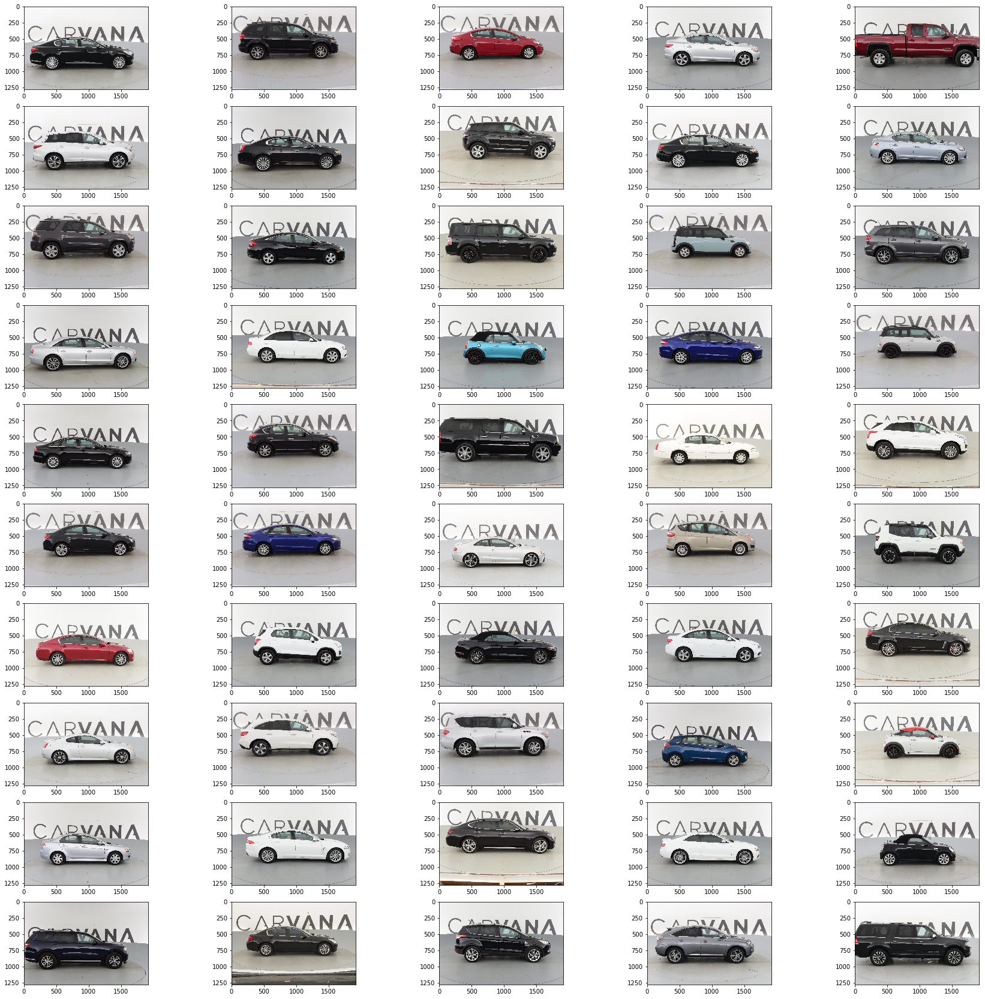

In [84]:
car_angle = 13
shuffle(ids_train)
imgs = [( imread('Kaggle-Carvana-Image-Masking-Challenge/input/train/{}_{}.jpg'.format(j,str(car_angle).zfill(2))) ) for j in ids_train[0:50]]
plots(imgs,figsize=(30,30),rows=10)

## Best predictions

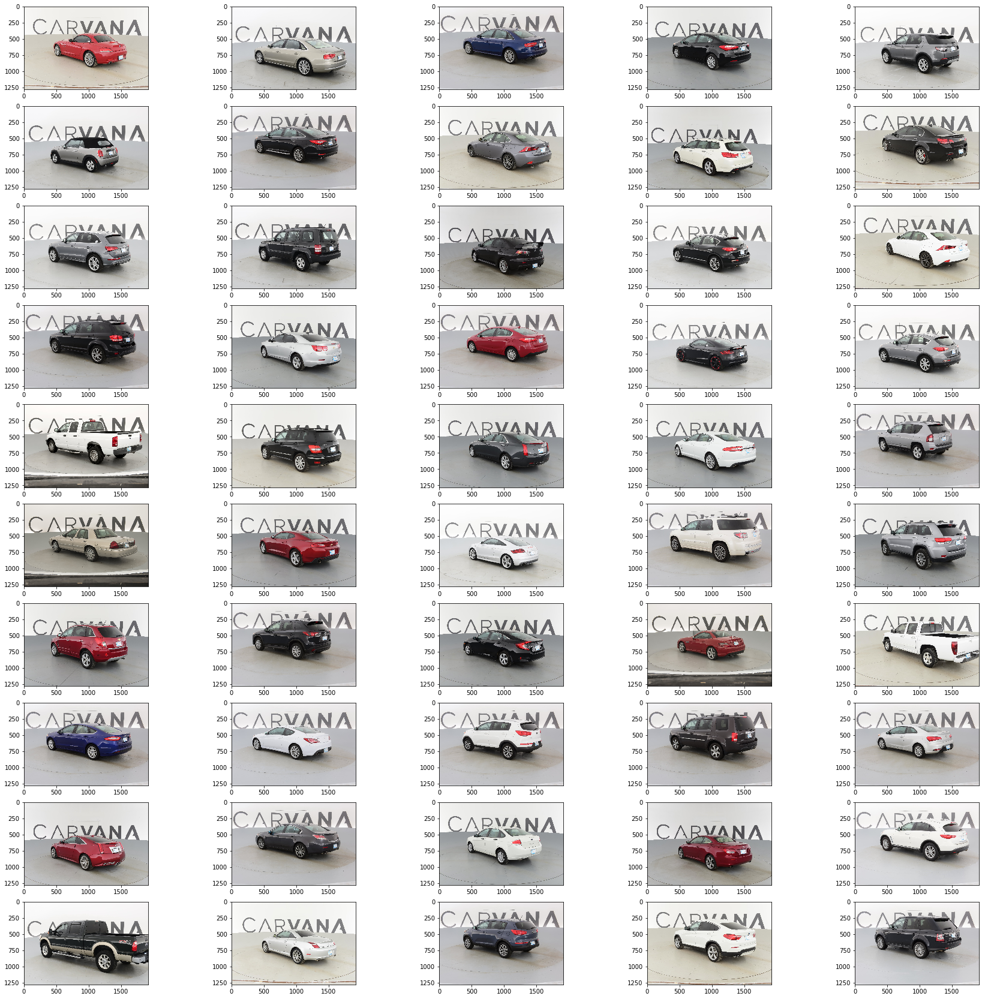

In [85]:
car_angle = 7
shuffle(ids_train)
imgs = [( imread('Kaggle-Carvana-Image-Masking-Challenge/input/train/{}_{}.jpg'.format(j,str(car_angle).zfill(2))) ) for j in ids_train[0:50]]
plots(imgs,figsize=(30,30),rows=10)

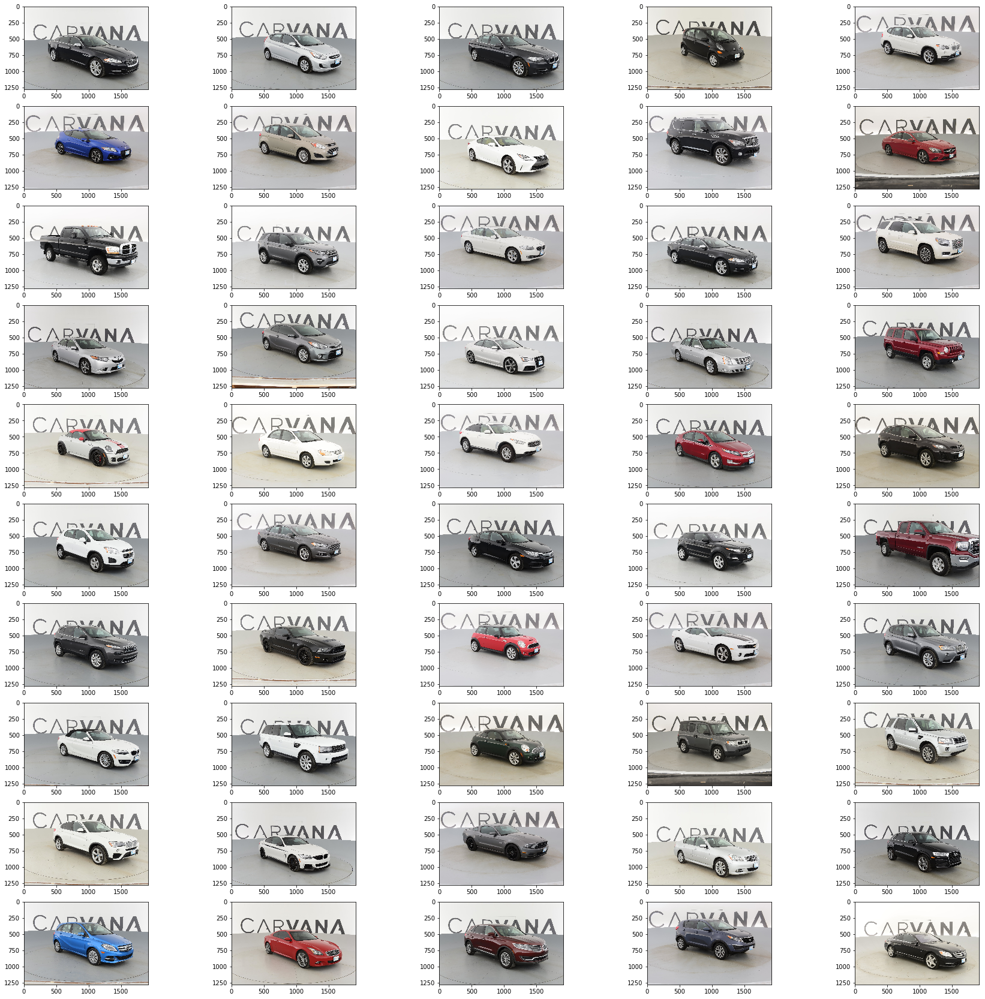

In [86]:
car_angle = 15
shuffle(ids_train)
imgs = [( imread('Kaggle-Carvana-Image-Masking-Challenge/input/train/{}_{}.jpg'.format(j,str(car_angle).zfill(2))) ) for j in ids_train[0:50]]
plots(imgs,figsize=(30,30),rows=10)

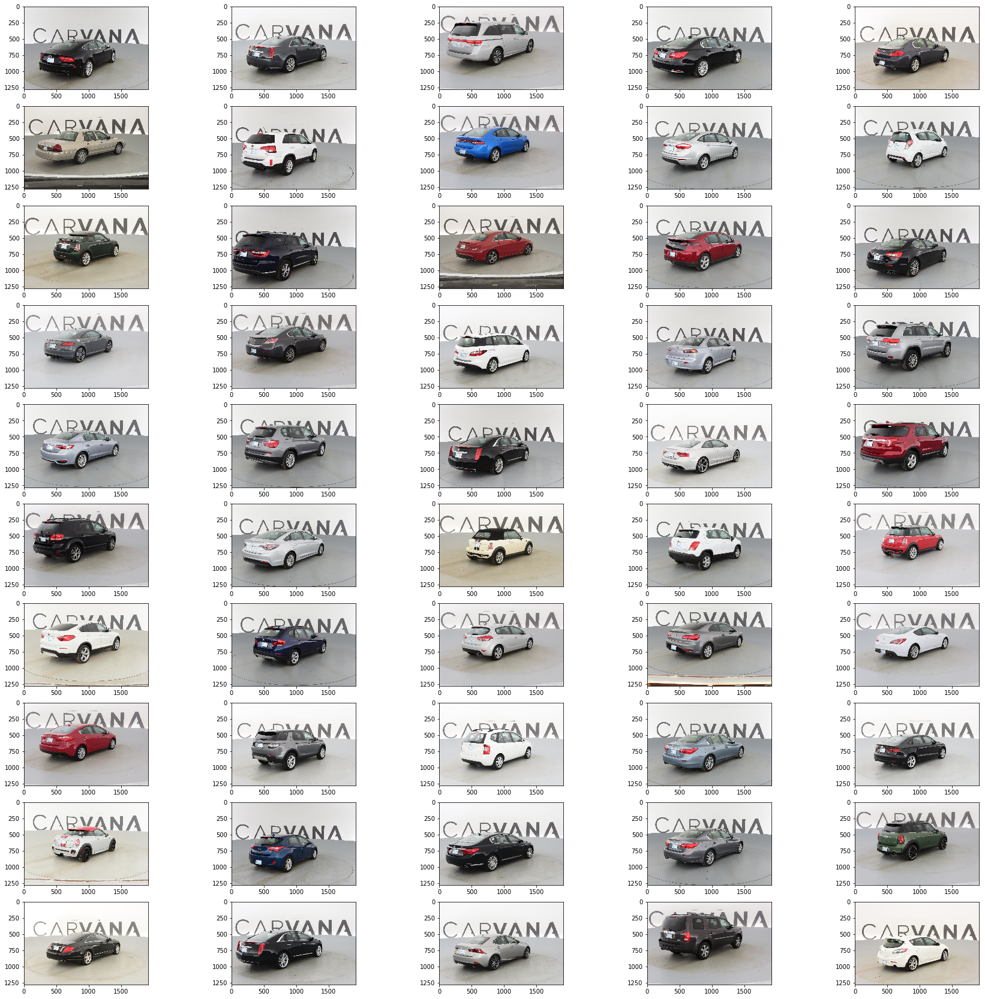

In [87]:
car_angle = 11
shuffle(ids_train)
imgs = [( imread('Kaggle-Carvana-Image-Masking-Challenge/input/train/{}_{}.jpg'.format(j,str(car_angle).zfill(2))) ) for j in ids_train[0:50]]
plots(imgs,figsize=(30,30),rows=10)

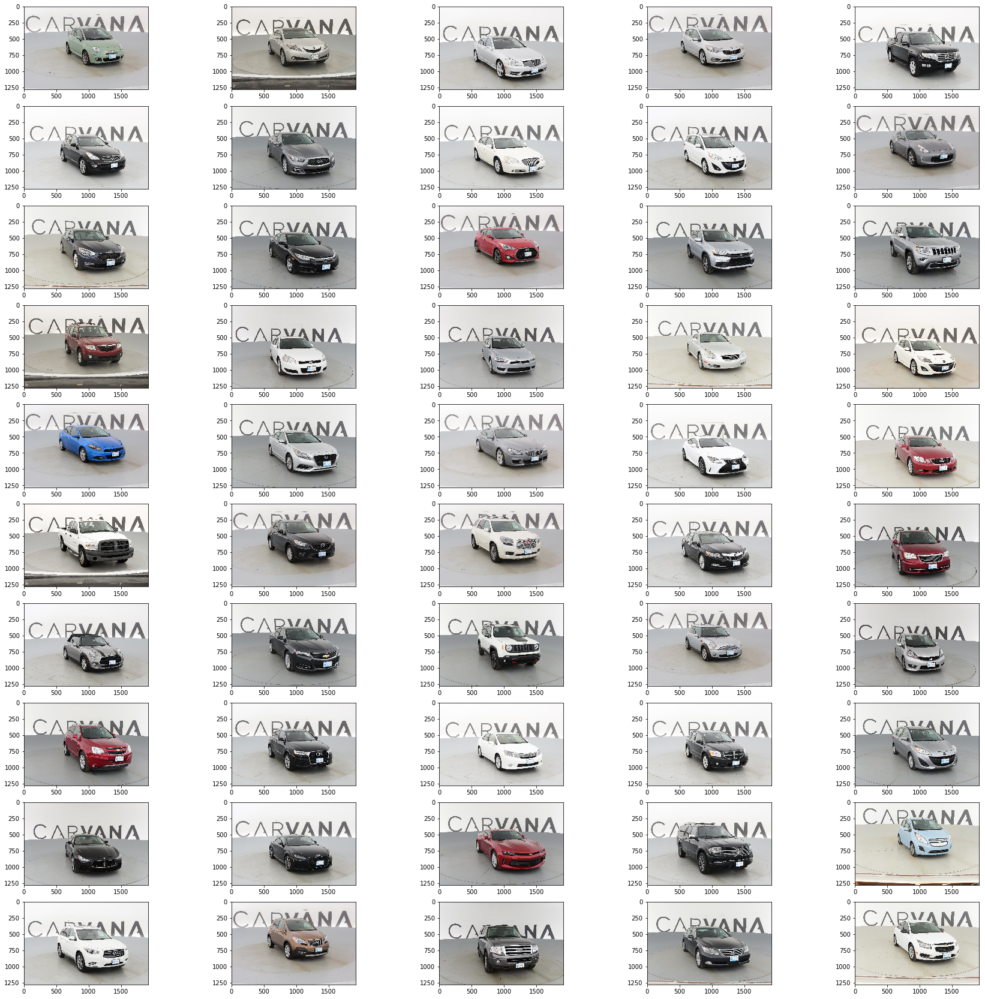

In [88]:
car_angle = 16
shuffle(ids_train)
imgs = [( imread('Kaggle-Carvana-Image-Masking-Challenge/input/train/{}_{}.jpg'.format(j,str(car_angle).zfill(2))) ) for j in ids_train[0:50]]
plots(imgs,figsize=(30,30),rows=10)

In [100]:
df_test = pd.read_csv('Kaggle-Carvana-Image-Masking-Challenge/input/sample_submission.csv')
df_test['car_angle'] = df_test['img'].apply(lambda s: s.split('.')[0][-2:])

ids_test = df_test[df_test.car_angle=='{}'.format('1'.zfill(2))]['img'].map(lambda s: s.split('.')[0])

names = []
for id in ids_test:
    names.append('{}.jpg'.format(id))


In [102]:
ids_test

0         0004d4463b50_01
16        000aa097d423_01
32        000f19f6e7d4_01
48        00144e887ae9_01
64        001a04be361e_01
80        002a1d2005bb_01
96        002b362dee46_01
112       00322b309335_01
128       004b030cf28f_01
144       006c1e464047_01
160       0072f74f24ca_01
176       0075b9ff9bca_01
192       00784b3ef435_01
208       007da964b668_01
224       008d02b91746_01
240       0091c5ec5d3d_01
256       0092275fcc63_01
272       009c97ec3729_01
288       00ad56bf7ee6_01
304       00afb946a54c_01
320       00b6aee52419_01
336       00c07d49f4c5_01
352       00d3de919651_01
368       00ea6d495e8f_01
384       00ea92389675_01
400       00f145d0d769_01
416       00fb5d5806c7_01
432       011330127438_01
448       014548a9586a_01
464       014baba60b16_01
               ...       
99584     fe26e42ca08c_01
99600     fe5c4a29ef17_01
99616     fe5c859aa7b6_01
99632     fe89a9fddc52_01
99648     fe90eb15b6a3_01
99664     fe92d1e14fe1_01
99680     fe9e76936077_01
99696     fe

In [104]:
len(names)

6254

# Model refine test

In [1]:
from model.unet_refine import get_unet_1024,refine_unet
from tools.multi_gpu import *

Using TensorFlow backend.


In [2]:
model = get_unet_1024()
# model = make_parallel(model, gpu_count=2)
# model.load_weights(filepath='weights/1024_unet_add_train_clr.hdf5')
# model.compile(optimizer=RMSprop(lr=0.0001), loss=bce_dice_loss, metrics=[dice_coeff])

In [4]:
model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, 1920, 1280, 3) 0                                            
____________________________________________________________________________________________________
conv2d_1 (Conv2D)                (None, 1920, 1280, 8) 224         input_1[0][0]                    
____________________________________________________________________________________________________
batch_normalization_1 (BatchNorm (None, 1920, 1280, 8) 32          conv2d_1[0][0]                   
____________________________________________________________________________________________________
activation_1 (Activation)        (None, 1920, 1280, 8) 0           batch_normalization_1[0][0]      
___________________________________________________________________________________________

In [3]:
model = refine_unet(model,num_classes=1)

In [4]:
model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, 1920, 1280, 3) 0                                            
____________________________________________________________________________________________________
conv2d_1 (Conv2D)                (None, 1920, 1280, 8) 224         input_1[0][0]                    
____________________________________________________________________________________________________
batch_normalization_1 (BatchNorm (None, 1920, 1280, 8) 32          conv2d_1[0][0]                   
____________________________________________________________________________________________________
activation_1 (Activation)        (None, 1920, 1280, 8) 0           batch_normalization_1[0][0]      
___________________________________________________________________________________________

# Tiramisu test


In [3]:
import tiramisu.densenet_fc as dc

In [8]:
model = dc.DenseNetFCN((1024, 1024, 3), nb_dense_block=5, growth_rate=16,
                        nb_layers_per_block=4, upsampling_type='upsampling', classes=1)

/home/av/cars/Kaggle-Carvana-Image-Masking-Challenge/tiramisu/densenet_fc.py:354: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(48, (3, 3), kernel_initializer="he_uniform", use_bias=False, padding="same", name="initial_conv2D", kernel_regularizer=<keras.reg...)`
  W_regularizer=l2(weight_decay))(img_input)
/home/av/cars/Kaggle-Carvana-Image-Masking-Challenge/tiramisu/densenet_fc.py:172: UserWarning: Update your `BatchNormalization` call to the Keras 2 API: `BatchNormalization(axis=-1, gamma_regularizer=<keras.reg..., beta_regularizer=<keras.reg...)`
  beta_regularizer=l2(weight_decay))(ip)
/home/av/cars/Kaggle-Carvana-Image-Masking-Challenge/tiramisu/densenet_fc.py:189: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(16, (3, 3), kernel_initializer="he_uniform", use_bias=False, padding="same", kernel_regularizer=<keras.reg...)`
  W_regularizer=l2(weight_decay))(x)
/home/av/cars/Kaggle-Carvana-Image-Masking-Challenge/tiramisu/densenet_fc.py:246: Us

In [6]:
model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, 32, 32, 3)     0                                            
____________________________________________________________________________________________________
initial_conv2D (Conv2D)          (None, 32, 32, 48)    1296        input_1[0][0]                    
____________________________________________________________________________________________________
batch_normalization_1 (BatchNorm (None, 32, 32, 48)    192         initial_conv2D[0][0]             
____________________________________________________________________________________________________
activation_1 (Activation)        (None, 32, 32, 48)    0           batch_normalization_1[0][0]      
___________________________________________________________________________________________

# Test feeding angle+1 and angle-1

In [10]:
import pandas as pd
from sklearn.model_selection import train_test_split

df_train = pd.read_csv('input/train_masks.csv')
ids_train = df_train['img'].map(lambda s: s.split('.')[0])

ids_train_split, ids_valid_split = train_test_split(ids_train, test_size=0.2, random_state=42)

In [14]:
batch_size = 4
for start in range(0, len(ids_train_split), batch_size):
    print(start)
    break

0


In [16]:
end = min(start + batch_size, len(ids_train_split))
ids_train_batch = ids_train_split[start:end]

In [18]:
def next_angle(angle):
    if (angle==16):
        return 1
    else:
        return angle+1
    
def previous_angle(angle):
    if (angle==1):
        return 16
    else:
        return angle-1

In [17]:
for id in ids_train_batch.values:
    print(id)

69915dab0755_16
695f39dfac16_04
2267f4aa0d2c_13
562706000bd7_15


In [38]:
'2267f4aa0d2c_13'[:-2]+str(next_angle(int('2267f4aa0d2c_16'[-2:]))).zfill(2)

'2267f4aa0d2c_01'

In [30]:
'2267f4aa0d2c_13'[:-2]+str(previous_angle(int('2267f4aa0d2c_01'[-2:])))

'2267f4aa0d2c_16'

In [36]:
import numpy as np

a = np.array([[1, 2], [3, 4]])
b = np.array([[1, 2], [3, 4]])
c = np.array([[1, 2], [3, 4]])

np.concatenate((a, b,c), axis=0)



array([[1, 2],
       [3, 4],
       [1, 2],
       [3, 4],
       [1, 2],
       [3, 4]])

In [40]:
import params

input_size = 1024

model = params.model_factory(input_shape=(input_size, input_size, 3*3), num_classes=1)

In [41]:
model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_4 (InputLayer)             (None, 1024, 1024, 9) 0                                            
____________________________________________________________________________________________________
conv2d_130 (Conv2D)              (None, 1024, 1024, 8) 656         input_4[0][0]                    
____________________________________________________________________________________________________
batch_normalization_128 (BatchNo (None, 1024, 1024, 8) 32          conv2d_130[0][0]                 
____________________________________________________________________________________________________
activation_130 (Activation)      (None, 1024, 1024, 8) 0           batch_normalization_128[0][0]    
___________________________________________________________________________________________

In [47]:
import cv2
import numpy as np
import pandas as pd
from skimage.io import imread

In [54]:
def train_generator():
    while True:
        for start in range(0, len(ids_train_split), batch_size):
            x_batch = []
            y_batch = []
            end = min(start + batch_size, len(ids_train_split))
            ids_train_batch = ids_train_split[start:end]
            for id in ids_train_batch.values:
                
                id_next = id[:-2]+str(next_angle(int(id[-2:]))).zfill(2)
                id_previous = id[:-2]+str(previous_angle(int(id[-2:]))).zfill(2)
                
                img = imread('input/train/{}.jpg'.format(id))
                img = cv2.resize(img, (input_size, input_size))
                mask = imread('input/train_masks/{}_mask.png'.format(id))
                mask = cv2.resize(mask, (input_size, input_size))
                img = randomHueSaturationValue(img,
                                               hue_shift_limit=(-50, 50),
                                               sat_shift_limit=(-5, 5),
                                               val_shift_limit=(-15, 15))
                img, mask = randomShiftScaleRotate(img, mask,
                                                   shift_limit=(-0.0625, 0.0625),
                                                   scale_limit=(-0.1, 0.1),
                                                   rotate_limit=(-0, 0))
                img, mask = randomHorizontalFlip(img, mask)
                mask = np.expand_dims(mask, axis=2)
                
                img_next = imread('input/train/{}.jpg'.format(id_next))
                img_next = cv2.resize(img_next, (input_size, input_size))
                mask_next = imread('input/train_masks/{}_mask.png'.format(id))
                mask_next = cv2.resize(mask_next, (input_size, input_size))
                img_next = randomHueSaturationValue(img_next,
                                               hue_shift_limit=(-50, 50),
                                               sat_shift_limit=(-5, 5),
                                               val_shift_limit=(-15, 15))
                img_next, mask_next = randomShiftScaleRotate(img_next, mask_next,
                                                   shift_limit=(-0.0625, 0.0625),
                                                   scale_limit=(-0.1, 0.1),
                                                   rotate_limit=(-0, 0))
                img_next, mask_next = randomHorizontalFlip(img_next, mask_next)
                mask_next = np.expand_dims(mask_next, axis=2)
                
                
                img_previous = imread('input/train/{}.jpg'.format(id_previous))
                img_previous = cv2.resize(img_previous, (input_size, input_size))
                mask_previous = imread('input/train_masks/{}_mask.png'.format(id))
                mask_previous = cv2.resize(mask_previous, (input_size, input_size))
                img_previous = randomHueSaturationValue(img_previous,
                                               hue_shift_limit=(-50, 50),
                                               sat_shift_limit=(-5, 5),
                                               val_shift_limit=(-15, 15))
                img_previous, mask_previous = randomShiftScaleRotate(img_previous, mask_previous,
                                                   shift_limit=(-0.0625, 0.0625),
                                                   scale_limit=(-0.1, 0.1),
                                                   rotate_limit=(-0, 0))
                img_previous, mask_previous = randomHorizontalFlip(img_previous, mask_previous)
                mask_previous = np.expand_dims(mask_previous, axis=2)
              
                x_batch.append(np.concatenate((img_previous, img, img_next), axis=2))
                y_batch.append(np.concatenate((mask_previous, mask, mask_next), axis=2))

            x_batch = np.array(x_batch, np.float32) / 255
            y_batch = np.array(y_batch, np.float32) / 255
            yield x_batch, y_batch


def valid_generator():
    while True:
        for start in range(0, len(ids_valid_split), batch_size):
            x_batch = []
            y_batch = []
            end = min(start + batch_size, len(ids_valid_split))
            ids_valid_batch = ids_valid_split[start:end]
            for id in ids_valid_batch.values:

                id_next = id[:-2]+str(next_angle(int(id[-2:]))).zfill(2)
                id_previous = id[:-2]+str(previous_angle(int(id[-2:]))).zfill(2)
                
                img = imread('input/train/{}.jpg'.format(id))
                img = cv2.resize(img, (input_size, input_size))
                mask = imread('input/train_masks/{}_mask.png'.format(id))
                mask = cv2.resize(mask, (input_size, input_size))
                img = randomHueSaturationValue(img,
                                               hue_shift_limit=(-50, 50),
                                               sat_shift_limit=(-5, 5),
                                               val_shift_limit=(-15, 15))
                img, mask = randomShiftScaleRotate(img, mask,
                                                   shift_limit=(-0.0625, 0.0625),
                                                   scale_limit=(-0.1, 0.1),
                                                   rotate_limit=(-0, 0))
                img, mask = randomHorizontalFlip(img, mask)
                mask = np.expand_dims(mask, axis=2)
                
                img_next = imread('input/train/{}.jpg'.format(id_next))
                img_next = cv2.resize(img_next, (input_size, input_size))
                mask_next = imread('input/train_masks/{}_mask.png'.format(id))
                mask_next = cv2.resize(mask_next, (input_size, input_size))
                img_next = randomHueSaturationValue(img_next,
                                               hue_shift_limit=(-50, 50),
                                               sat_shift_limit=(-5, 5),
                                               val_shift_limit=(-15, 15))
                img_next, mask_next = randomShiftScaleRotate(img_next, mask_next,
                                                   shift_limit=(-0.0625, 0.0625),
                                                   scale_limit=(-0.1, 0.1),
                                                   rotate_limit=(-0, 0))
                img_next, mask_next = randomHorizontalFlip(img_next, mask_next)
                mask_next = np.expand_dims(mask_next, axis=2)
                
                
                img_previous = imread('input/train/{}.jpg'.format(id_previous))
                img_previous = cv2.resize(img_previous, (input_size, input_size))
                mask_previous = imread('input/train_masks/{}_mask.png'.format(id))
                mask_previous = cv2.resize(mask_previous, (input_size, input_size))
                img_previous = randomHueSaturationValue(img_previous,
                                               hue_shift_limit=(-50, 50),
                                               sat_shift_limit=(-5, 5),
                                               val_shift_limit=(-15, 15))
                img_previous, mask_previous = randomShiftScaleRotate(img_previous, mask_previous,
                                                   shift_limit=(-0.0625, 0.0625),
                                                   scale_limit=(-0.1, 0.1),
                                                   rotate_limit=(-0, 0))
                img_previous, mask_previous = randomHorizontalFlip(img_previous, mask_previous)
                mask_previous = np.expand_dims(mask_previous, axis=2)
                
                x_batch.append(np.concatenate((img_previous, img, img_next), axis=2))
                y_batch.append(np.concatenate((mask_previous, mask, mask_next), axis=2))          
                
            x_batch = np.array(x_batch, np.float32) / 255
            y_batch = np.array(y_batch, np.float32) / 255
            yield x_batch, y_batch

In [88]:
def train_generator():
    while True:
        for start in range(0, len(ids_train_split), batch_size):
            x_batch = []
            y_batch = []
            y_batch_2 = []     
            
            end = min(start + batch_size, len(ids_train_split))
            ids_train_batch = ids_train_split[start:end]
            for id in ids_train_batch.values:
                
                id_next = id[:-2]+str(next_angle(int(id[-2:]))).zfill(2)
                id_previous = id[:-2]+str(previous_angle(int(id[-2:]))).zfill(2)
                
                img = imread('input/train/{}.jpg'.format(id))
                img = cv2.resize(img, (input_size, input_size))
                mask = imread('input/train_masks/{}_mask.png'.format(id))
                mask = cv2.resize(mask, (input_size, input_size))
                # img = randomHueSaturationValue(img,
                #                               hue_shift_limit=(-50, 50),
                #                               sat_shift_limit=(-5, 5),
                #                               val_shift_limit=(-15, 15))
                #img, mask = randomShiftScaleRotate(img, mask,
                #                                   shift_limit=(-0.0625, 0.0625),
                #                                   scale_limit=(-0.1, 0.1),
                #                                   rotate_limit=(-0, 0))
                #img, mask = randomHorizontalFlip(img, mask)
                mask = np.expand_dims(mask, axis=2)
                
                img_next = imread('input/train/{}.jpg'.format(id_next))
                img_next = cv2.resize(img_next, (input_size, input_size))
                mask_next = imread('input/train_masks/{}_mask.png'.format(id_next))
                mask_next = cv2.resize(mask_next, (input_size, input_size))
                #img_next = randomHueSaturationValue(img_next,
                #                               hue_shift_limit=(-50, 50),
                #                               sat_shift_limit=(-5, 5),
                #                               val_shift_limit=(-15, 15))
                #img_next, mask_next = randomShiftScaleRotate(img_next, mask_next,
                #                                   shift_limit=(-0.0625, 0.0625),
                #                                   scale_limit=(-0.1, 0.1),
                #                                   rotate_limit=(-0, 0))
                #img_next, mask_next = randomHorizontalFlip(img_next, mask_next)
                mask_next = np.expand_dims(mask_next, axis=2)
                
                
                img_previous = imread('input/train/{}.jpg'.format(id_previous))
                img_previous = cv2.resize(img_previous, (input_size, input_size))
                mask_previous = imread('input/train_masks/{}_mask.png'.format(id_previous))
                mask_previous = cv2.resize(mask_previous, (input_size, input_size))
                #img_previous = randomHueSaturationValue(img_previous,
                #                               hue_shift_limit=(-50, 50),
                #                               sat_shift_limit=(-5, 5),
                #                               val_shift_limit=(-15, 15))
                #img_previous, mask_previous = randomShiftScaleRotate(img_previous, mask_previous,
                #                                   shift_limit=(-0.0625, 0.0625),
                #                                   scale_limit=(-0.1, 0.1),
                #                                   rotate_limit=(-0, 0))
                #img_previous, mask_previous = randomHorizontalFlip(img_previous, mask_previous)
                mask_previous = np.expand_dims(mask_previous, axis=2)
              
                x_batch.append(np.concatenate((img_previous, img, img_next), axis=2))
                y_batch.append(np.concatenate((mask_previous, mask, mask_next), axis=2))
                y_batch_2.append(mask)                   

            x_batch = np.array(x_batch, np.float32) / 255
            y_batch = np.array(y_batch, np.float32) / 255
            y_batch_2 = np.array(y_batch_2, np.float32) / 255
            
            yield x_batch, [y_batch,y_batch_2]


def valid_generator():
    while True:
        for start in range(0, len(ids_valid_split), batch_size):
            x_batch = []
            y_batch = []
            y_batch_2 = []     
            
            end = min(start + batch_size, len(ids_valid_split))
            ids_valid_batch = ids_valid_split[start:end]
            for id in ids_valid_batch.values:

                id_next = id[:-2]+str(next_angle(int(id[-2:]))).zfill(2)
                id_previous = id[:-2]+str(previous_angle(int(id[-2:]))).zfill(2)
                
                img = imread('input/train/{}.jpg'.format(id))
                img = cv2.resize(img, (input_size, input_size))
                mask = imread('input/train_masks/{}_mask.png'.format(id))
                mask = cv2.resize(mask, (input_size, input_size))
                #img = randomHueSaturationValue(img,
                #                               hue_shift_limit=(-50, 50),
                #                               sat_shift_limit=(-5, 5),
                #                               val_shift_limit=(-15, 15))
                #img, mask = randomShiftScaleRotate(img, mask,
                #                                   shift_limit=(-0.0625, 0.0625),
                #                                   scale_limit=(-0.1, 0.1),
                #                                   rotate_limit=(-0, 0))
                #img, mask = randomHorizontalFlip(img, mask)
                mask = np.expand_dims(mask, axis=2)
                
                img_next = imread('input/train/{}.jpg'.format(id_next))
                img_next = cv2.resize(img_next, (input_size, input_size))
                mask_next = imread('input/train_masks/{}_mask.png'.format(id_next))
                mask_next = cv2.resize(mask_next, (input_size, input_size))
                #img_next = randomHueSaturationValue(img_next,
                #                               hue_shift_limit=(-50, 50),
                #                               sat_shift_limit=(-5, 5),
                #                               val_shift_limit=(-15, 15))
                #img_next, mask_next = randomShiftScaleRotate(img_next, mask_next,
                #                                   shift_limit=(-0.0625, 0.0625),
                #                                   scale_limit=(-0.1, 0.1),
                #                                   rotate_limit=(-0, 0))
                #img_next, mask_next = randomHorizontalFlip(img_next, mask_next)
                mask_next = np.expand_dims(mask_next, axis=2)
                
                
                img_previous = imread('input/train/{}.jpg'.format(id_previous))
                img_previous = cv2.resize(img_previous, (input_size, input_size))
                mask_previous = imread('input/train_masks/{}_mask.png'.format(id_previous))
                mask_previous = cv2.resize(mask_previous, (input_size, input_size))
                #img_previous = randomHueSaturationValue(img_previous,
                #                               hue_shift_limit=(-50, 50),
                #                               sat_shift_limit=(-5, 5),
                #                               val_shift_limit=(-15, 15))
                #img_previous, mask_previous = randomShiftScaleRotate(img_previous, mask_previous,
                #                                   shift_limit=(-0.0625, 0.0625),
                #                                   scale_limit=(-0.1, 0.1),
                #                                   rotate_limit=(-0, 0))
                #img_previous, mask_previous = randomHorizontalFlip(img_previous, mask_previous)
                mask_previous = np.expand_dims(mask_previous, axis=2)
                
                x_batch.append(np.concatenate((img_previous, img, img_next), axis=2))
                y_batch.append(np.concatenate((mask_previous, mask, mask_next), axis=2))          
                y_batch_2.append(mask)   
                
            x_batch = np.array(x_batch, np.float32) / 255
            y_batch = np.array(y_batch, np.float32) / 255
            y_batch_2 = np.array(y_batch_2, np.float32) / 255
            
            yield x_batch, [y_batch,y_batch_2]


def randomHorizontalFlip(image, mask, u=0.5):
    if np.random.random() < u:
        image = cv2.flip(image, 1)
        mask = cv2.flip(mask, 1)

    return image, mask


def next_angle(angle):
    if (angle==16):
        return 1
    else:
        return angle+1
    
def previous_angle(angle):
    if (angle==1):
        return 16
    else:
        return angle-1

In [89]:
generator=valid_generator()

In [92]:
x_batch, y_batch = next(generator)

In [74]:
x_batch.shape

(4, 1024, 1024, 9)

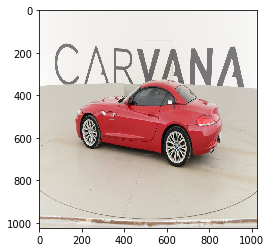

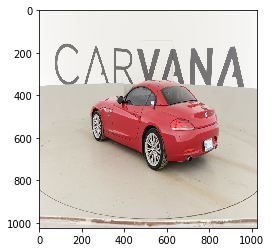

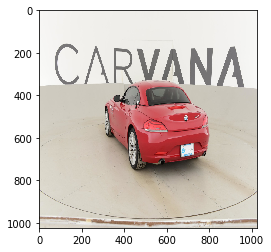

In [94]:
import matplotlib.pyplot as plt

plt.imshow(x_batch[1,:,:,0:3])
plt.show()
plt.imshow(x_batch[1,:,:,3:6])
plt.show()
plt.imshow(x_batch[1,:,:,6:9])
plt.show()

In [84]:
y_batch[0].shape

(4, 1024, 1024, 3)

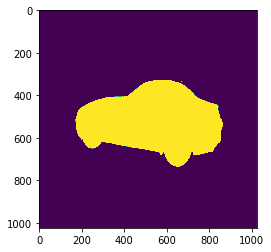

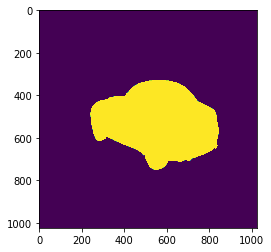

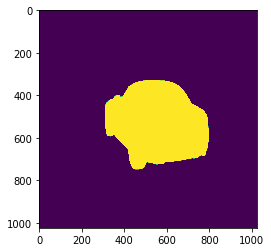

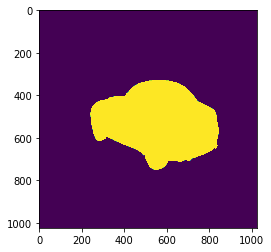

In [95]:
import matplotlib.pyplot as plt

plt.imshow(y_batch[0][1,:,:,0])
plt.show()
plt.imshow(y_batch[0][1,:,:,1])
plt.show()
plt.imshow(y_batch[0][1,:,:,2])
plt.show()
plt.imshow(y_batch[1][1,:,:,0])
plt.show()

# Test gfrnet

In [2]:
from tools.multi_gpu import *

Using TensorFlow backend.


In [1]:
from params import *

Using TensorFlow backend.


In [2]:
model = g_frnet_selu()

In [3]:
model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, 1280, 1920, 3) 0                                            
____________________________________________________________________________________________________
f1_conv_1 (Conv2D)               (None, 1280, 1920, 8) 224         input_1[0][0]                    
____________________________________________________________________________________________________
batch_normalization_1 (BatchNorm (None, 1280, 1920, 8) 32          f1_conv_1[0][0]                  
____________________________________________________________________________________________________
activation_1 (Activation)        (None, 1280, 1920, 8) 0           batch_normalization_1[0][0]      
___________________________________________________________________________________________

In [ ]:
'f1_conv_1','f1_conv_1','f1_conv_1','f1_conv_1','f1_conv_1','f1_conv_1','f1_conv_1'

In [58]:
from keras.models import Model
from keras.layers import Input, concatenate, Conv2D, MaxPooling2D, Activation, UpSampling2D, BatchNormalization,multiply
from keras.optimizers import RMSprop

from model.losses import bce_dice_loss, dice_loss, weighted_bce_dice_loss, weighted_dice_loss, dice_coeff
import params


orig_width = 1918
orig_height = 1280

def g_frnet(input_shape=(orig_width+2, orig_height, 3),
            num_classes=1):

    inputs = Input(shape=input_shape)
    # 1024

    f1 = Conv2D(8, (3, 3), padding='same')(inputs)
    f1 = BatchNormalization()(f1)
    f1 = Activation('relu')(f1)
    f1 = Conv2D(8, (3, 3), padding='same')(f1)
    f1 = BatchNormalization()(f1)
    f1 = Activation('relu')(f1)
    f1_pool = MaxPooling2D((2, 2), strides=(2, 2))(f1)
    # 512

    f2 = Conv2D(16, (3, 3), padding='same')(f1_pool)
    f2 = BatchNormalization()(f2)
    f2 = Activation('relu')(f2)
    f2 = Conv2D(16, (3, 3), padding='same')(f2)
    f2 = BatchNormalization()(f2)
    f2 = Activation('relu')(f2)
    f2_pool = MaxPooling2D((2, 2), strides=(2, 2))(f2)
    # 256

    f3 = Conv2D(32, (3, 3), padding='same')(f2_pool)
    f3 = BatchNormalization()(f3)
    f3 = Activation('relu')(f3)
    f3 = Conv2D(32, (3, 3), padding='same')(f3)
    f3 = BatchNormalization()(f3)
    f3 = Activation('relu')(f3)
    f3_pool = MaxPooling2D((2, 2), strides=(2, 2))(f3)
    # 128

    f4 = Conv2D(64, (3, 3), padding='same')(f3_pool)
    f4 = BatchNormalization()(f4)
    f4 = Activation('relu')(f4)
    f4 = Conv2D(64, (3, 3), padding='same')(f4)
    f4 = BatchNormalization()(f4)
    f4 = Activation('relu')(f4)
    f4_pool = MaxPooling2D((2, 2), strides=(2, 2))(f4)
    # 64

    f5 = Conv2D(128, (3, 3), padding='same')(f4_pool)
    f5 = BatchNormalization()(f5)
    f5 = Activation('relu')(f5)
    f5 = Conv2D(128, (3, 3), padding='same')(f5)
    f5 = BatchNormalization()(f5)
    f5 = Activation('relu')(f5)
    f5_pool = MaxPooling2D((2, 2), strides=(2, 2))(f5)
    # 32

    f6 = Conv2D(256, (3, 3), padding='same')(f5_pool)
    f6 = BatchNormalization()(f6)
    f6 = Activation('relu')(f6)
    f6 = Conv2D(256, (3, 3), padding='same')(f6)
    f6 = BatchNormalization()(f6)
    f6 = Activation('relu')(f6)
    f6_pool = MaxPooling2D((2, 2), strides=(2, 2))(f6)
    # 16

    f7 = Conv2D(512, (3, 3), padding='same')(f6_pool)
    f7 = BatchNormalization()(f7)
    f7 = Activation('relu')(f7)
    f7 = Conv2D(512, (3, 3), padding='same')(f7)
    f7 = BatchNormalization()(f7)
    f7 = Activation('relu')(f7)
    f7_pool = MaxPooling2D((2, 2), strides=(2, 2))(f7)
    
    ru0 = Conv2D(num_classes, (1, 1), activation='sigmoid')(f7)

    # 8


    g1 = gate_unit(f_i = f6_pool, f_i1 = f7_pool)
    ru1 = gated_refinement_unit (r_f = ru0, m_f = g1, num_classes=num_classes)   


    g2 = gate_unit(f_i = f5_pool, f_i1 = f6_pool)
    ru2 = gated_refinement_unit (r_f = ru1, m_f = g2, num_classes=num_classes)
                                 
    g3 = gate_unit(f_i = f4_pool, f_i1 = f5_pool)
    ru3 = gated_refinement_unit (r_f = ru2, m_f = g3, num_classes=num_classes)
                                 
    g4 = gate_unit(f_i = f3_pool, f_i1 = f4_pool)
    ru4 = gated_refinement_unit (r_f = ru3, m_f = g4, num_classes=num_classes)
                                 
    g5 = gate_unit(f_i = f2_pool, f_i1 = f3_pool)
    ru5 = gated_refinement_unit (r_f = ru4, m_f = g5, num_classes=num_classes)

    g6 = gate_unit(f_i = f1_pool, f_i1 = f2_pool)
    ru6 = gated_refinement_unit (r_f = ru5, m_f = g6, num_classes=num_classes)

    model = Model(inputs=inputs, outputs=[ru0,ru1,ru2,ru3,ru4,ru5,ru6])
    model.compile(optimizer=RMSprop(lr=0.0001), loss=bce_dice_loss, metrics=[dice_coeff], , loss_weights=[0.15,0.15,0.15,0.15,0.15,0.15,0.1])

    return model    

In [27]:
model2 = g_frnet_selu()

In [28]:
model2.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_4 (InputLayer)             (None, 1280, 1920, 3) 0                                            
____________________________________________________________________________________________________
f1_conv_1 (Conv2D)               (None, 1280, 1920, 8) 224         input_4[0][0]                    
____________________________________________________________________________________________________
batch_normalization_107 (BatchNo (None, 1280, 1920, 8) 32          f1_conv_1[0][0]                  
____________________________________________________________________________________________________
activation_107 (Activation)      (None, 1280, 1920, 8) 0           batch_normalization_107[0][0]    
___________________________________________________________________________________________

In [4]:
import params
from tools.multi_gpu import *

batch_size = 2 * 1
model = params.model_factory_selu()
model = make_parallel(model, gpu_count=2)
model.load_weights('weights/1024_unet_selu_clean.hdf5')

/home/av/cars/Kaggle-Carvana-Image-Masking-Challenge/tools/multi_gpu.py:44: UserWarning: The `merge` function is deprecated and will be removed after 08/2017. Use instead layers from `keras.layers.merge`, e.g. `add`, `concatenate`, etc.
  merged.append(merge(outputs, mode='concat', concat_axis=0))
/usr/local/lib/python3.5/dist-packages/keras/legacy/layers.py:458: UserWarning: The `Merge` layer is deprecated and will be removed after 08/2017. Use instead layers from `keras.layers.merge`, e.g. `add`, `concatenate`, etc.
  name=name)
/home/av/cars/Kaggle-Carvana-Image-Masking-Challenge/tools/multi_gpu.py:46: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=[<tf.Tenso..., inputs=[<tf.Tenso...)`
  return Model(input=model.inputs, output=merged)


In [23]:
import keras 

for layer in model.layers:
    if type(layer) is keras.engine.training.Model:
        print(layer.summary())
        for inner_layer in layer.layers:
            if 'conv' in inner_layer.name:
                print (inner_layer.name)

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_2 (InputLayer)             (None, 1920, 1280, 3) 0                                            
____________________________________________________________________________________________________
conv2d_39 (Conv2D)               (None, 1920, 1280, 8) 224         input_2[0][0]                    
____________________________________________________________________________________________________
batch_normalization_38 (BatchNor (None, 1920, 1280, 8) 32          conv2d_39[0][0]                  
____________________________________________________________________________________________________
activation_38 (Activation)       (None, 1920, 1280, 8) 0           batch_normalization_38[0][0]     
___________________________________________________________________________________________

In [4]:
donor_weights_dict = {
'conv2d_1' : 'f1_conv_1',
'conv2d_2' : 'f1_conv_2',
'conv2d_3' : 'f2_conv_1',
'conv2d_4' : 'f2_conv_2',
'conv2d_5' : 'f3_conv_1',
'conv2d_6' : 'f3_conv_2',
'conv2d_7' : 'f4_conv_1',
'conv2d_8' : 'f4_conv_2',
'conv2d_9' : 'f5_conv_1',
'conv2d_10' : 'f5_conv_2',
'conv2d_11' : 'f6_conv_1',
'conv2d_12' : 'f6_conv_2',
'conv2d_13' : 'f7_conv_1',
'conv2d_14' : 'f7_conv_2'
}

donor_weights_list = [
'conv2d_39',
'conv2d_40',
'conv2d_41',
'conv2d_42',
'conv2d_43',
'conv2d_44',
'conv2d_45',
'conv2d_46',
'conv2d_47',
'conv2d_48',
'conv2d_49',
'conv2d_50',
'conv2d_51',
'conv2d_52'
]

recepient_weights = [
'f1_conv_1',
'f1_conv_2',
'f2_conv_1',
'f2_conv_2',
'f3_conv_1',
'f3_conv_2',
'f4_conv_1',
'f4_conv_2',
'f5_conv_1',
'f5_conv_2',
'f6_conv_1',
'f6_conv_2',
'f7_conv_1',
'f7_conv_2'
]





In [3]:
import params
from tools.multi_gpu import *
import keras

batch_size = 2 * 1
donor_model = params.model_factory_selu()
donor_model = make_parallel(donor_model, gpu_count=2)
donor_model.load_weights('weights/1024_unet_selu_clean.hdf5')

donor_weights_dict = {
'conv2d_1' : 'f1_conv_1',
'conv2d_2' : 'f1_conv_2',
'conv2d_3' : 'f2_conv_1',
'conv2d_4' : 'f2_conv_2',
'conv2d_5' : 'f3_conv_1',
'conv2d_6' : 'f3_conv_2',
'conv2d_7' : 'f4_conv_1',
'conv2d_8' : 'f4_conv_2',
'conv2d_9' : 'f5_conv_1',
'conv2d_10' : 'f5_conv_2',
'conv2d_11' : 'f6_conv_1',
'conv2d_12' : 'f6_conv_2',
'conv2d_13' : 'f7_conv_1',
'conv2d_14' : 'f7_conv_2'
}

donor_weights_list = [
'conv2d_1',
'conv2d_2',
'conv2d_3',
'conv2d_4',
'conv2d_5',
'conv2d_6',
'conv2d_7',
'conv2d_8',
'conv2d_9',
'conv2d_10',
'conv2d_11',
'conv2d_12',
'conv2d_13',
'conv2d_14'
]

recepient_weights = [
'f1_conv_1',
'f1_conv_2',
'f2_conv_1',
'f2_conv_2',
'f3_conv_1',
'f3_conv_2',
'f4_conv_1',
'f4_conv_2',
'f5_conv_1',
'f5_conv_2',
'f6_conv_1',
'f6_conv_2',
'f7_conv_1',
'f7_conv_2'
]


g_frnet = params.model_factory_g_frnet_selu()

for layer in donor_model.layers:
    if type(layer) is keras.engine.training.Model:
        for inner_layer in layer.layers:
            if inner_layer.name in donor_weights_list:
                print(inner_layer.name)
                g_frnet.get_layer(donor_weights_dict[inner_layer.name]).set_weights(inner_layer.get_weights())
                g_frnet.get_layer(donor_weights_dict[inner_layer.name]).trainable = False
                print('Weights from layer {} have been applied to layer {}'.format(inner_layer.name,donor_weights_dict[inner_layer.name]))
                
g_frnet = make_parallel(g_frnet, gpu_count=2)


Using TensorFlow backend.
/home/av/cars/Kaggle-Carvana-Image-Masking-Challenge/tools/multi_gpu.py:44: UserWarning: The `merge` function is deprecated and will be removed after 08/2017. Use instead layers from `keras.layers.merge`, e.g. `add`, `concatenate`, etc.
  merged.append(merge(outputs, mode='concat', concat_axis=0))
/usr/local/lib/python3.5/dist-packages/keras/legacy/layers.py:458: UserWarning: The `Merge` layer is deprecated and will be removed after 08/2017. Use instead layers from `keras.layers.merge`, e.g. `add`, `concatenate`, etc.
  name=name)
/home/av/cars/Kaggle-Carvana-Image-Masking-Challenge/tools/multi_gpu.py:46: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=[<tf.Tenso..., inputs=[<tf.Tenso...)`
  return Model(input=model.inputs, output=merged)


conv2d_1
Weights from layer conv2d_1 have been applied to layer f1_conv_1
conv2d_2
Weights from layer conv2d_2 have been applied to layer f1_conv_2
conv2d_3
Weights from layer conv2d_3 have been applied to layer f2_conv_1
conv2d_4
Weights from layer conv2d_4 have been applied to layer f2_conv_2
conv2d_5
Weights from layer conv2d_5 have been applied to layer f3_conv_1
conv2d_6
Weights from layer conv2d_6 have been applied to layer f3_conv_2
conv2d_7
Weights from layer conv2d_7 have been applied to layer f4_conv_1
conv2d_8
Weights from layer conv2d_8 have been applied to layer f4_conv_2
conv2d_9
Weights from layer conv2d_9 have been applied to layer f5_conv_1
conv2d_10
Weights from layer conv2d_10 have been applied to layer f5_conv_2
conv2d_11
Weights from layer conv2d_11 have been applied to layer f6_conv_1
conv2d_12
Weights from layer conv2d_12 have been applied to layer f6_conv_2
conv2d_13
Weights from layer conv2d_13 have been applied to layer f7_conv_1
conv2d_14
Weights from layer c

In [4]:
g_frnet.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_2 (InputLayer)             (None, 1280, 1920, 3) 0                                            
____________________________________________________________________________________________________
lambda_3 (Lambda)                (None, 1280, 1920, 3) 0           input_2[0][0]                    
____________________________________________________________________________________________________
lambda_4 (Lambda)                (None, 1280, 1920, 3) 0           input_2[0][0]                    
____________________________________________________________________________________________________
model_3 (Model)                  [(None, 1280, 1920, 1 4838825     lambda_3[0][0]                   
                                                                   lambda_4[0][0]          

In [3]:
donor_weights_dict['conv2d_12']

'f6_conv_2'

In [4]:
type(g_frnet.get_layer(donor_weights_dict['conv2d_12']))

NoneType

In [5]:
g_frnet.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_2 (InputLayer)             (None, 1280, 1920, 3) 0                                            
____________________________________________________________________________________________________
f1_conv_1 (Conv2D)               (None, 1280, 1920, 8) 224         input_2[0][0]                    
____________________________________________________________________________________________________
batch_normalization_38 (BatchNor (None, 1280, 1920, 8) 32          f1_conv_1[0][0]                  
____________________________________________________________________________________________________
activation_38 (Activation)       (None, 1280, 1920, 8) 0           batch_normalization_38[0][0]     
___________________________________________________________________________________________

In [38]:
g_frnet.layers['f1_conv_1']

TypeError: list indices must be integers or slices, not str

In [37]:
g_frnet = g_frnet_selu()

for layer in g_frnet.layers:
    if layer.name in recepient_weights:
        print (layer.name)

f1_conv_1
f1_conv_2
f2_conv_1
f2_conv_2
f3_conv_1
f3_conv_2
f4_conv_1
f4_conv_2
f5_conv_1
f5_conv_2
f6_conv_1
f7_conv_1
f7_conv_2


In [39]:
g_frnet.get_layer("f1_conv_1")

In [ ]:
layer_dict = dict([(layer.name, layer) for layer in model.layers])
weights = layer_dict['some_name'].get_weights()

In [20]:
inner_layer.name


<bound method Layer.from_config of <class 'keras.engine.topology.InputLayer'>>

In [12]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         (None, 1920, 1280, 3)     0         
_________________________________________________________________
conv2d_33 (Conv2D)           (None, 1920, 1280, 8)     224       
_________________________________________________________________
batch_normalization_31 (Batc (None, 1920, 1280, 8)     32        
_________________________________________________________________
activation_31 (Activation)   (None, 1920, 1280, 8)     0         
_________________________________________________________________
conv2d_34 (Conv2D)           (None, 1920, 1280, 8)     584       
_________________________________________________________________
batch_normalization_32 (Batc (None, 1920, 1280, 8)     32        
_________________________________________________________________
activation_32 (Activation)   (None, 1920, 1280, 8)     0         
__________

In [1]:
from keras.models import Model
from keras.layers import Input, concatenate, Conv2D, MaxPooling2D, Activation, UpSampling2D, BatchNormalization,multiply
from keras.optimizers import RMSprop

from model.losses import bce_dice_loss, dice_loss, weighted_bce_dice_loss, weighted_dice_loss, dice_coeff
import params

orig_width = 1918
orig_height = 1280

def gate_unit(f_i, f_i1):
    f_i = Conv2D(8, (3, 3), padding='same')(f_i)
    f_i = BatchNormalization()(f_i)
    f_i = Activation('relu')(f_i)    

    f_i1 = Conv2D(8, (3, 3), padding='same')(f_i1)
    f_i1 = BatchNormalization()(f_i1)
    f_i1 = Activation('relu')(f_i1)    
    f_i1 = UpSampling2D((2, 2))(f_i1)    

    output = multiply([f_i,f_i1])    
    return output

def gated_refinement_unit(r_f, m_f, num_classes):
    m_f = Conv2D(num_classes, (3, 3), padding='same')(m_f)
    m_f = BatchNormalization()(m_f)
    m_f = Activation('relu')(m_f)

    output = concatenate([r_f, m_f], axis=3)    
    output = Conv2D(num_classes, (3, 3), padding='same')(output)
    output = UpSampling2D((2, 2))(output)     

    return output

def g_frnet(input_shape=(orig_width+2, orig_height, 3),
            num_classes=1):

    inputs = Input(shape=input_shape)
    # 1024

    f1 = Conv2D(8, (3, 3), padding='same')(inputs)
    f1 = BatchNormalization()(f1)
    f1 = Activation('relu')(f1)
    f1 = Conv2D(8, (3, 3), padding='same')(f1)
    f1 = BatchNormalization()(f1)
    f1 = Activation('relu')(f1)
    f1_pool = MaxPooling2D((2, 2), strides=(2, 2))(f1)
    # 512

    f2 = Conv2D(16, (3, 3), padding='same')(f1_pool)
    f2 = BatchNormalization()(f2)
    f2 = Activation('relu')(f2)
    f2 = Conv2D(16, (3, 3), padding='same')(f2)
    f2 = BatchNormalization()(f2)
    f2 = Activation('relu')(f2)
    f2_pool = MaxPooling2D((2, 2), strides=(2, 2))(f2)
    # 256

    f3 = Conv2D(32, (3, 3), padding='same')(f2_pool)
    f3 = BatchNormalization()(f3)
    f3 = Activation('relu')(f3)
    f3 = Conv2D(32, (3, 3), padding='same')(f3)
    f3 = BatchNormalization()(f3)
    f3 = Activation('relu')(f3)
    f3_pool = MaxPooling2D((2, 2), strides=(2, 2))(f3)
    # 128

    f4 = Conv2D(64, (3, 3), padding='same')(f3_pool)
    f4 = BatchNormalization()(f4)
    f4 = Activation('relu')(f4)
    f4 = Conv2D(64, (3, 3), padding='same')(f4)
    f4 = BatchNormalization()(f4)
    f4 = Activation('relu')(f4)
    f4_pool = MaxPooling2D((2, 2), strides=(2, 2))(f4)
    # 64

    f5 = Conv2D(128, (3, 3), padding='same')(f4_pool)
    f5 = BatchNormalization()(f5)
    f5 = Activation('relu')(f5)
    f5 = Conv2D(128, (3, 3), padding='same')(f5)
    f5 = BatchNormalization()(f5)
    f5 = Activation('relu')(f5)
    f5_pool = MaxPooling2D((2, 2), strides=(2, 2))(f5)
    # 32

    f6 = Conv2D(256, (3, 3), padding='same')(f5_pool)
    f6 = BatchNormalization()(f6)
    f6 = Activation('relu')(f6)
    f6 = Conv2D(256, (3, 3), padding='same')(f6)
    f6 = BatchNormalization()(f6)
    f6 = Activation('relu')(f6)
    f6_pool = MaxPooling2D((2, 2), strides=(2, 2))(f6)
    # 16

    f7 = Conv2D(512, (3, 3), padding='same')(f6_pool)
    f7 = BatchNormalization()(f7)
    f7 = Activation('relu')(f7)
    f7 = Conv2D(512, (3, 3), padding='same')(f7)
    f7 = BatchNormalization()(f7)
    f7 = Activation('relu')(f7)
    f7_pool = MaxPooling2D((2, 2), strides=(2, 2))(f7)
    
    ru0 = Conv2D(num_classes, (1, 1), activation='sigmoid')(f7)

    # 8


    g1 = gate_unit(f_i = f6_pool, f_i1 = f7_pool)
    ru1 = gated_refinement_unit (r_f = ru0, m_f = g1, num_classes=num_classes)   


    g2 = gate_unit(f_i = f5_pool, f_i1 = f6_pool)
    ru2 = gated_refinement_unit (r_f = ru1, m_f = g2, num_classes=num_classes)
                                 
    g3 = gate_unit(f_i = f4_pool, f_i1 = f5_pool)
    ru3 = gated_refinement_unit (r_f = ru2, m_f = g3, num_classes=num_classes)
                                 
    g4 = gate_unit(f_i = f3_pool, f_i1 = f4_pool)
    ru4 = gated_refinement_unit (r_f = ru3, m_f = g4, num_classes=num_classes)
                                 
    g5 = gate_unit(f_i = f2_pool, f_i1 = f3_pool)
    ru5 = gated_refinement_unit (r_f = ru4, m_f = g5, num_classes=num_classes)

    g6 = gate_unit(f_i = f1_pool, f_i1 = f2_pool)
    ru6 = gated_refinement_unit (r_f = ru5, m_f = g6, num_classes=num_classes)

    model = Model(inputs=inputs, outputs=[ru6,ru5,ru4,ru3,ru2,ru1,ru0])
    model.compile(optimizer=RMSprop(lr=0.0001), loss=bce_dice_loss, metrics=[dice_coeff], loss_weights = [0.15,0.15,0.15,0.15,0.15,0.15,0.1])

    return model   

Using TensorFlow backend.


In [2]:
model = g_frnet()

In [154]:
import pydot
import graphviz 

In [3]:
from keras.utils import plot_model
plot_model(model, to_file='model.png')

# Train test split by area

In [1]:
import pandas as pd

df_train = pd.read_csv('input/train_masks.csv')
ids_train = df_train['img'].map(lambda s: s.split('.')[0])

In [2]:
len(ids_train)

5088

In [9]:
car_ids = list(set(df_train['img'].map(lambda s: s.split('.')[0][:-3])))

In [10]:
len(car_ids)

318

In [23]:
from skimage.io import imread
idx = range(1,17)

car_size_df = pd.DataFrame()

car_sizes = []

for car in car_ids:
    car_masks = [ ( imread('input/train_masks/{}_{}_mask.png'.format(car,str(car_angle).zfill(2))) ) for car_angle in idx ]
    car_sizes.append(np.ceil(np.asarray(car_masks).sum() / 1638400 / 16))
    
car_size_df['car_id'] = car_ids
car_size_df['car_size'] = car_sizes


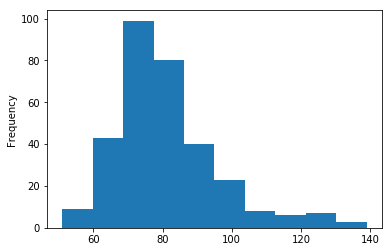

In [26]:
%matplotlib inline
car_size_df.car_size.plot(kind='hist')


In [37]:
car_size_df['quantile'] = pd.qcut(car_size_df.car_size, 4, labels=False)

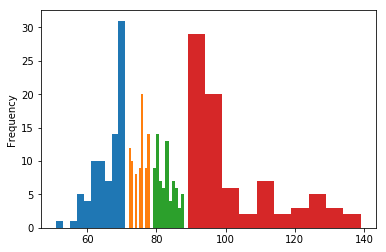

In [39]:
car_size_df[car_size_df['quantile'] == 0].car_size.plot(kind='hist')
car_size_df[car_size_df['quantile'] == 1].car_size.plot(kind='hist')
car_size_df[car_size_df['quantile'] == 2].car_size.plot(kind='hist')
car_size_df[car_size_df['quantile'] == 3].car_size.plot(kind='hist')

In [46]:
car_size_df.to_csv('car_size_df.csv')

In [40]:
from sklearn.model_selection import train_test_split

ids_train_split, ids_valid_split = train_test_split(car_size_df.car_id, stratify=car_size_df['quantile'] , test_size=0.2, random_state=42)



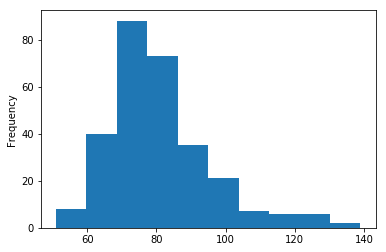

In [59]:
car_size_df[car_size_df['car_id'].isin(ids_train_split)].car_size.plot(kind='hist')

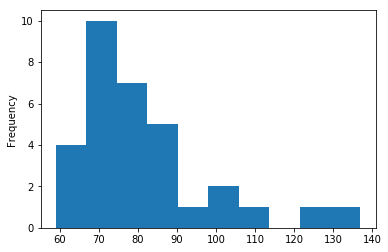

In [60]:
car_size_df[car_size_df['car_id'].isin(ids_valid_split)].car_size.plot(kind='hist')

In [61]:
car_size_df = pd.read_csv('car_size_df.csv')
ids_train_split, ids_valid_split = train_test_split(car_size_df.car_id, stratify=car_size_df['quantile'] , test_size=0.1, random_state=42)
ids_train_split = df_train[df_train.img.apply(lambda x: x[:-7]).isin(ids_train_split)].img
ids_valid_split = df_train[df_train.img.apply(lambda x: x[:-7]).isin(ids_valid_split)].img

In [62]:
ids_train_split.shape

(4576,)

In [63]:
ids_valid_split.shape

(512,)

In [8]:
import pandas as pd
from sklearn.model_selection import train_test_split

df_train = pd.read_csv('input/train_masks.csv')

# ids_train = df_train['img'].map(lambda s: s.split('.')[0])
# ids_train_split, ids_valid_split = train_test_split(ids_train, test_size=0.2, random_state=42)

car_size_df = pd.read_csv('car_size_df.csv')
ids_train_split, ids_valid_split = train_test_split(car_size_df.car_id, stratify=car_size_df['quantile'] , test_size=0.1, random_state=42)
ids_train_split = df_train[df_train.img.apply(lambda x: x[:-7]).isin(ids_train_split)].img.apply(lambda x: x[:-4])
ids_valid_split = df_train[df_train.img.apply(lambda x: x[:-7]).isin(ids_valid_split)].img.apply(lambda x: x[:-4])

In [9]:
y6 = mask
y5 = cv2.resize(mask, (int(orig_height/2), int((orig_width+2)/2)))
y4 = cv2.resize(mask, (int(orig_height/4), int((orig_width+2)/4)))
y3 = cv2.resize(mask, (int(orig_height/8), int((orig_width+2)/8)))
y2 = cv2.resize(mask, (int(orig_height/16), int((orig_width+2)/16)))
y1 = cv2.resize(mask, (int(orig_height/32), int((orig_width+2)/32)))
y0 = cv2.resize(mask, (int(orig_height/64), int((orig_width+2)/64)))

16      02159e548029_01
17      02159e548029_02
18      02159e548029_03
19      02159e548029_04
20      02159e548029_05
21      02159e548029_06
22      02159e548029_07
23      02159e548029_08
24      02159e548029_09
25      02159e548029_10
26      02159e548029_11
27      02159e548029_12
28      02159e548029_13
29      02159e548029_14
30      02159e548029_15
31      02159e548029_16
32      03a857ce842d_01
33      03a857ce842d_02
34      03a857ce842d_03
35      03a857ce842d_04
36      03a857ce842d_05
37      03a857ce842d_06
38      03a857ce842d_07
39      03a857ce842d_08
40      03a857ce842d_09
41      03a857ce842d_10
42      03a857ce842d_11
43      03a857ce842d_12
44      03a857ce842d_13
45      03a857ce842d_14
             ...       
5058    fecea3036c59_03
5059    fecea3036c59_04
5060    fecea3036c59_05
5061    fecea3036c59_06
5062    fecea3036c59_07
5063    fecea3036c59_08
5064    fecea3036c59_09
5065    fecea3036c59_10
5066    fecea3036c59_11
5067    fecea3036c59_12
5068    fecea303

# Check new generator

In [1]:
import cv2
import numpy as np
import pandas as pd
from skimage.io import imread

    
orig_width = 1918
orig_height = 1280

In [5]:
def randomHueSaturationValue(image, hue_shift_limit=(-180, 180),
                             sat_shift_limit=(-255, 255),
                             val_shift_limit=(-255, 255), u=0.5):
    if np.random.random() < u:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(image)
        hue_shift = np.random.uniform(hue_shift_limit[0], hue_shift_limit[1])
        h = cv2.add(h, hue_shift)
        sat_shift = np.random.uniform(sat_shift_limit[0], sat_shift_limit[1])
        s = cv2.add(s, sat_shift)
        val_shift = np.random.uniform(val_shift_limit[0], val_shift_limit[1])
        v = cv2.add(v, val_shift)
        image = cv2.merge((h, s, v))
        image = cv2.cvtColor(image, cv2.COLOR_HSV2BGR)

    return image


def randomHueSaturationValue_array(images, hue_shift_limit=(-180, 180),
                             sat_shift_limit=(-255, 255),
                             val_shift_limit=(-255, 255), u=0.5):
    
    if np.random.random() < u:
        
        hue_shift = np.random.uniform(hue_shift_limit[0], hue_shift_limit[1])
        sat_shift = np.random.uniform(sat_shift_limit[0], sat_shift_limit[1])
        val_shift = np.random.uniform(val_shift_limit[0], val_shift_limit[1])
        
        images_transform = [] 
        
        for image in images:
            
            image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
            h, s, v = cv2.split(image)
            h = cv2.add(h, hue_shift)
            s = cv2.add(s, sat_shift)
            v = cv2.add(v, val_shift)
            image = cv2.merge((h, s, v))
            image = cv2.cvtColor(image, cv2.COLOR_HSV2BGR)
            
            images_transform.append(image)

    return images_transform

def randomShiftScaleRotate_array(images, masks,
                           shift_limit=(-0.0625, 0.0625),
                           scale_limit=(-0.1, 0.1),
                           rotate_limit=(-45, 45), aspect_limit=(0, 0),
                           borderMode=cv2.BORDER_CONSTANT, u=0.5):
    if np.random.random() < u:
        height, width, channel = image.shape

        angle = np.random.uniform(rotate_limit[0], rotate_limit[1])  # degree
        scale = np.random.uniform(1 + scale_limit[0], 1 + scale_limit[1])
        aspect = np.random.uniform(1 + aspect_limit[0], 1 + aspect_limit[1])
        sx = scale * aspect / (aspect ** 0.5)
        sy = scale / (aspect ** 0.5)
        dx = round(np.random.uniform(shift_limit[0], shift_limit[1]) * width)
        dy = round(np.random.uniform(shift_limit[0], shift_limit[1]) * height)

        cc = np.math.cos(angle / 180 * np.math.pi) * sx
        ss = np.math.sin(angle / 180 * np.math.pi) * sy
        rotate_matrix = np.array([[cc, -ss], [ss, cc]])

        box0 = np.array([[0, 0], [width, 0], [width, height], [0, height], ])
        box1 = box0 - np.array([width / 2, height / 2])
        box1 = np.dot(box1, rotate_matrix.T) + np.array([width / 2 + dx, height / 2 + dy])

        box0 = box0.astype(np.float32)
        box1 = box1.astype(np.float32)
                
        mat = cv2.getPerspectiveTransform(box0, box1)
        
        images_transform = [] 
        masks_transform = []             
            
        for image in images:
            image = cv2.warpPerspective(image, mat, (width, height), flags=cv2.INTER_LINEAR, borderMode=borderMode,
                                        borderValue=(
                                            0, 0,
                                            0,))
            images_transform.append(image)
            
        for mask in masks:
            mask = cv2.warpPerspective(mask, mat, (width, height), flags=cv2.INTER_LINEAR, borderMode=borderMode,
                                       borderValue=(
                                           0, 0,
                                           0,))
            masks_transform.append(mask)
            
    return images_transform, masks_transform


def randomShiftScaleRotate(image, mask,
                           shift_limit=(-0.0625, 0.0625),
                           scale_limit=(-0.1, 0.1),
                           rotate_limit=(-45, 45), aspect_limit=(0, 0),
                           borderMode=cv2.BORDER_CONSTANT, u=0.5):
    if np.random.random() < u:
        height, width, channel = image.shape

        angle = np.random.uniform(rotate_limit[0], rotate_limit[1])  # degree
        scale = np.random.uniform(1 + scale_limit[0], 1 + scale_limit[1])
        aspect = np.random.uniform(1 + aspect_limit[0], 1 + aspect_limit[1])
        sx = scale * aspect / (aspect ** 0.5)
        sy = scale / (aspect ** 0.5)
        dx = round(np.random.uniform(shift_limit[0], shift_limit[1]) * width)
        dy = round(np.random.uniform(shift_limit[0], shift_limit[1]) * height)

        cc = np.math.cos(angle / 180 * np.math.pi) * sx
        ss = np.math.sin(angle / 180 * np.math.pi) * sy
        rotate_matrix = np.array([[cc, -ss], [ss, cc]])

        box0 = np.array([[0, 0], [width, 0], [width, height], [0, height], ])
        box1 = box0 - np.array([width / 2, height / 2])
        box1 = np.dot(box1, rotate_matrix.T) + np.array([width / 2 + dx, height / 2 + dy])

        box0 = box0.astype(np.float32)
        box1 = box1.astype(np.float32)
        mat = cv2.getPerspectiveTransform(box0, box1)
        image = cv2.warpPerspective(image, mat, (width, height), flags=cv2.INTER_LINEAR, borderMode=borderMode,
                                    borderValue=(
                                        0, 0,
                                        0,))
        mask = cv2.warpPerspective(mask, mat, (width, height), flags=cv2.INTER_LINEAR, borderMode=borderMode,
                                   borderValue=(
                                       0, 0,
                                       0,))

    return image, mask


def randomHorizontalFlip_array(images, masks, u=0.5):
    if np.random.random() < u:
        
        images_transform = [] 
        masks_transform = []   
        
        for image in images:
            image = cv2.flip(image, 1)
            images_transform.append(image)
            
        for mask in masks:
            mask = cv2.flip(mask, 1)
            masks_transform.append(mask)
            
    return images_transform, masks_transform        


def randomHorizontalFlip(image, mask, u=0.5):
    if np.random.random() < u:
        image = cv2.flip(image, 1)
        mask = cv2.flip(mask, 1)

    return image, mask


In [14]:
def train_generator():
    while True:
        for start in range(0, len(ids_train_split), batch_size):
            x_batch = []
            y_batch_6 = []
            y_batch_5 = []
            y_batch_4 = []
            y_batch_3 = []
            y_batch_2 = []
            y_batch_1 = []
            y_batch_0 = []
            
            end = min(start + batch_size, len(ids_train_split))
            ids_train_batch = ids_train_split[start:end]
            
            # c = 0
            for id in ids_train_batch.values:
                
                img = imread('input/train/{}.jpg'.format(id))
                img = cv2.resize(img, (orig_width+2,orig_height) )
                mask = imread('input/train_masks/{}_mask.png'.format(id))
                mask = cv2.resize(mask, (orig_width+2,orig_height) )
                img = randomHueSaturationValue(img,
                                               hue_shift_limit=(-50, 50),
                                               sat_shift_limit=(-5, 5),
                                               val_shift_limit=(-15, 15))
                img, mask = randomShiftScaleRotate(img, mask,
                                                   shift_limit=(-0.0625, 0.0625),
                                                   scale_limit=(-0.1, 0.1),
                                                   rotate_limit=(-0, 0))
                img, mask = randomHorizontalFlip(img, mask)
                mask = np.expand_dims(mask, axis=2)
              
                x_batch.append(img)
                
                y6 = mask
                y5 = cv2.resize(mask, (int((orig_width+2)/2), int((orig_height)/2)))
                y5 = np.expand_dims(y5, axis=2)
                y4 = cv2.resize(mask, (int((orig_width+2)/4), int((orig_height)/4)))
                y4 = np.expand_dims(y4, axis=2)
                y3 = cv2.resize(mask, (int((orig_width+2)/8), int((orig_height)/8)))
                y3 = np.expand_dims(y3, axis=2)
                y2 = cv2.resize(mask, (int((orig_width+2)/16), int((orig_height)/16)))
                y2 = np.expand_dims(y2, axis=2)
                y1 = cv2.resize(mask, (int((orig_width+2)/32), int((orig_height)/32)))
                y1 = np.expand_dims(y1, axis=2)
                y0 = cv2.resize(mask, (int((orig_width+2)/64), int((orig_height)/64)))
                y0 = np.expand_dims(y0, axis=2)
                
                y6 = np.array(y6, np.float32) / 255
                y5 = np.array(y5, np.float32) / 255
                y4 = np.array(y4, np.float32) / 255
                y3 = np.array(y3, np.float32) / 255
                y2 = np.array(y2, np.float32) / 255
                y1 = np.array(y1, np.float32) / 255
                y0 = np.array(y0, np.float32) / 255
                
                y_batch_6.append(y6)
                y_batch_5.append(y5)
                y_batch_4.append(y4)
                y_batch_3.append(y3)
                y_batch_2.append(y2)
                y_batch_1.append(y1)
                y_batch_0.append(y0)   
                
                # np.append (y_batch, np.asarray([y0,y1,y2,y3,y4,y5,y6]) )
                # y_batch[c] = [y0,y1,y2,y3,y4,y5,y6]
                # c += 1
            x_batch = np.array(x_batch, np.float32) / 255
            y_batch_6 = np.array(y_batch_6, np.float32) / 255
            y_batch_5 = np.array(y_batch_5, np.float32) / 255
            y_batch_4 = np.array(y_batch_4, np.float32) / 255
            y_batch_3 = np.array(y_batch_3, np.float32) / 255
            y_batch_2 = np.array(y_batch_2, np.float32) / 255
            y_batch_1 = np.array(y_batch_1, np.float32) / 255
            y_batch_0 = np.array(y_batch_0, np.float32) / 255   
            
            yield x_batch, [y_batch_6,y_batch_5,y_batch_4,y_batch_3,y_batch_2,y_batch_1,y_batch_0]

In [15]:
gen = train_generator()

In [141]:
gen = valid_generator()

In [2]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split

df_train = pd.read_csv('input/train_masks.csv')

# ids_train = df_train['img'].map(lambda s: s.split('.')[0])
# ids_train_split, ids_valid_split = train_test_split(ids_train, test_size=0.2, random_state=42)

car_size_df = pd.read_csv('car_size_df.csv')
ids_train_split, ids_valid_split = train_test_split(car_size_df.car_id, stratify=car_size_df['quantile'] , test_size=0.1, random_state=42)
ids_train_split = df_train[df_train.img.apply(lambda x: x[:-7]).isin(ids_train_split)].img.apply(lambda x: x[:-4])
ids_valid_split = df_train[df_train.img.apply(lambda x: x[:-7]).isin(ids_valid_split)].img.apply(lambda x: x[:-4])

In [43]:
batch_size = 4 
imgs, labels = next(gen)

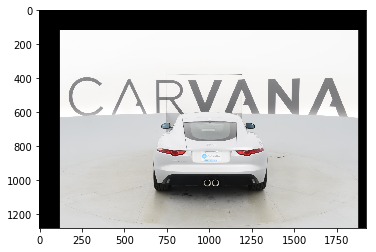

In [45]:
import matplotlib.pyplot as plt
%matplotlib inline

plt.imshow(imgs[0])


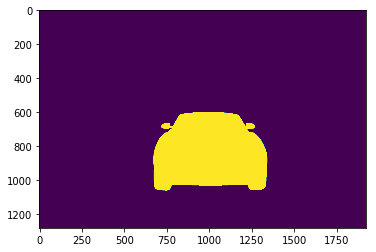

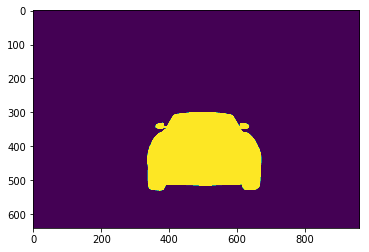

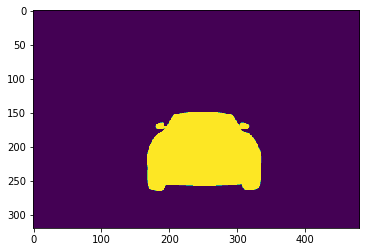

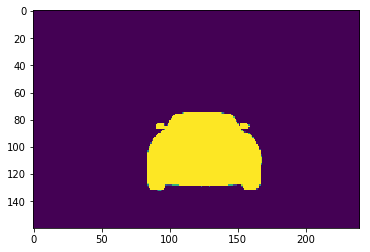

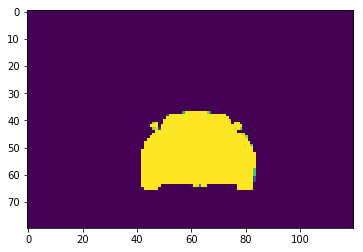

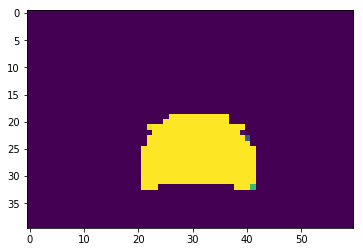

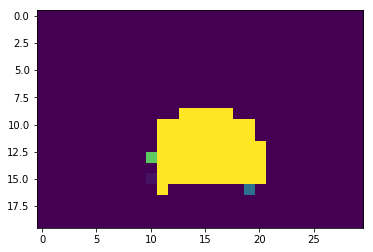

In [44]:
plt.imshow(labels[0][0][:,:,0])
plt.show()
plt.imshow(labels[1][0][:,:,0])
plt.show()
plt.imshow(labels[2][0][:,:,0])
plt.show()
plt.imshow(labels[3][0][:,:,0])
plt.show()
plt.imshow(labels[4][0][:,:,0])
plt.show()
plt.imshow(labels[5][0][:,:,0])
plt.show()
plt.imshow(labels[6][0][:,:,0])
plt.show()



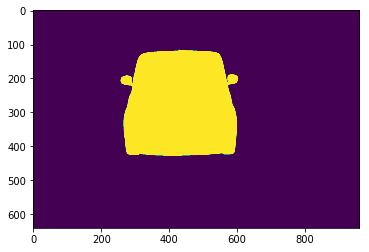

In [129]:
plt.imshow(masks5[0][:,:,0])

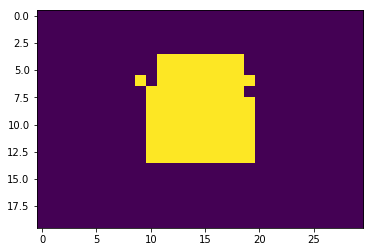

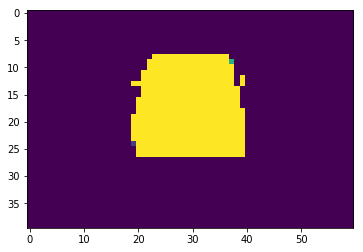

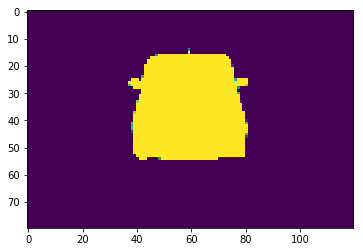

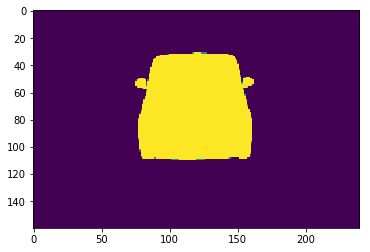

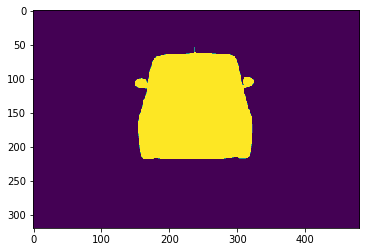

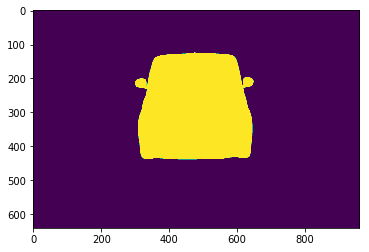

In [104]:
for i in range(0,6):
    plt.imshow(masks[0][i])
    plt.show()

In [140]:
def valid_generator():
    while True:
        for start in range(0, len(ids_valid_split), batch_size):
            x_batch = []
            y_batch_6 = []
            y_batch_5 = []
            y_batch_4 = []
            y_batch_3 = []
            y_batch_2 = []
            y_batch_1 = []
            y_batch_0 = []
            
            end = min(start + batch_size, len(ids_valid_split))
            ids_valid_batch = ids_valid_split[start:end]
            for id in ids_valid_batch.values:
                
                img = imread('input/train/{}.jpg'.format(id))
                img = cv2.resize(img, (orig_width+2,orig_height) )
                mask = imread('input/train_masks/{}_mask.png'.format(id))
                mask = cv2.resize(mask, (orig_width+2,orig_height) )
                img = randomHueSaturationValue(img,
                                               hue_shift_limit=(-50, 50),
                                               sat_shift_limit=(-5, 5),
                                               val_shift_limit=(-15, 15))
                img, mask = randomShiftScaleRotate(img, mask,
                                                   shift_limit=(-0.0625, 0.0625),
                                                   scale_limit=(-0.1, 0.1),
                                                   rotate_limit=(-0, 0))
                img, mask = randomHorizontalFlip(img, mask)
                mask = np.expand_dims(mask, axis=2)
              
                x_batch.append(img)
                
                y6 = mask
                y5 = cv2.resize(mask, (int((orig_width+2)/2), int((orig_height)/2)))
                y5 = np.expand_dims(y5, axis=2)
                y4 = cv2.resize(mask, (int((orig_width+2)/4), int((orig_height)/4)))
                y4 = np.expand_dims(y4, axis=2)
                y3 = cv2.resize(mask, (int((orig_width+2)/8), int((orig_height)/8)))
                y3 = np.expand_dims(y3, axis=2)
                y2 = cv2.resize(mask, (int((orig_width+2)/16), int((orig_height)/16)))
                y2 = np.expand_dims(y2, axis=2)
                y1 = cv2.resize(mask, (int((orig_width+2)/32), int((orig_height)/32)))
                y1 = np.expand_dims(y1, axis=2)
                y0 = cv2.resize(mask, (int((orig_width+2)/64), int((orig_height)/64)))
                y0 = np.expand_dims(y0, axis=2)
                
                y6 = np.array(y6, np.float32) / 255
                y5 = np.array(y5, np.float32) / 255
                y4 = np.array(y4, np.float32) / 255
                y3 = np.array(y3, np.float32) / 255
                y2 = np.array(y2, np.float32) / 255
                y1 = np.array(y1, np.float32) / 255
                y0 = np.array(y0, np.float32) / 255
                
                y_batch_6.append(y6)
                y_batch_5.append(y5)
                y_batch_4.append(y4)
                y_batch_3.append(y3)
                y_batch_2.append(y2)
                y_batch_1.append(y1)
                y_batch_0.append(y0)   
                
                # np.append (y_batch, np.asarray([y0,y1,y2,y3,y4,y5,y6]) )
                # y_batch[c] = [y0,y1,y2,y3,y4,y5,y6]
                # c += 1
            x_batch = np.array(x_batch, np.float32) / 255
            y_batch_6 = np.array(y_batch_6, np.float32) / 255
            y_batch_5 = np.array(y_batch_5, np.float32) / 255
            y_batch_4 = np.array(y_batch_4, np.float32) / 255
            y_batch_3 = np.array(y_batch_3, np.float32) / 255
            y_batch_2 = np.array(y_batch_2, np.float32) / 255
            y_batch_1 = np.array(y_batch_1, np.float32) / 255
            y_batch_0 = np.array(y_batch_0, np.float32) / 255              
            
            yield x_batch, [y_batch_6,y_batch_5,y_batch_4,y_batch_3,y_batch_2,y_batch_1,y_batch_0]


In [ ]:
(int(orig_width/32), int((orig_height+2)/32)

In [63]:
masks[0][6].shape

(1280, 1920, 1)

In [65]:
A=
A

array(None, dtype=object)

In [83]:
y_batch = np.empty((4,),dtype=object)
y_batch.shape

(4,)

In [90]:
A=np.empty((3,),dtype=object)

for i,v in enumerate(A):
    print(i)
    # A[i]=[v,i]
    

    
    

0
1
2


# Try ttl

In [15]:
for ttl in range(8):
    print (ttl)

0
1
2
3
4
5
6
7


In [20]:
import pandas as pd
import cv2

df_test = pd.read_csv('input/sample_submission.csv')
ids_test = df_test['img'].map(lambda s: s.split('.')[0])

batch_size = 4

orig_width = 1918
orig_height = 1280


for start in range(0, len(ids_test), batch_size):
    x_batch = []
    end = min(start + batch_size, len(ids_test))
    ids_test_batch = ids_test[start:end]
    for id in ids_test_batch.values:
        img = cv2.imread('input/test/{}.jpg'.format(id))
        img = cv2.resize(img, (orig_width+2,orig_height))
        x_batch.append(img)
    x_batch = np.array(x_batch, np.float32) # / 255
    break
    # q.put(x_batch)


In [21]:
for i in range(x_batch.shape[0]):
    print (x_batch[i,...].shape)

(1280, 1920, 3)
(1280, 1920, 3)
(1280, 1920, 3)
(1280, 1920, 3)


In [9]:
x_batch.shape

(4, 1920, 1280, 3)

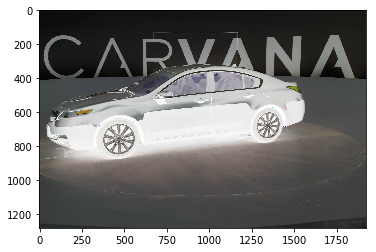

In [25]:
import matplotlib.pyplot as plt

plt.imshow(x_batch[3,...])
plt.show()

In [4]:
import numpy as npa

a = np.array([[1,2],[3,4],[5,6]])

for (x,y), value in np.ndenumerate(a):
    print (x,y)

0 0
0 1
1 0
1 1
2 0
2 1


In [15]:
(imgs_final - imgs[...,0]).sum()

-1643275.2430442176

In [23]:
(imgs1-imgs4).sum()

-14.508726

In [33]:
imgs[3,...]

array([[  1.75043696e-05,   4.23225826e-06,   2.52862346e-06, ...,
          5.41724526e-06,   9.86451170e-06,   3.58083695e-05],
       [  4.08853959e-05,   6.19840903e-06,   2.93090596e-06, ...,
          1.27614736e-06,   3.80340958e-06,   9.66014750e-06],
       [  8.50560700e-06,   4.42984732e-06,   1.62004568e-06, ...,
          5.72100533e-07,   2.08424382e-06,   7.60045797e-06],
       ..., 
       [  1.07811952e-05,   1.97420860e-06,   5.71091626e-07, ...,
          1.12012847e-06,   2.55605797e-06,   2.11039406e-05],
       [  2.80293926e-05,   5.72532738e-06,   1.55806228e-06, ...,
          1.43157602e-06,   4.10562563e-06,   2.77897818e-05],
       [  6.25169943e-05,   1.45535090e-05,   5.81449897e-06, ...,
          6.09737321e-06,   2.20024772e-05,   4.04514685e-05]])

In [36]:
imgs.shape

(1280, 1918)

In [44]:
(mask * 255).sum()

0

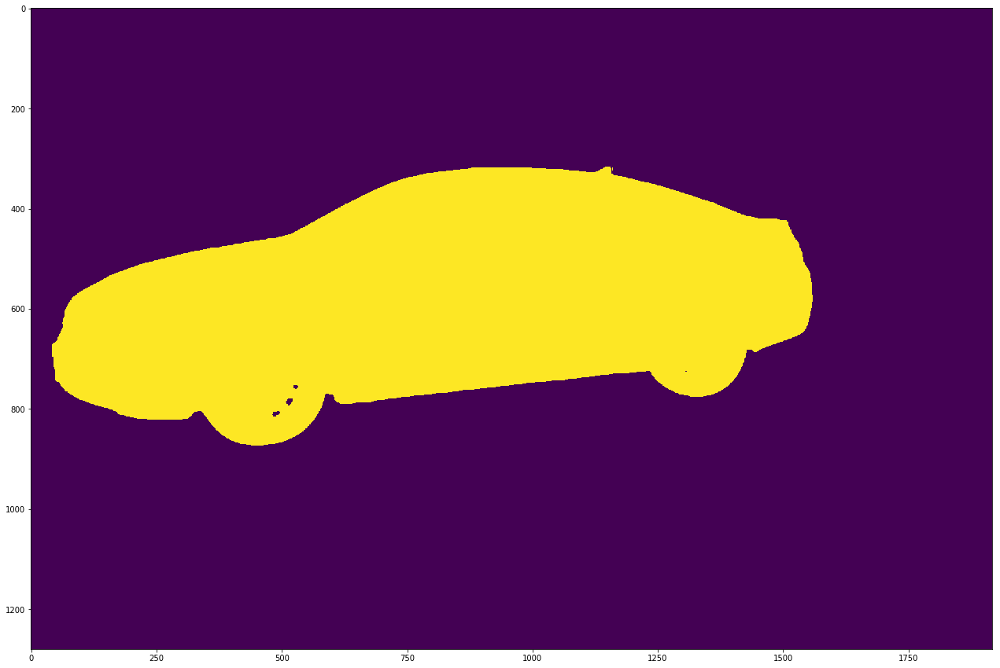

In [67]:
mask = np.load('mask_full_3.npy')
plt.figure(figsize=(30,15))
plt.imshow(mask)
plt.show()

In [51]:
(imgs_final[0,...]>0.1 * 1).sum()

385379

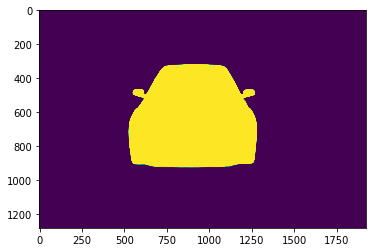

In [54]:
imgs_final = np.load('preds_full.npy')
plt.imshow(imgs_final[0,...])
plt.show()


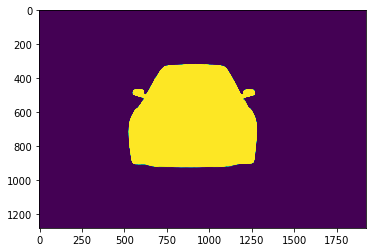

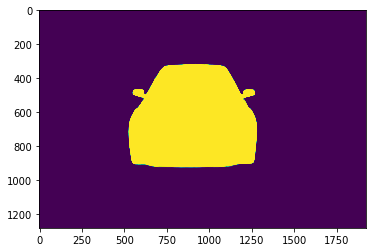

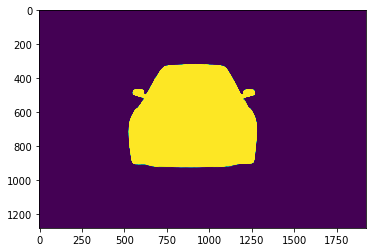

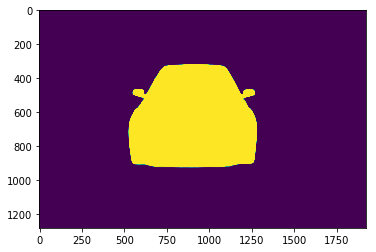

In [57]:
import numpy as np
imgs1 = np.load('preds_tta_0.npy')
plt.imshow(imgs1[0,...,0])
plt.show()

imgs2 = np.load('preds_tta_1.npy')
plt.imshow(imgs2[0,...,0])
plt.show()

imgs3 = np.load('preds_tta_2.npy')
plt.imshow(imgs3[0,...,0])
plt.show()

imgs4 = np.load('preds_tta_3.npy')
plt.imshow(imgs4[0,...,0])
plt.show()



In [61]:
print ((imgs1 - imgs1).sum())
print ((imgs1 - imgs2).sum())
print ((imgs1 - imgs3).sum())
print ((imgs1 - imgs4).sum())
print ((imgs1[...,0] - imgs_final).sum())


0.0
-52.5059
3.03147
23.1407
14.0156619959


In [30]:
print ((imgs1 - imgs4).sum())
(imgs1[1,...] - imgs2[1,...]).sum()

-107286.76296361792

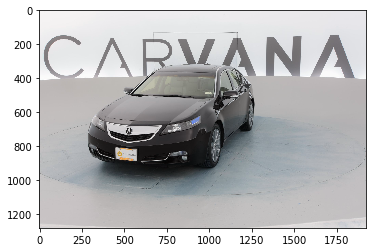

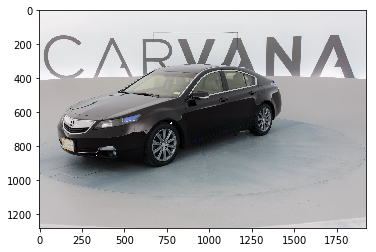

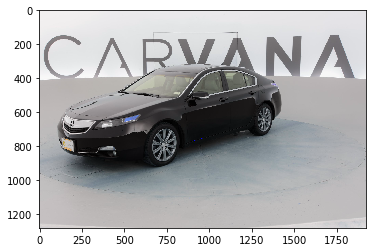

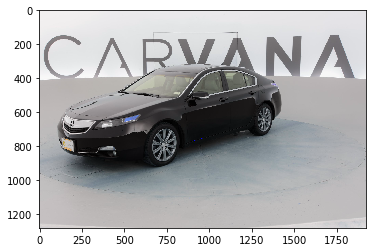

In [28]:
import numpy as np
imgs1 = np.load('batch_test_0.npy')
plt.imshow(imgs1[1,...])
plt.show()

imgs2 = np.load('batch_test_1.npy')
plt.imshow(imgs2[2,...])
plt.show()

imgs3 = np.load('batch_test_2.npy')
plt.imshow(imgs3[2,...])
plt.show()

imgs4 = np.load('batch_test_3.npy')
plt.imshow(imgs4[2,...])
plt.show()



In [3]:
imgs.shape

(4, 1280, 1920, 3)

In [50]:
imgs[1,...].max()

-2.9660807e-09

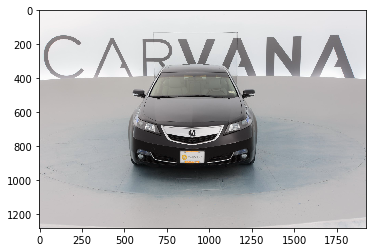

In [5]:
import matplotlib.pyplot as plt



In [ ]:
for 

In [4]:
import tensorflow as tf
import cv2
import numpy as np
import pandas as pd
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint, TensorBoard
from sklearn.model_selection import train_test_split
from tools.multi_gpu import *
from keras.optimizers import RMSprop
from model.losses import bce_dice_loss, dice_loss, weighted_bce_dice_loss, weighted_dice_loss, dice_coeff
from keras import backend as K
from skimage.io import imread
from tools.clr_callback import *
import params

orig_width = 1918
orig_height = 1280

batch_size = 2 * 1
model = params.model_factory_selu(input_shape=(orig_height, orig_width+2, 3), num_classes=1)
model = make_parallel(model, gpu_count=2)
model.load_weights('weights/1024_unet_selu_final.hdf5')
model.compile(optimizer=RMSprop(lr=0.0001), loss=bce_dice_loss, metrics=[dice_coeff])



/home/av/cars/Kaggle-Carvana-Image-Masking-Challenge/tools/multi_gpu.py:44: UserWarning: The `merge` function is deprecated and will be removed after 08/2017. Use instead layers from `keras.layers.merge`, e.g. `add`, `concatenate`, etc.
  merged.append(merge(outputs, mode='concat', concat_axis=0))
/usr/local/lib/python3.5/dist-packages/keras/legacy/layers.py:458: UserWarning: The `Merge` layer is deprecated and will be removed after 08/2017. Use instead layers from `keras.layers.merge`, e.g. `add`, `concatenate`, etc.
  name=name)
/home/av/cars/Kaggle-Carvana-Image-Masking-Challenge/tools/multi_gpu.py:46: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=[<tf.Tenso..., inputs=[<tf.Tenso...)`
  return Model(input=model.inputs, output=merged)


In [3]:
5%4

1

In [174]:
df.loc[2].values

array(['(-5, -5, -3)', 0.99617207050323486], dtype=object)

In [1]:
import pandas as pd
df = pd.read_csv('aug_log.csv')

FileNotFoundError: File b'aug_log.csv' does not exist

In [ ]:
from model.losses import bce_dice_loss, dice_loss, weighted_bce_dice_loss, weighted_dice_loss, dice_coeff

i = 0
sess = tf.Session()

df = pd.DataFrame(columns=['hue','sat','val','dice'])

for hue in range(-5,5,1):
    for sat in range(-5,5,1):
        for val in range(-5,5,1):
            
            x_batch_aug = np.zeros((2,orig_height,orig_width+2,3))
            for i in range(x_batch.shape[0]):
                x_batch_aug[i,...] = randomHueSaturationValue(x_batch[i,...],
                                                          hue_shift_limit=(hue, hue+0.1),
                                                          sat_shift_limit=(sat, sat+0.1),
                                                          val_shift_limit=(val, val+0.1), u=1)
                x_batch_aug[i,...] =  x_batch_aug[i,...] / 255    
        
        
            test_pred = model.predict(x_batch_aug)     

            with sess.as_default():
                dice_value = dice_coeff(test_pred[0,...,0],y_batch[0]).eval()
            
            df.loc[i] = [hue,sat,val,dice_value]
            
            print('Augs {} yield dice value : {}'. format ((hue,sat,val),dice_value))
            i += 1

df.to_csv('aug_log.csv')
            

Augs (-5, -5, -5) yield dice value : 0.3753849267959595
Augs (-5, -5, -4) yield dice value : 0.37229299545288086
Augs (-5, -5, -3) yield dice value : 0.3706528842449188
Augs (-5, -5, -2) yield dice value : 0.3702288568019867
Augs (-5, -5, -1) yield dice value : 0.36863863468170166
Augs (-5, -5, 0) yield dice value : 0.3674124479293823
Augs (-5, -5, 1) yield dice value : 0.3661838173866272
Augs (-5, -5, 2) yield dice value : 0.3660462200641632
Augs (-5, -5, 3) yield dice value : 0.3637859523296356
Augs (-5, -5, 4) yield dice value : 0.3634136915206909
Augs (-5, -4, -5) yield dice value : 0.4053512215614319
Augs (-5, -4, -4) yield dice value : 0.39913398027420044
Augs (-5, -4, -3) yield dice value : 0.39719662070274353
Augs (-5, -4, -2) yield dice value : 0.39478838443756104
Augs (-5, -4, -1) yield dice value : 0.39202964305877686
Augs (-5, -4, 0) yield dice value : 0.3889451026916504
Augs (-5, -4, 1) yield dice value : 0.38698795437812805
Augs (-5, -4, 2) yield dice value : 0.3863282501

Augs (-4, -1, 4) yield dice value : 0.6081521511077881
Augs (-4, 0, -5) yield dice value : 0.9959237575531006
Augs (-4, 0, -4) yield dice value : 0.9961865544319153
Augs (-4, 0, -3) yield dice value : 0.9961203932762146
Augs (-4, 0, -2) yield dice value : 0.9961004853248596
Augs (-4, 0, -1) yield dice value : 0.996044933795929
Augs (-4, 0, 0) yield dice value : 0.9961786866188049
Augs (-4, 0, 1) yield dice value : 0.9959468841552734
Augs (-4, 0, 2) yield dice value : 0.9961711764335632
Augs (-4, 0, 3) yield dice value : 0.9961292743682861
Augs (-4, 0, 4) yield dice value : 0.9960101842880249
Augs (-4, 1, -5) yield dice value : 0.7308965921401978
Augs (-4, 1, -4) yield dice value : 0.7069960236549377
Augs (-4, 1, -3) yield dice value : 0.7134427428245544
Augs (-4, 1, -2) yield dice value : 0.700481653213501
Augs (-4, 1, -1) yield dice value : 0.7302361726760864
Augs (-4, 1, 0) yield dice value : 0.7295443415641785
Augs (-4, 1, 1) yield dice value : 0.7069648504257202
Augs (-4, 1, 2) yie

In [165]:
dice_coeff(test_pred[0,...,0],y_batch[0])

TypeError: 'numpy.float32' object is not callable

In [160]:
sess = tf.Session()

with sess.as_default():
    dice_coeff = dice_coeff(test_pred[0,...,0],y_batch[0]).eval()

TypeError: 'numpy.float32' object is not callable

In [153]:
dice_coeff

0.99617207

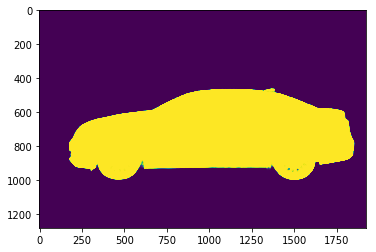

In [143]:
plt.imshow(test_pred[0,...,0])
plt.show()

In [4]:
import pandas as pd

df = pd.read_csv('aug_log_no_sat_1.csv')
df1 = pd.read_csv('aug_log_no_sat.csv')

df = df.append(df1)


df.shape

(421, 4)

In [14]:
df.to_csv('test_tta.csv')

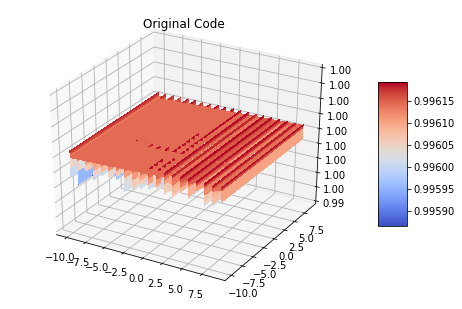

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

## Matplotlib Sample Code using 2D arrays via meshgrid
X = df.hue.values
Y = df.val.values
X, Y = np.meshgrid(X, Y)

Z = df.dice.values
fig = plt.figure()
ax = Axes3D(fig)
surf = ax.plot_surface(X, Y, Z, rstride=1, cstride=1, cmap=cm.coolwarm,
                       linewidth=0, antialiased=False)
ax.set_zlim(0.995, 0.997)

ax.zaxis.set_major_locator(LinearLocator(10))
ax.zaxis.set_major_formatter(FormatStrFormatter('%.02f'))

fig.colorbar(surf, shrink=0.5, aspect=5)
plt.title('Original Code')
plt.show()

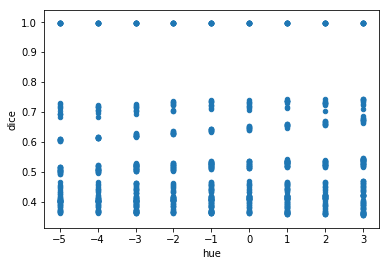

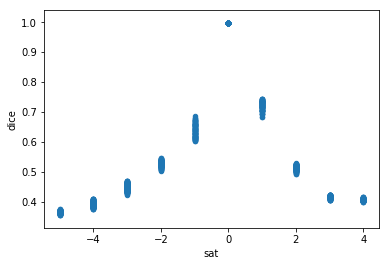

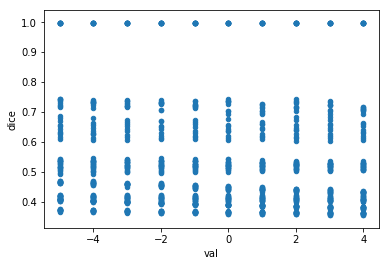

In [15]:
import matplotlib.pyplot as plt
df.plot.scatter(x='hue', y='dice')
plt.show()
df.plot.scatter(x='sat', y='dice')
plt.show()
df.plot.scatter(x='val', y='dice')
plt.show()

In [18]:
df.sort_values(by='dice',ascending=False).to_csv('test.csv')

In [2]:
from skimage.io import imread
x_batch = []
y_batch = []

orig_width = 1918
orig_height = 1280

img1 = imread('input/train/{}.jpg'.format('00087a6bd4dc_05'))
img1 = cv2.resize(img1, (orig_width+2,orig_height))
img2 = imread('input/train/{}.jpg'.format('00087a6bd4dc_06'))
img2 = cv2.resize(img2, (orig_width+2,orig_height))

mask1 = imread('input/train_masks/{}_mask.png'.format('00087a6bd4dc_05'))
mask1 = cv2.resize(mask1, (orig_width+2,orig_height))
mask2 = imread('input/train_masks/{}_mask.png'.format('00087a6bd4dc_06'))
mask2 = cv2.resize(mask2, (orig_width+2,orig_height))

x_batch.append(img1)
x_batch.append(img2)

y_batch.append(mask1)
y_batch.append(mask2)

x_batch = np.array(x_batch, np.float32) 
y_batch = np.array(y_batch, np.float32) / 255
            

NameError: name 'df' is not defined

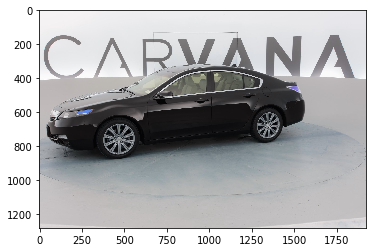

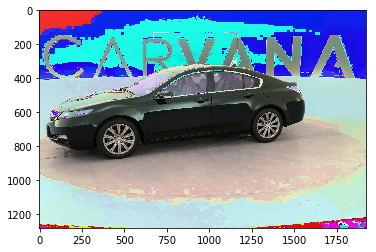

In [122]:
i = 3

plt.imshow(x_batch[i,...]/255)
plt.show()
plt.imshow(randomHueSaturationValue(x_batch[i,...],
                                                  hue_shift_limit=(-1, 1),
                                                  sat_shift_limit=(-0.5, 0),
                                                  val_shift_limit=(-1, 1),u=1)/255)

plt.show()

In [6]:
def randomHueSaturationValue(image, hue_shift_limit=(-180, 180),
                             sat_shift_limit=(-255, 255),
                             val_shift_limit=(-255, 255), u=0.5):
    if np.random.random() < u:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(image)
        hue_shift = np.random.uniform(hue_shift_limit[0], hue_shift_limit[1])
        h = cv2.add(h, hue_shift)
        sat_shift = np.random.uniform(sat_shift_limit[0], sat_shift_limit[1])
        s = cv2.add(s, sat_shift)
        val_shift = np.random.uniform(val_shift_limit[0], val_shift_limit[1])
        v = cv2.add(v, val_shift)
        image = cv2.merge((h, s, v))
        image = cv2.cvtColor(image, cv2.COLOR_HSV2BGR)

    return image

In [ ]:
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import numpy as np

batch_size = 4 

orig_width = 1918
orig_height = 1280

df_test = pd.read_csv('input/sample_submission.csv')
ids_test = df_test['img'].map(lambda s: s.split('.')[0])

def randomHueSaturationValue(image, hue_shift_limit=(-180, 180),
                             sat_shift_limit=(-255, 255),
                             val_shift_limit=(-255, 255), u=0.5):
    if np.random.random() < u:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(image)
        hue_shift = np.random.uniform(hue_shift_limit[0], hue_shift_limit[1])
        h = cv2.add(h, hue_shift)
        sat_shift = np.random.uniform(sat_shift_limit[0], sat_shift_limit[1])
        s = cv2.add(s, sat_shift)
        val_shift = np.random.uniform(val_shift_limit[0], val_shift_limit[1])
        v = cv2.add(v, val_shift)
        image = cv2.merge((h, s, v))
        image = cv2.cvtColor(image, cv2.COLOR_HSV2BGR)

    return image



for start in range(0, len(ids_test), batch_size):
    x_batch = []
    end = min(start + batch_size, len(ids_test))
    ids_test_batch = ids_test[start:end]
    for id in ids_test_batch.values:
        img = cv2.imread('input/test/{}.jpg'.format(id))
        img = cv2.resize(img, (orig_width+2,orig_height))
        x_batch.append(img)
        plt.imshow(img)
        plt.show()
    x_batch = np.array(x_batch, np.float32) # / 255
    break
# for ttl in range(ttl_num):

for tta in range(0,8):
    x_batch_aug = np.zeros((4,orig_height,orig_width+2,3))
    for i in range(x_batch.shape[0]):
        print(i)
        x_batch_aug[i,...] = randomHueSaturationValue(x_batch[i,...],
                                                  hue_shift_limit=(-5, 5),
                                                  sat_shift_limit=(-5, 5),
                                                  val_shift_limit=(-15, 15))
        x_batch_aug[i,...] =  x_batch_aug[i,...] / 255      
        plt.imshow(x_batch_aug[i,...])
        plt.show()        




# Test other augmentations for ttl

In [3]:
from skimage.io import imread
import cv2
import numpy as np

x_batch = []
y_batch = []

orig_width = 1918
orig_height = 1280

img1 = imread('input/train/{}.jpg'.format('00087a6bd4dc_05'))
img1 = cv2.resize(img1, (orig_width+2,orig_height))
img2 = imread('input/train/{}.jpg'.format('00087a6bd4dc_06'))
img2 = cv2.resize(img2, (orig_width+2,orig_height))

mask1 = imread('input/train_masks/{}_mask.png'.format('00087a6bd4dc_05'))
mask1 = cv2.resize(mask1, (orig_width+2,orig_height))
mask2 = imread('input/train_masks/{}_mask.png'.format('00087a6bd4dc_06'))
mask2 = cv2.resize(mask2, (orig_width+2,orig_height))

x_batch.append(img1)
x_batch.append(img2)

y_batch.append(mask1)
y_batch.append(mask2)

x_batch = np.array(x_batch, np.float32) 
y_batch = np.array(y_batch, np.float32) / 255

In [37]:
def randomCrop(image,mask):
    w_crop = np.random.randint(0, high=orig_width-crop_size, size=1)
    h_crop = np.random.randint(0, high=orig_height-crop_size, size=1)

    return image[int(h_crop):int(h_crop+crop_size),int(h_crop):int(h_crop+crop_size),...],mask[int(h_crop):int(h_crop+crop_size),int(h_crop):int(h_crop+crop_size)]

NameError: name 'w_crop' is not defined

In [26]:
x_batch[1,...][166:166+512,753:753+512,...].shape

(512, 512, 3)

In [38]:
crop_size = 512
randomCrop(x_batch[1,...],y_batch[1,...])

(array([[[ 239.,  239.,  237.],
         [ 239.,  239.,  237.],
         [ 239.,  239.,  237.],
         ..., 
         [ 233.,  233.,  231.],
         [ 233.,  233.,  231.],
         [ 233.,  233.,  231.]],
 
        [[ 239.,  239.,  237.],
         [ 239.,  239.,  237.],
         [ 239.,  239.,  237.],
         ..., 
         [ 233.,  233.,  231.],
         [ 233.,  233.,  231.],
         [ 233.,  233.,  231.]],
 
        [[ 239.,  239.,  237.],
         [ 239.,  239.,  237.],
         [ 239.,  239.,  237.],
         ..., 
         [ 233.,  233.,  231.],
         [ 233.,  233.,  231.],
         [ 233.,  233.,  231.]],
 
        ..., 
        [[ 151.,  155.,  158.],
         [ 151.,  155.,  158.],
         [ 151.,  155.,  158.],
         ..., 
         [   4.,    4.,    6.],
         [   5.,    5.,    7.],
         [   5.,    5.,    7.]],
 
        [[ 151.,  155.,  158.],
         [ 151.,  155.,  158.],
         [ 151.,  155.,  158.],
         ..., 
         [   4.,    4.,    6.],
   

In [7]:
y_batch.shape

(2, 1280, 1920)

In [6]:
import imgaug as ia
from imgaug import augmenters as iaa
import numpy as np

ia.seed(1)

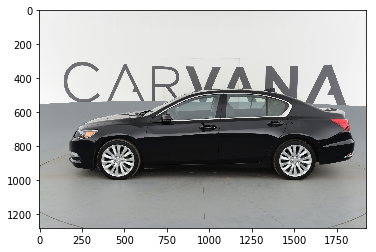

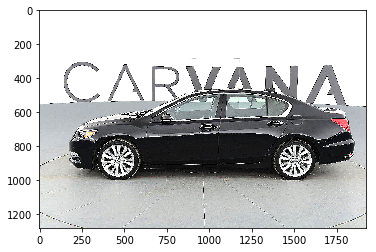

In [28]:
import matplotlib.pyplot as plt

seq = iaa.Sequential(
    [
        iaa.Sharpen(alpha=(0, 1.0), lightness=(1, 1.5)),

    ],
    # do all of the above augmentations in random order
    random_order=False
)

images_aug = seq.augment_images(x_batch)
plt.imshow(x_batch[0,...]/255)
plt.show()
plt.imshow(images_aug[0,...]/255)
plt.show()

In [ ]:
# Sometimes(0.5, ...) applies the given augmenter in 50% of all cases,
# e.g. Sometimes(0.5, GaussianBlur(0.3)) would blur roughly every second
# image.
sometimes = lambda aug: iaa.Sometimes(1, aug)

# Define our sequence of augmentation steps that will be applied to every image.
seq = iaa.Sequential(
    [
        #
        # Apply the following augmenters to most images.
        #
        # iaa.Fliplr(0.5), # horizontally flip 50% of all images
        # iaa.Flipud(0.2), # vertically flip 20% of all images

        # crop some of the images by 0-10% of their height/width
        # sometimes(iaa.Crop(percent=(0, 0.1))),

        # Apply affine transformations to some of the images
        # - scale to 80-120% of image height/width (each axis independently)
        # - translate by -20 to +20 relative to height/width (per axis)
        # - rotate by -45 to +45 degrees
        # - shear by -16 to +16 degrees
        # - order: use nearest neighbour or bilinear interpolation (fast)
        # - mode: use any available mode to fill newly created pixels
        #         see API or scikit-image for which modes are available
        # - cval: if the mode is constant, then use a random brightness
        #         for the newly created pixels (e.g. sometimes black,
        #         sometimes white)
        # sometimes(iaa.Affine(
        #    scale={"x": (0.8, 1.2), "y": (0.8, 1.2)},
        #    translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)},
        #    rotate=(-45, 45),
        #    shear=(-16, 16),
        #    order=[0, 1],
        #    cval=(0, 255),
        #    mode=ia.ALL
        #)),

        #
        # Execute 0 to 5 of the following (less important) augmenters per
        # image. Don't execute all of them, as that would often be way too
        # strong.
        #
        iaa.SomeOf((0, 5),
            [
                # Convert some images into their superpixel representation,
                # sample between 20 and 200 superpixels per image, but do
                # not replace all superpixels with their average, only
                # some of them (p_replace).
                sometimes(
                    iaa.Superpixels(
                        p_replace=(0, 1.0),
                        n_segments=(20, 200)
                    )
                ),

                # Blur each image with varying strength using
                # gaussian blur (sigma between 0 and 3.0),
                # average/uniform blur (kernel size between 2x2 and 7x7)
                # median blur (kernel size between 3x3 and 11x11).
                iaa.OneOf([
                    iaa.GaussianBlur((0, 3.0)),
                    iaa.AverageBlur(k=(2, 7)),
                    iaa.MedianBlur(k=(3, 11)),
                ]),

                # Sharpen each image, overlay the result with the original
                # image using an alpha between 0 (no sharpening) and 1
                # (full sharpening effect).
                iaa.Sharpen(alpha=(0, 1.0), lightness=(0.75, 1.5)),

                # Same as sharpen, but for an embossing effect.
                iaa.Emboss(alpha=(0, 1.0), strength=(0, 2.0)),

                # Search in some images either for all edges or for
                # directed edges. These edges are then marked in a black
                # and white image and overlayed with the original image
                # using an alpha of 0 to 0.7.
                sometimes(iaa.OneOf([
                    iaa.EdgeDetect(alpha=(0, 0.7)),
                    iaa.DirectedEdgeDetect(
                        alpha=(0, 0.7), direction=(0.0, 1.0)
                    ),
                ])),

                # Add gaussian noise to some images.
                # In 50% of these cases, the noise is randomly sampled per
                # channel and pixel.
                # In the other 50% of all cases it is sampled once per
                # pixel (i.e. brightness change).
                iaa.AdditiveGaussianNoise(
                    loc=0, scale=(0.0, 0.05*255), per_channel=0.5
                ),

                # Either drop randomly 1 to 10% of all pixels (i.e. set
                # them to black) or drop them on an image with 2-5% percent
                # of the original size, leading to large dropped
                # rectangles.
                iaa.OneOf([
                    iaa.Dropout((0.01, 0.1), per_channel=0.5),
                    iaa.CoarseDropout(
                        (0.03, 0.15), size_percent=(0.02, 0.05),
                        per_channel=0.2
                    ),
                ]),

                # Invert each image's chanell with 5% probability.
                # This sets each pixel value v to 255-v.
                iaa.Invert(0.05, per_channel=True), # invert color channels

                # Add a value of -10 to 10 to each pixel.
                iaa.Add((-10, 10), per_channel=0.5),

                # Change brightness of images (50-150% of original value).
                iaa.Multiply((0.5, 1.5), per_channel=0.5),

                # Improve or worsen the contrast of images.
                iaa.ContrastNormalization((0.5, 2.0), per_channel=0.5),

                # Convert each image to grayscale and then overlay the
                # result with the original with random alpha. I.e. remove
                # colors with varying strengths.
                iaa.Grayscale(alpha=(0.0, 1.0)),

                # In some images move pixels locally around (with random
                # strengths).
                sometimes(
                    iaa.ElasticTransformation(alpha=(0.5, 3.5), sigma=0.25)
                ),

                # In some images distort local areas with varying strength.
                sometimes(iaa.PiecewiseAffine(scale=(0.01, 0.05)))
            ],
            # do all of the above augmentations in random order
            random_order=True
        )
    ],
    # do all of the above augmentations in random order
    random_order=True
)

images_aug = seq.augment_images(images)

In [ ]:
1+1

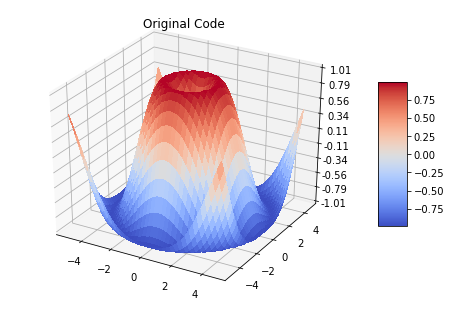

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

## Matplotlib Sample Code using 2D arrays via meshgrid
X = np.arange(-5, 5, 0.25)
Y = np.arange(-5, 5, 0.25)
X, Y = np.meshgrid(X, Y)
R = np.sqrt(X ** 2 + Y ** 2)
Z = np.sin(R)
fig = plt.figure()
ax = Axes3D(fig)
surf = ax.plot_surface(X, Y, Z, rstride=1, cstride=1, cmap=cm.coolwarm,
                       linewidth=0, antialiased=False)
ax.set_zlim(-1.01, 1.01)

ax.zaxis.set_major_locator(LinearLocator(10))
ax.zaxis.set_major_formatter(FormatStrFormatter('%.02f'))

fig.colorbar(surf, shrink=0.5, aspect=5)
plt.title('Original Code')
plt.show()

# Test segnet with imagenet weights

In [4]:
donor_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 1920, 1280, 3)     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 1920, 1280, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 1920, 1280, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 960, 640, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 960, 640, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 960, 640, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 480, 320, 128)     0         
__________

In [5]:
segnet.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_2 (InputLayer)             (None, 1920, 1280, 3) 0                                            
____________________________________________________________________________________________________
f1_conv_1 (Conv2D)               (None, 1920, 1280, 64 1792        input_2[0][0]                    
____________________________________________________________________________________________________
batch_normalization_1 (BatchNorm (None, 1920, 1280, 64 256         f1_conv_1[0][0]                  
____________________________________________________________________________________________________
activation_1 (Activation)        (None, 1920, 1280, 64 0           batch_normalization_1[0][0]      
___________________________________________________________________________________________

In [1]:
from keras.applications import VGG16
import params

donor_model = VGG16(weights='imagenet', include_top=False, input_shape=(1920,1280, 3))
segnet = params.get_segnet()

donor_weights_dict = {
'block1_conv1' : 'f1_conv_1',
'block1_conv2' : 'f1_conv_2',
    
'block2_conv1' : 'f2_conv_1',
'block2_conv2' : 'f2_conv_2',
    
'block3_conv1' : 'f3_conv_1',
'block3_conv2' : 'f3_conv_2',
'block3_conv3' : 'f3_conv_3',
    
'block4_conv1' : 'f4_conv_1',
'block4_conv2' : 'f4_conv_2',
'block4_conv3' : 'f4_conv_3'
}

donor_weights_list = [
'block1_conv1',
'block1_conv2', 
    
'block2_conv1',    
'block2_conv2', 
    
'block3_conv1',
'block3_conv2',
'block3_conv3',
    
'block4_conv1',
'block4_conv2',
'block4_conv3',        
]


for layer in donor_model.layers:
    #if type(layer) is keras.engine.training.Model:
    #    for inner_layer in layer.layers:
    if layer.name in donor_weights_list:
        print(layer.name)
        segnet.get_layer(donor_weights_dict[layer.name]).set_weights(layer.get_weights())
        segnet.get_layer(donor_weights_dict[layer.name]).trainable = False
        print('Weights from layer {} have been applied to layer {}'.format(layer.name,donor_weights_dict[layer.name]))

Using TensorFlow backend.


block1_conv1
Weights from layer block1_conv1 have been applied to layer f1_conv_1
block1_conv2
Weights from layer block1_conv2 have been applied to layer f1_conv_2
block2_conv1
Weights from layer block2_conv1 have been applied to layer f2_conv_1
block2_conv2
Weights from layer block2_conv2 have been applied to layer f2_conv_2
block3_conv1
Weights from layer block3_conv1 have been applied to layer f3_conv_1
block3_conv2
Weights from layer block3_conv2 have been applied to layer f3_conv_2
block3_conv3
Weights from layer block3_conv3 have been applied to layer f3_conv_3
block4_conv1
Weights from layer block4_conv1 have been applied to layer f4_conv_1
block4_conv2
Weights from layer block4_conv2 have been applied to layer f4_conv_2
block4_conv3
Weights from layer block4_conv3 have been applied to layer f4_conv_3


In [2]:
segnet.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_2 (InputLayer)             (None, 1920, 1280, 3) 0                                            
____________________________________________________________________________________________________
f1_conv_1 (Conv2D)               (None, 1920, 1280, 64 1792        input_2[0][0]                    
____________________________________________________________________________________________________
batch_normalization_1 (BatchNorm (None, 1920, 1280, 64 256         f1_conv_1[0][0]                  
____________________________________________________________________________________________________
activation_1 (Activation)        (None, 1920, 1280, 64 0           batch_normalization_1[0][0]      
___________________________________________________________________________________________